In [1]:
# https://www.kaggle.com/competitions/store-sales-time-series-forecasting/data

In [2]:
# !kaggle competitions download -c store-sales-time-series-forecasting

In [3]:
import pandas as pd
import numpy as np 
import seaborn as sns
import seaborn.objects as so
from seaborn import load_dataset

import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline
from sklearn.impute import KNNImputer
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
from sklearn.cluster import KMeans
from sklearn.feature_selection import mutual_info_regression

from pandas import concat

# import eli5
# from eli5.sklearn import PermutationImportance
# import shap
from xgboost import XGBRegressor
from sklearn.feature_selection import RFECV
from sklearn.model_selection import KFold

pd.set_option('display.max_columns', None)  # Show all columns
import warnings
warnings.filterwarnings("ignore")

In [4]:
import pandas as pd
# store_nbr identifies the store at which the products are sold.
# family identifies the type of product sold.
# sales gives the total sales for a product family at a particular store at a given date. Fractional values are possible since products can be sold in fractional units (1.5 kg of cheese, for instance, as opposed to 1 bag of chips).
# onpromotion gives the total number of items in a product family that were being promoted at a store at a given date.
train_df = pd.read_csv("train.csv", index_col=0, parse_dates=['date'])
test_df = pd.read_csv("test.csv", index_col=0, parse_dates=['date'])
train_df

,date,store_nbr,family,sales,onpromotion
id,,,,,
0,2013-01-01,1,AUTOMOTIVE,0.000,0
1,2013-01-01,1,BABY CARE,0.000,0
2,2013-01-01,1,BEAUTY,0.000,0
3,2013-01-01,1,BEVERAGES,0.000,0
4,2013-01-01,1,BOOKS,0.000,0
...,...,...,...,...,...
3000883,2017-08-15,9,POULTRY,438.133,0
3000884,2017-08-15,9,PREPARED FOODS,154.553,1
3000885,2017-08-15,9,PRODUCE,2419.729,148


In [5]:
train_df.date.describe()

count                          3000888
mean     2015-04-24 08:27:04.703088384
min                2013-01-01 00:00:00
25%                2014-02-26 18:00:00
50%                2015-04-24 12:00:00
75%                2016-06-19 06:00:00
max                2017-08-15 00:00:00
Name: date, dtype: object

In [6]:
test_df.date.describe()

count                  28512
mean     2017-08-23 12:00:00
min      2017-08-16 00:00:00
25%      2017-08-19 18:00:00
50%      2017-08-23 12:00:00
75%      2017-08-27 06:00:00
max      2017-08-31 00:00:00
Name: date, dtype: object

In [7]:
X_train_test = pd.concat([train_df.drop(columns='sales'), test_df], axis=0)
y_train = train_df[['sales']]

In [8]:
set(train_df.index).intersection(set(set(test_df.index)))

set()

In [9]:
train_df_index = train_df.index
test_df_index= test_df.index

In [10]:
# store_df = pd.read_csv("stores.csv")
# store_df.info()

In [11]:
# merge with oil information
oil_df = pd.read_csv("oil.csv", parse_dates=['date'])

# fill in missing values by interpolation
# reindex
oil_df.set_index('date', inplace=True)
oil_df = oil_df.reindex(train_df.date.unique()).reset_index()

# interpolate
oil_df['num_days'] = (oil_df['date'] - oil_df['date'][0]).dt.days
oil_df.set_index('num_days',inplace=True)
oil_df['dcoilwtico']=oil_df[['dcoilwtico']].interpolate(method='index', limit_direction='both')
oil_df = oil_df.reset_index().drop(columns='num_days')
oil_df

,date,dcoilwtico
0,2013-01-01,93.140000
1,2013-01-02,93.140000
2,2013-01-03,92.970000
3,2013-01-04,93.120000
4,2013-01-05,93.146667
...,...,...
1679,2017-08-11,48.810000
1680,2017-08-12,48.403333
1681,2017-08-13,47.996667
1682,2017-08-14,47.590000


In [12]:
oil_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   date        1684 non-null   datetime64[ns]
 1   dcoilwtico  1684 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 26.4 KB


<Axes: xlabel='date'>

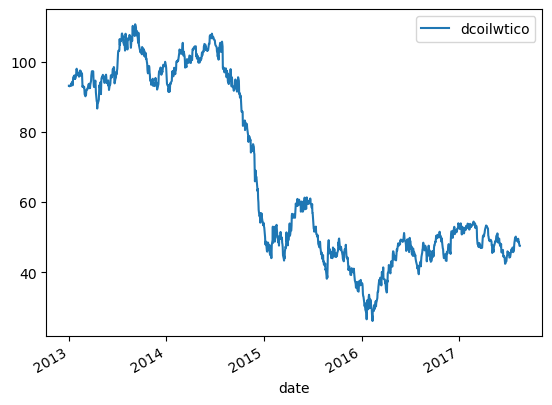

In [13]:
oil_df.set_index('date').plot()

In [14]:
X_train_test.shape

(3029400, 4)

In [15]:
X_train_test_merged = X_train_test.copy()
# X_train_test_merged = pd.merge(X_train_test, oil_df, how='left',on=['date'])

In [16]:
# train_df_merged  = pd.merge(train_df_merged,store_df,how='left',on=['store_nbr'] )
# test_df_merged  = pd.merge(test_df_merged,store_df,how='left',on=['store_nbr'] )

In [17]:
# use later on
holidays_events_df = pd.read_csv("holidays_events.csv",parse_dates=['date'])
holidays_events_df.rename(columns={'type':'holiday_type'})
holidays_events_df.loc[holidays_events_df[holidays_events_df.transferred==True].index, 'type'] = 'Work Day'
# train_df_merged =  pd.merge(train_df_merged,holidays_events_df,how='left',left_on=['date','city'], right_on=['date','locale_name'])

In [18]:
X_train_test_merged.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Index: 3029400 entries, 0 to 3029399
Data columns (total 4 columns):
 #   Column       Non-Null Count    Dtype         
---  ------       --------------    -----         
 0   date         3029400 non-null  datetime64[ns]
 1   store_nbr    3029400 non-null  int64         
 2   family       3029400 non-null  object        
 3   onpromotion  3029400 non-null  int64         
dtypes: datetime64[ns](1), int64(2), object(1)
memory usage: 115.6+ MB


# Time series Features

## trend

In [19]:
def get_trend(df, order, datecol='date'):
    res=df.copy()
    base_date = df[datecol].min()-pd.Timedelta(days=1)
    trend_1 = (df['date'] - base_date).dt.days
    for i in range(1, order+1):
        res[f'trend_{i}']= trend_1**i
    return res

In [20]:
get_trend(X_train_test_merged, 2, 'date')

,date,store_nbr,family,onpromotion,trend_1,trend_2
id,,,,,,
0,2013-01-01,1,AUTOMOTIVE,0,1,1
1,2013-01-01,1,BABY CARE,0,1,1
2,2013-01-01,1,BEAUTY,0,1,1
3,2013-01-01,1,BEVERAGES,0,1,1
4,2013-01-01,1,BOOKS,0,1,1
...,...,...,...,...,...,...
3029395,2017-08-31,9,POULTRY,1,1704,2903616
3029396,2017-08-31,9,PREPARED FOODS,0,1704,2903616
3029397,2017-08-31,9,PRODUCE,1,1704,2903616


In [21]:
base_date = X_train_test_merged['date'].min()-pd.Timedelta(days=1)
X_train_test_merged['trend'] = (X_train_test_merged['date'] - base_date).dt.days
X_train_test_merged['trend_sq'] = X_train_test_merged['trend']**2
X_train_test_merged

,date,store_nbr,family,onpromotion,trend,trend_sq
id,,,,,,
0,2013-01-01,1,AUTOMOTIVE,0,1,1
1,2013-01-01,1,BABY CARE,0,1,1
2,2013-01-01,1,BEAUTY,0,1,1
3,2013-01-01,1,BEVERAGES,0,1,1
4,2013-01-01,1,BOOKS,0,1,1
...,...,...,...,...,...,...
3029395,2017-08-31,9,POULTRY,1,1704,2903616
3029396,2017-08-31,9,PREPARED FOODS,0,1704,2903616
3029397,2017-08-31,9,PRODUCE,1,1704,2903616


In [22]:
len(X_train_test_merged.family.unique())

33

## seasonality

In [23]:
def get_seasonality_columns(df, date_col='date'):
    df[date_col] = df[date_col].astype('datetime64[ns]')
    # df['month'] =  df[date_col].dt.month
    df['dayofweek'] = df[date_col].dt.dayofweek
    df['day'] = df[date_col].dt.day
    df['year'] = df[date_col].dt.year
    year_week_day_iso  = df[date_col].dt.isocalendar().rename(columns={'day':'dayofweek_iso', 'year':'year_iso', 'week':'weekofyear_iso'})
    df = pd.concat([df, year_week_day_iso], axis=1)
    return df

In [24]:
X_train_test_merged = get_seasonality_columns(X_train_test_merged)

In [25]:
X_train_test_merged

,date,store_nbr,family,onpromotion,trend,trend_sq,dayofweek,day,year,year_iso,weekofyear_iso,dayofweek_iso
id,,,,,,,,,,,,
0,2013-01-01,1,AUTOMOTIVE,0,1,1,1,1,2013,2013,1,2
1,2013-01-01,1,BABY CARE,0,1,1,1,1,2013,2013,1,2
2,2013-01-01,1,BEAUTY,0,1,1,1,1,2013,2013,1,2
3,2013-01-01,1,BEVERAGES,0,1,1,1,1,2013,2013,1,2
4,2013-01-01,1,BOOKS,0,1,1,1,1,2013,2013,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...
3029395,2017-08-31,9,POULTRY,1,1704,2903616,3,31,2017,2017,35,4
3029396,2017-08-31,9,PREPARED FOODS,0,1704,2903616,3,31,2017,2017,35,4
3029397,2017-08-31,9,PRODUCE,1,1704,2903616,3,31,2017,2017,35,4


In [26]:
def plot_seasonality(df, target, datapoint='dayofweek', same_color='week', ax=None, title='', iso=True):
    if not ax:
        _, ax = plt.subplots()
    palette = sns.color_palette("husl", n_colors=df[same_color].nunique())
    ax = sns.lineplot(
        x=datapoint,
        y=target,
        hue=same_color,
        data=df,
        ci=False,
        ax=ax,
        palette=palette,
        legend=False,
    )
    ax.set_title(f"{title} Seasonal Plot ({same_color}/{datapoint})")
    # labels
    for line, name in zip(ax.lines, df[same_color].unique()):
        y_ = line.get_ydata()[-1]
        ax.annotate(
            name,
            xy=(1, y_),
            xytext=(6, 0),
            color=line.get_color(),
            xycoords=ax.get_yaxis_transform(),
            textcoords="offset points",
            size=14,
            va="center",
        )
    return ax

In [28]:
# extract train df
train_df_merged = pd.merge(X_train_test_merged.loc[train_df_index], y_train, left_index=True, right_index=True)
# plot target seasonality
seas_by_family = train_df_merged.groupby(['family', 'year_iso', 'weekofyear_iso']).sales.mean().reset_index()

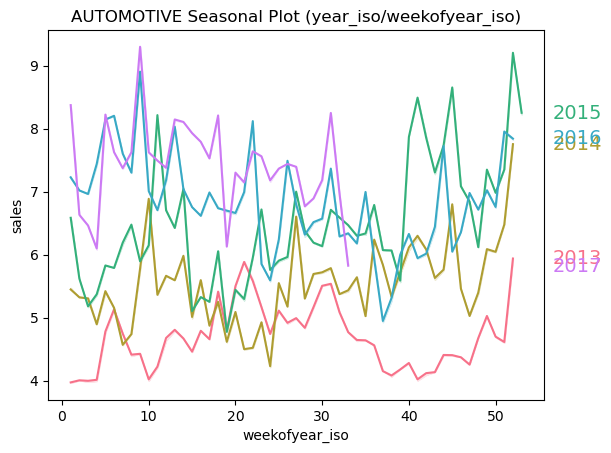

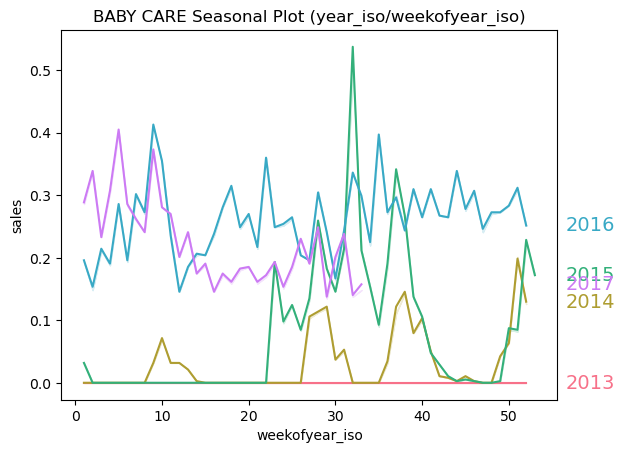

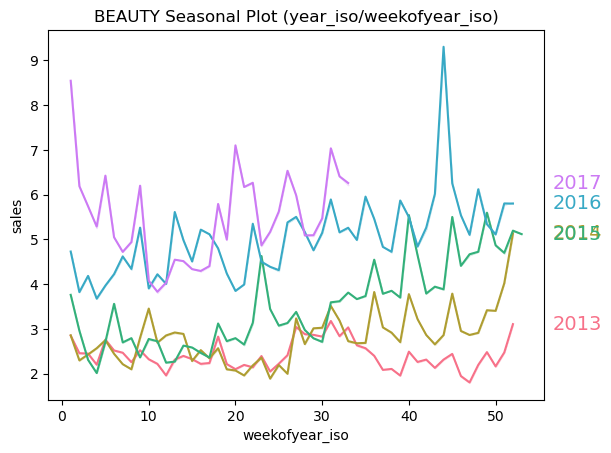

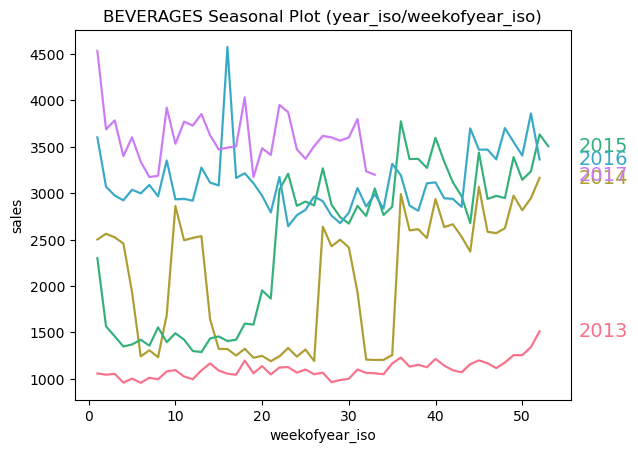

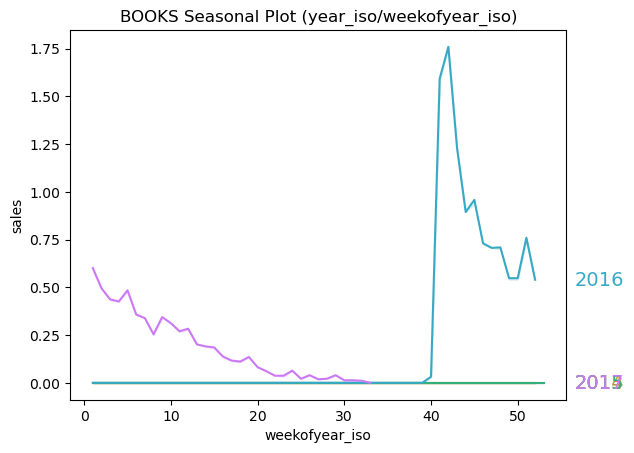

...

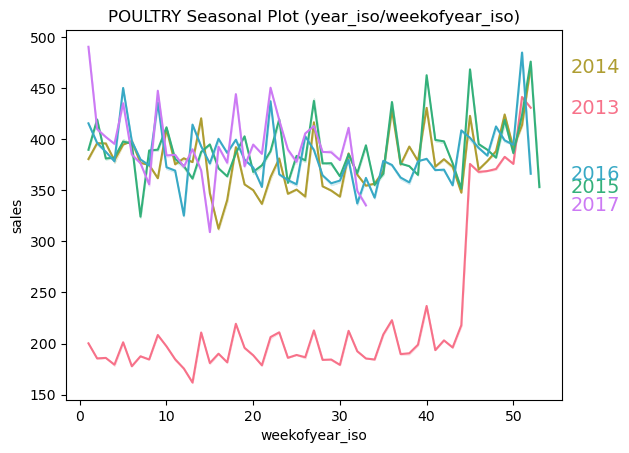

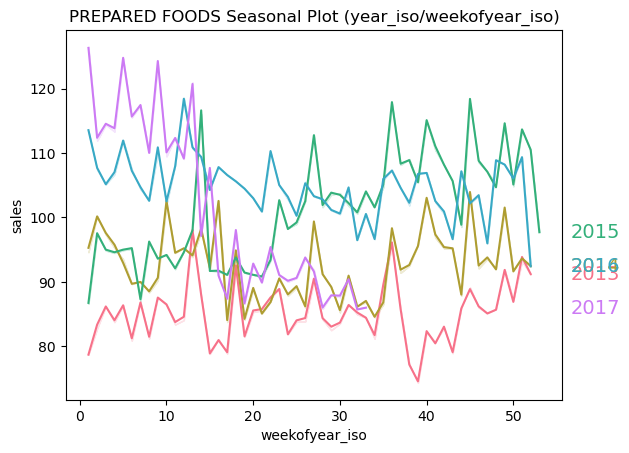

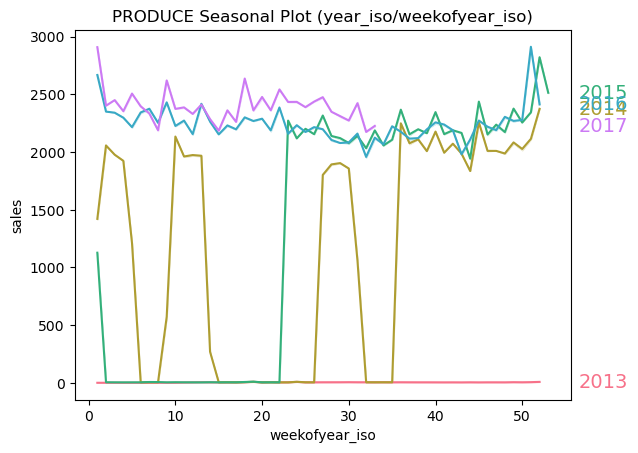

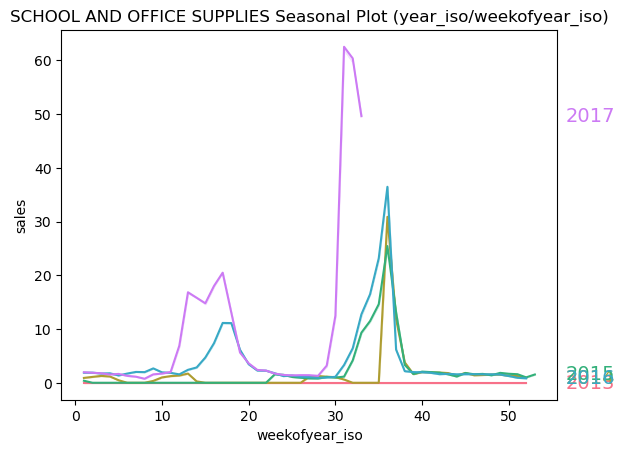

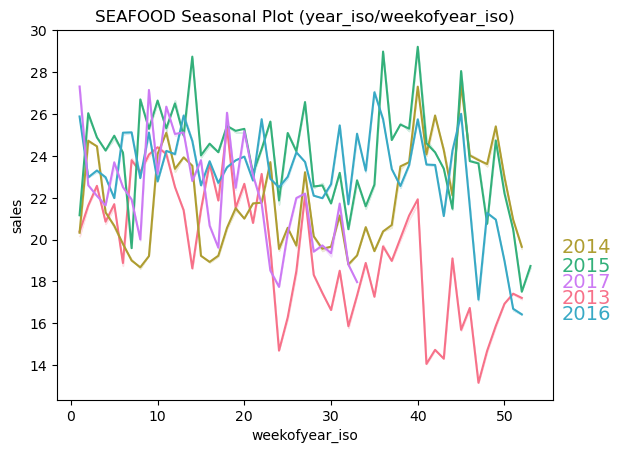

In [29]:
# extract train df
train_df_merged = pd.merge(X_train_test_merged.loc[train_df_index], y_train, left_index=True, right_index=True)
# plot target seasonality
seas_by_family = train_df_merged.groupby(['family', 'year_iso', 'weekofyear_iso']).sales.mean().reset_index()
for family in seas_by_family.family.unique():
    tmp = train_df_merged[train_df_merged['family']==family]
    plot_seasonality(tmp, 'sales',datapoint = 'weekofyear_iso' ,same_color='year_iso', ax=None, title=family)
    plt.show()

## lags

In [30]:
#the target should be unique with columns groupby + timecol
def create_lags(df, target, groupby, timecol='date', numlag=2): 
    if numlag<1:
        return df
    df = df.set_index(groupby+[timecol]).sort_index()
    reindexed_df= df.groupby(groupby)[target]
    lags = [reindexed_df.shift(0)] + [reindexed_df.shift(i).rename(f'lag_{i}') for i in range(1, numlag+1)]
    return pd.concat(lags, axis=1)
        

In [31]:
def create_lags_nogroup(df, target, timecol='date', numlag=2):
    if numlag<1:
        return df
    df = df.set_index(timecol).sort_index()
    reindexed_df= df[target]
    lags = [reindexed_df.shift(0)] + [reindexed_df.shift(i).rename(f'lag_{i}') for i in range(1, numlag+1)]
    return pd.concat(lags, axis=1)

In [32]:
train_df = pd.concat([X_train_test_merged.loc[train_df_index],y_train], axis=1)

In [33]:
lags = create_lags(train_df, 'sales', ['store_nbr', 'family'], timecol='date', numlag=3).reset_index()

In [34]:
lags = lags.dropna()# test set does not have it

In [35]:
lags

,store_nbr,family,date,sales,lag_1,lag_2,lag_3
3,1,AUTOMOTIVE,2013-01-04,3.0,3.0,2.0,0.0
4,1,AUTOMOTIVE,2013-01-05,5.0,3.0,3.0,2.0
5,1,AUTOMOTIVE,2013-01-06,2.0,5.0,3.0,3.0
6,1,AUTOMOTIVE,2013-01-07,0.0,2.0,5.0,3.0
7,1,AUTOMOTIVE,2013-01-08,2.0,0.0,2.0,5.0
...,...,...,...,...,...,...,...
3000883,54,SEAFOOD,2017-08-11,0.0,2.0,4.0,12.0
3000884,54,SEAFOOD,2017-08-12,1.0,0.0,2.0,4.0
3000885,54,SEAFOOD,2017-08-13,2.0,1.0,0.0,2.0
3000886,54,SEAFOOD,2017-08-14,0.0,2.0,1.0,0.0


In [36]:
lags[['sales', 'lag_1','lag_2', 'lag_3']].corr()['sales'].sort_values(ascending=False)

sales    1.000000
lag_1    0.919234
lag_2    0.879548
lag_3    0.872230
Name: sales, dtype: float64

In [37]:
# what about mean of each cat
mean_of_cat = train_df.groupby( ['store_nbr', 'family'])['sales'].mean().reset_index().rename(columns={'sales':'mean'})
mean_of_cat_merged = pd.merge(train_df[['store_nbr', 'family', 'sales']], mean_of_cat, how='left', on=['store_nbr', 'family'])

In [38]:
mean_of_cat_merged[['sales','mean']].corr()

,sales,mean
sales,1.000000,0.872583
mean,0.872583,1.000000


In [39]:
import math
def lagplot(x, y=None, lag=1, standardize=False, ax=None):
    x_ = x.shift(lag)
    if standardize:
        x_ = (x_ - x_.mean()) / x_.std()
    if y is not None:
        y_ = (y - y.mean()) / y.std() if standardize else y
    else:
        y_ = x
    corr = y_.corr(x_)
    if ax is None:
        fig, ax = plt.subplots()
    scatter_kws = dict(
        alpha=0.75,
        s=3,
    )
    line_kws = dict(color='C3', alpha=0.75, linewidth= 1)
    ax = sns.regplot(x=x_,
                     y=y_,
                     scatter_kws=scatter_kws,
                     line_kws=line_kws,
                     lowess=True,
                     ax=ax)

    ax.set(title=f"Lag {lag}", xlabel=x_.name, ylabel=y_.name)
    return ax

# x,y: pd.Series
def plot_lags(x, y=None, lags=6, nrows=1):
    ncols =math.ceil(lags / nrows)
    fig, axs = plt.subplots(sharex=True, sharey=True, squeeze=False, nrows=nrows, ncols=ncols, figsize=(ncols*2, nrows*2) )
    for ax, k in zip(fig.get_axes(), range(nrows* ncols)):
        if k + 1 <= lags:
            ax = lagplot(x, y, lag=k + 1, ax=ax)
            ax.set_title(f"Lag {k + 1}")
            ax.set(xlabel="", ylabel="")
        else:
            ax.axis('off')
    plt.setp(axs[-1, :], xlabel=x.name)
    plt.setp(axs[:, 0], ylabel=y.name if y is not None else x.name)
    fig.tight_layout(w_pad=0.1, h_pad=0.1)
    return fig


In [40]:
train_df.columns

Index(['date', 'store_nbr', 'family', 'onpromotion', 'trend', 'trend_sq',
       'dayofweek', 'day', 'year', 'year_iso', 'weekofyear_iso',
       'dayofweek_iso', 'sales'],
      dtype='object')

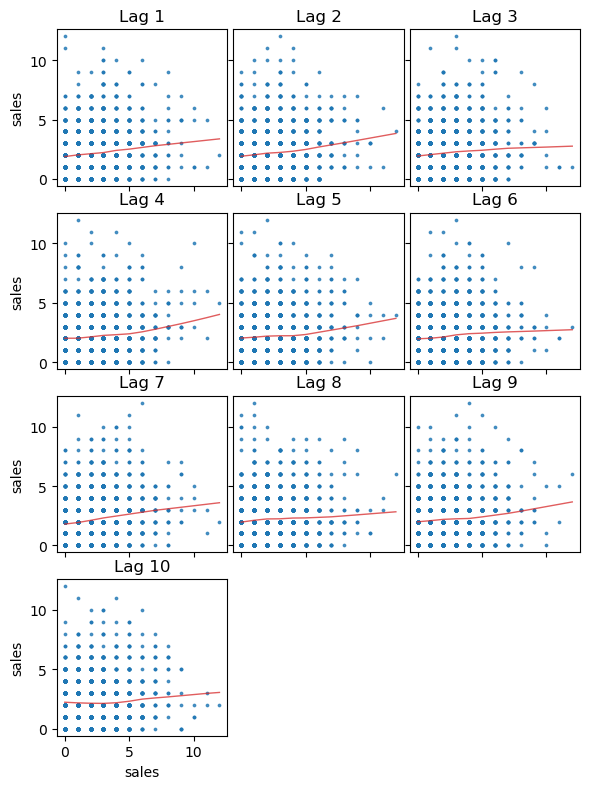

In [41]:
fig = plot_lags(train_df[(train_df.family=='BEAUTY') &(train_df.store_nbr==1)].sales,lags=10, nrows=4)

# Pred

## Train Test Split

In [42]:
X_train_all = X_train_test_merged.loc[train_df_index]
y_train_all = y_train

In [43]:
X_train_all.date.describe()

count                          3000888
mean     2015-04-24 08:27:04.703088384
min                2013-01-01 00:00:00
25%                2014-02-26 18:00:00
50%                2015-04-24 12:00:00
75%                2016-06-19 06:00:00
max                2017-08-15 00:00:00
Name: date, dtype: object

In [44]:
test_size = test_df.date.describe().loc['max'] - test_df.date.describe().loc['min']
print(test_size)
seperation_pt= train_df.date.describe().loc['max'] - test_size
train_idxes = X_train_all[X_train_all.date<seperation_pt].index
test_idxes = X_train_all[X_train_all.date>=seperation_pt].index

X_train = X_train_all.loc[train_idxes]
X_test = X_train_all.loc[test_idxes]
y_train = y_train_all.loc[train_idxes]
y_test = y_train_all.loc[test_idxes]

15 days 00:00:00


In [45]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((2972376, 12), (28512, 12), (2972376, 1), (28512, 1))

In [46]:
X_test_real= X_train_test_merged.loc[test_df_index]
X_test_real.shape

(28512, 12)

## Encoding

just use one store and family as an example...

In [47]:
store_1_train_idx = X_train[X_train.store_nbr==1].index
store_1_test_idx = X_test[X_test.store_nbr==1].index

X_train_1 = X_train.loc[store_1_train_idx].drop(columns=['date'])
X_test_1 = X_test.loc[store_1_test_idx].drop(columns=['date'])
y_train_1 = y_train.loc[store_1_train_idx]
y_test_1 = y_test.loc[store_1_test_idx]
X_test_real_1 = X_test_real.loc[X_test_real.store_nbr==1].drop(columns=['date'])

In [48]:
from sklearn.preprocessing import OneHotEncoder

def OHE(X_train_1, X_test_1, X_test_real_1, cat_columns = ['family']):
    OH = OneHotEncoder(sparse_output=False, handle_unknown='ignore',drop = 'first')
    X_train_1_oh = pd.DataFrame(OH.fit_transform(X_train_1[cat_columns]), 
                            columns=OH.get_feature_names_out(cat_columns), index=X_train_1.index)
    X_train_1 =pd.concat([X_train_1.drop(columns=cat_columns),X_train_1_oh], axis=1)

    X_test_1_oh = pd.DataFrame(OH.transform(X_test_1[cat_columns]), 
                            columns=OH.get_feature_names_out(cat_columns), index=X_test_1.index)
    X_test_1 = pd.concat([X_test_1.drop(columns=cat_columns), X_test_1_oh], axis=1)

    X_test_real_1_oh = pd.DataFrame(OH.transform(X_test_real_1[cat_columns]), 
                            columns=OH.get_feature_names_out(cat_columns), index=X_test_real_1.index)
    X_test_real_1 = pd.concat([X_test_real_1.drop(columns=cat_columns), X_test_real_1_oh], axis=1)
    return X_train_1, X_test_1, X_test_real_1

In [49]:
X_train_1, X_test_1, X_test_real_1 = OHE(X_train_1, X_test_1, X_test_real_1)

In [50]:
X_train_1.shape

(55044, 42)

In [51]:
X_test_real.shape

(28512, 12)

In [52]:
X_test_real[X_test_real.isna().any(axis=1)]

,date,store_nbr,family,onpromotion,trend,trend_sq,dayofweek,day,year,year_iso,weekofyear_iso,dayofweek_iso
id,,,,,,,,,,,,


## Linear Regression

In [53]:
# from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
# def performance(y_test, y_pred):
#     # Calcul des métriques de performance
#     r2 = r2_score(y_test, y_pred)  # R² (proportion de variance expliquée)
#     rmse = np.sqrt(mean_squared_error(y_test, y_pred))  # Erreur quadratique moyenne
#     mae = mean_absolute_error(y_test, y_pred)  # Erreur absolue moyenne

#     print(f'\nR² Score: {r2:.2f}')
#     print(f'RMSE: {rmse:.2f}')
#     print(f'MAE: {mae:.2f}')
#     return r2,rmse,mae
# def performance_both(y_train, y_train_pred, y_test, y_pred):
#     print('\ntraining performance')
#     r2_train,rmse_train,mae_train = performance(y_train, y_train_pred)
#     print('\ntest performance')
#     r2_test,rmse_test,mae_test = performance(y_test, y_pred)
#     return (r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test)

In [54]:
from utils_models import performance, performance_both
from utils_models import lr

ModuleNotFoundError: No module named 'utils_models'

In [ ]:
# Linear Regression
from sklearn.linear_model import LinearRegression
def lr(X_train_1, X_test_1, y_train_1, y_test_1, X_test_real_1):
    linear_all = LinearRegression(fit_intercept=True).fit(X_train_1, y_train_1)
    y_pred_train_linear = linear_all.predict(X_train_1)
    y_pred_linear = linear_all.predict(X_test_1)
    y_pred_test_real = linear_all.predict(X_test_real_1)
    (r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train_1, y_pred_train_linear, y_test_1, y_pred_linear)
    plt.figure(figsize=(5,3))
    plt.scatter(y_pred_linear,y_test_1- y_pred_linear)
    plt.xlabel('y')
    plt.ylabel('resid')
    y_fit_train = pd.DataFrame(y_pred_train_linear, index=X_train_1.index)
    y_pred_test = pd.DataFrame(y_pred_linear, index=X_test_1.index)
    y_pred_test_real =  pd.DataFrame(y_pred_test_real, index=X_test_real_1.index)
    return y_fit_train, y_pred_test, y_pred_test_real


In [ ]:

import traceback
def apply_func_each_store(X_train, X_test,y_train,y_test, X_test_real, func=lr):

    y_fits, y_preds, y_trains, y_tests = [],[],[],[]
    y_test_reals=[]


    for num in X_train.store_nbr.unique():

        store_1_train_idx = X_train[X_train.store_nbr==num].index
        store_1_test_idx = X_test[X_test.store_nbr==num].index

        X_train_1 = X_train.loc[store_1_train_idx].drop(columns=['date'])
        X_test_1 = X_test.loc[store_1_test_idx].drop(columns=['date'])
        y_train_1 = y_train.loc[store_1_train_idx]
        y_test_1 = y_test.loc[store_1_test_idx]
        X_test_real_1 = X_test_real[X_test_real.store_nbr==num].drop(columns=['date'])
        X_train_1, X_test_1,X_test_real_1 = OHE(X_train_1, X_test_1,X_test_real_1)

        y_fit_train, y_pred_test,y_pred_test_real = func(X_train_1, X_test_1, y_train_1, y_test_1, X_test_real_1)
        if y_fit_train.shape!=y_train_1.shape or y_pred_test.shape!=y_test_1.shape:
            print(num,y_fit_train.shape, y_pred_test.shape, y_train_1.shape, y_test_1.shape)
        y_fits.append(y_fit_train)
        y_preds.append(y_pred_test)
        y_trains.append(y_train_1)
        y_tests.append(y_test_1)
        y_test_reals.append(y_pred_test_real)
    try:
        y_fit_all = pd.concat(y_fits, axis=0).reindex(y_train.index)
        y_pred_all = pd.concat(y_preds, axis=0).reindex(y_test.index)
        y_test_reals_all = pd.concat(y_test_reals, axis=0).reindex(X_test_real.index)
        (r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train, y_fit_all, y_test, y_pred_all)
    except:
        print(traceback.format_exc())
        return y_fits,y_preds
    return y_fit_all,y_pred_all,y_test_reals_all



training performance

R² Score: 0.81
RMSE: 263.02
MAE: 113.86

test performance

R² Score: 0.88
RMSE: 226.74
MAE: 105.95

training performance

R² Score: 0.90
RMSE: 151.27
MAE: 59.69

test performance

R² Score: 0.93
RMSE: 152.80
MAE: 60.71

training performance

R² Score: 0.90
RMSE: 434.83
MAE: 180.97

test performance

R² Score: 0.94
RMSE: 400.59
MAE: 194.74

training performance

R² Score: 0.87
RMSE: 191.24
MAE: 70.06

test performance

R² Score: 0.92
RMSE: 163.78
MAE: 68.68

training performance

R² Score: 0.87
RMSE: 197.17
MAE: 71.54

test performance

R² Score: 0.91
RMSE: 177.37
MAE: 60.65

training performance

R² Score: 0.86
RMSE: 198.81
MAE: 77.15

test performance

R² Score: 0.85
RMSE: 254.29
MAE: 103.22

training performance

R² Score: 0.91
RMSE: 163.11
MAE: 67.27

test performance

R² Score: 0.95
RMSE: 132.96
MAE: 65.59

training performance

R² Score: 0.85
RMSE: 205.75
MAE: 79.44

test performance

R² Score: 0.89
RMSE: 159.15
MAE: 67.20

training performance

R² Score: 0.

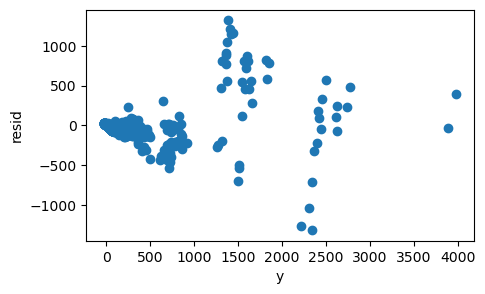

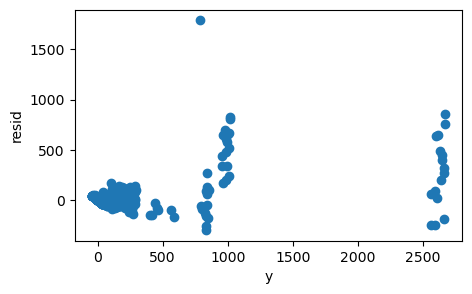

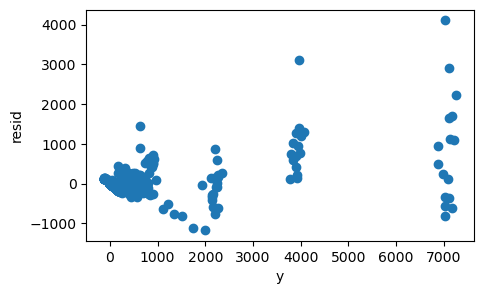

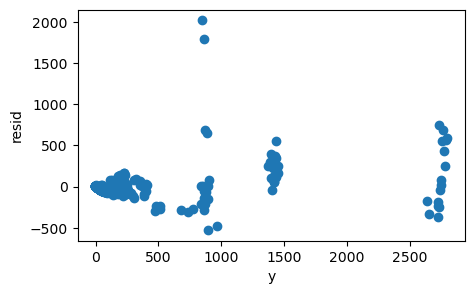

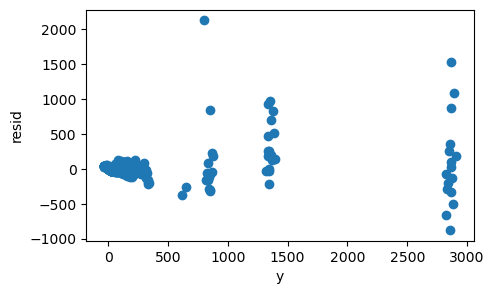

...

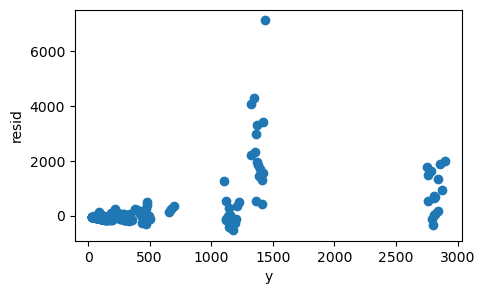

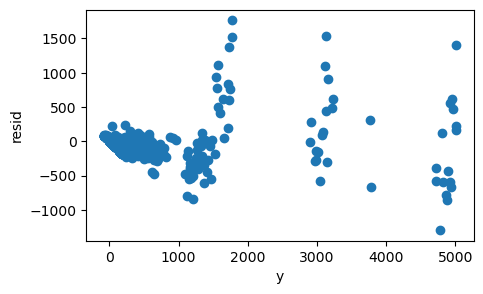

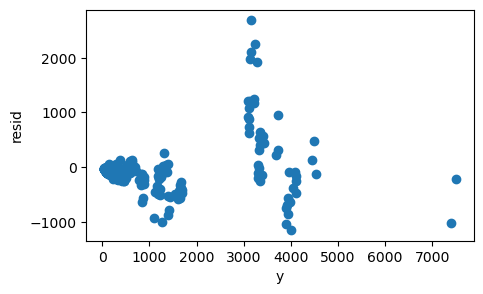

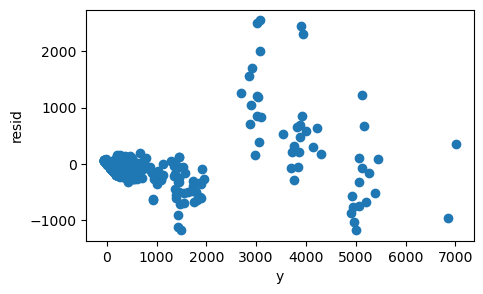

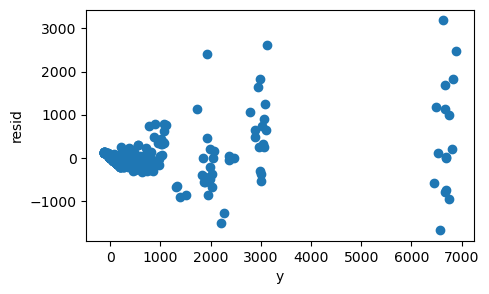

In [ ]:
y_fit_all,y_pred_all,y_test_reals_all=  apply_func_each_store(X_train, X_test,y_train,y_test, X_test_real, func=lr)

In [ ]:
(r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train, y_fit_all, y_test, y_pred_all)


training performance

R² Score: 0.80
RMSE: 490.87
MAE: 171.53

test performance

R² Score: 0.88
RMSE: 435.63
MAE: 182.23


In [ ]:
y_test_reals_all

,0
id,
3000888,38.847418
3000889,35.716542
3000890,61.340903
3000891,1750.846961
3000892,35.842442
...,...
3029395,447.416475
3029396,54.533599
3029397,823.138315


no seperation between families


training performance

R² Score: 0.54
RMSE: 747.27
MAE: 264.97

test performance

R² Score: 0.65
RMSE: 734.11
MAE: 269.36


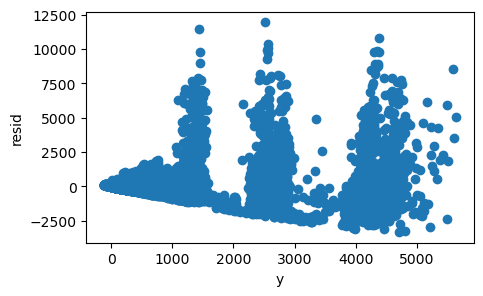

In [ ]:
X_train_all, X_test_all,X_test_real_all = OHE(X_train.drop(columns=['date']), X_test.drop(columns=['date']), X_test_real.drop(columns=['date']))
y_fit_train, y_pred_test,y_pred_test_real = lr(X_train_all, X_test_all, y_train, y_test, X_test_real_all)

## Decision Tree Regressor

In [ ]:
def plot_pred_vs_actual(y_pred, y_actual):
    plt.scatter(y_pred, y_actual)
    xrange = np.linspace(min(y_actual), max(y_actual), 1000)
    plt.plot(xrange, xrange, color='red', linestyle='--', label='45° Line (y = x)')
    plt.xlabel('pred')
    plt.ylabel('actual')

In [ ]:
y_train_1:pd.DataFrame

,sales
id,
0,0.000
1,0.000
2,0.000
3,0.000
4,0.000
...,...
2970622,113.468
2970623,55.484
2970624,1178.718


In [ ]:
from sklearn.tree import DecisionTreeRegressor
# all columns 
def dtree(X_train_1:pd.DataFrame, X_test_1:pd.DataFrame, y_train_1:pd.DataFrame, y_test_1:pd.DataFrame,X_test_real_1:pd.DataFrame):
    dtree_all = DecisionTreeRegressor(max_depth=5).fit(X_train_1, y_train_1)
    y_pred_all = dtree_all.predict(X_test_1)
    y_pred_all_train = dtree_all.predict(X_train_1)
    (r2_train,rmse_train,mae_train), (r2_test,rmse_test,mae_test) = performance_both(y_train_1, y_pred_all_train, y_test_1, y_pred_all)

    y_fit_train = pd.DataFrame(y_pred_all_train, index=X_train_1.index)
    y_pred_test = pd.DataFrame(y_pred_all, index=X_test_1.index)
    plot_pred_vs_actual(y_pred_all_train, y_train_1.iloc[:,0])

    dtree_importance = pd.DataFrame(dtree_all.feature_importances_, 
                                    index=X_train_1.columns, 
                                    columns=['importance']).sort_values('importance', ascending=False)
    plt.figure(figsize=(12, 6))
    plt.title("Decision Tree Feature Importances")
    plt.barh(dtree_importance.index[:30], dtree_importance['importance'][:30])
    plt.gca().invert_yaxis()
    plt.show()
    y_pred_test_real = dtree_all.predict(X_test_real_1)
    y_pred_test_real =  pd.DataFrame(y_pred_test_real, index=X_test_real_1.index)
    return y_fit_train, y_pred_test, y_pred_test_real



training performance

R² Score: 0.88
RMSE: 206.42
MAE: 110.74

test performance

R² Score: 0.92
RMSE: 190.36
MAE: 106.93


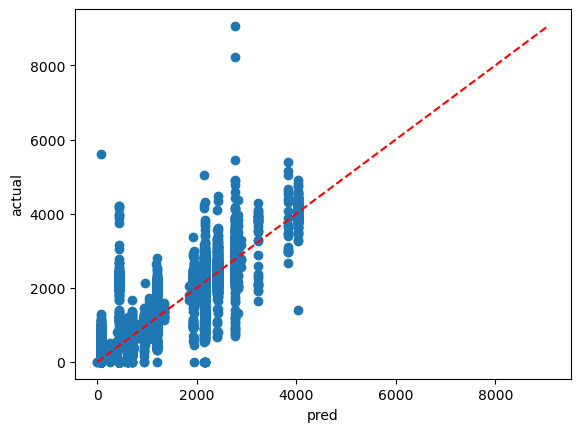

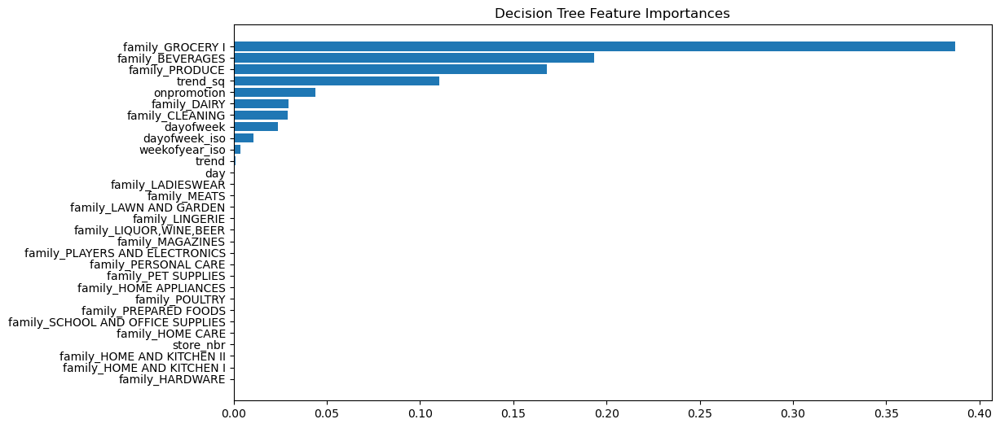


training performance

R² Score: 0.93
RMSE: 123.74
MAE: 67.15

test performance

R² Score: 0.92
RMSE: 163.63
MAE: 84.63


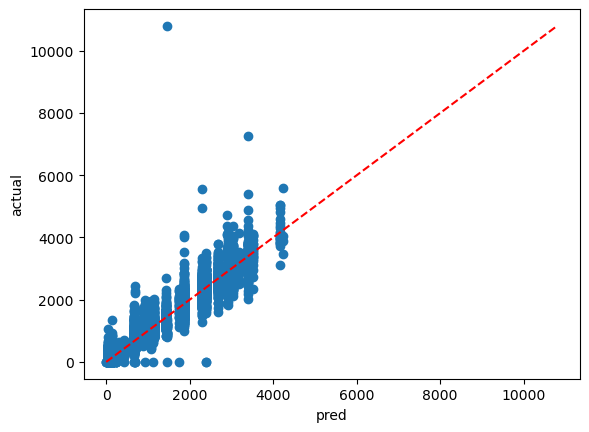

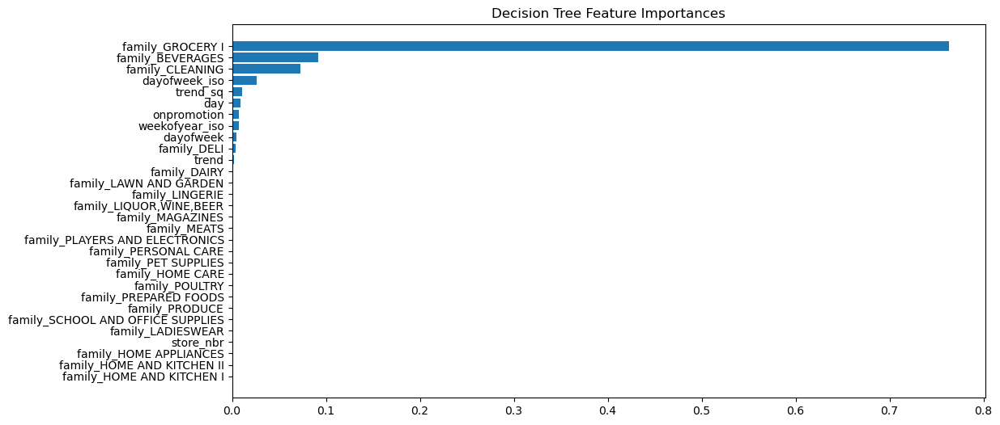


training performance

R² Score: 0.94
RMSE: 345.57
MAE: 191.25

test performance

R² Score: 0.95
RMSE: 372.02
MAE: 188.37


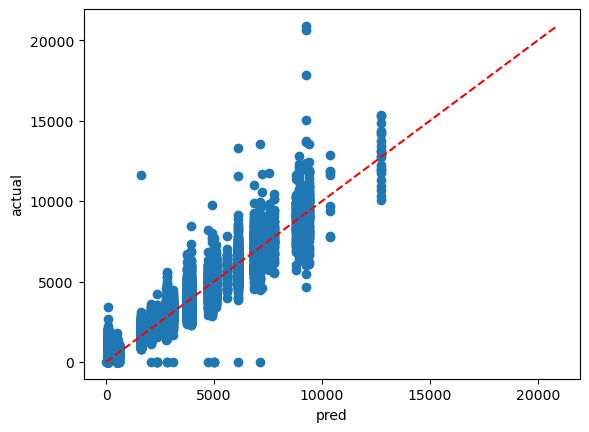

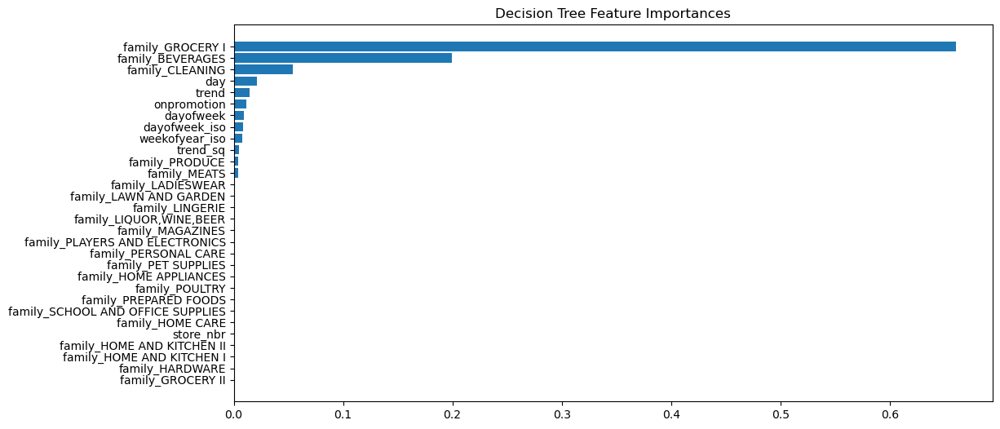


training performance

R² Score: 0.92
RMSE: 150.66
MAE: 73.81

test performance

R² Score: 0.50
RMSE: 420.75
MAE: 128.81


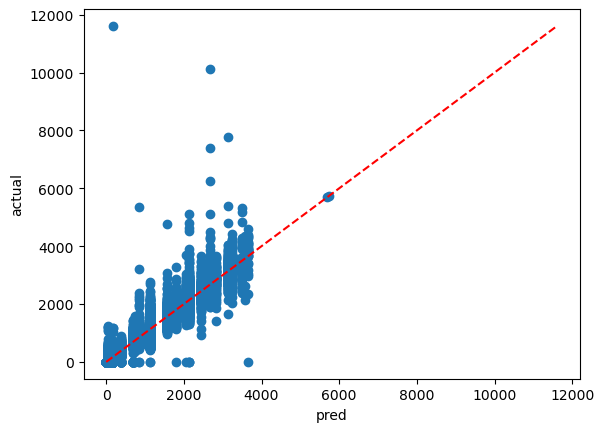

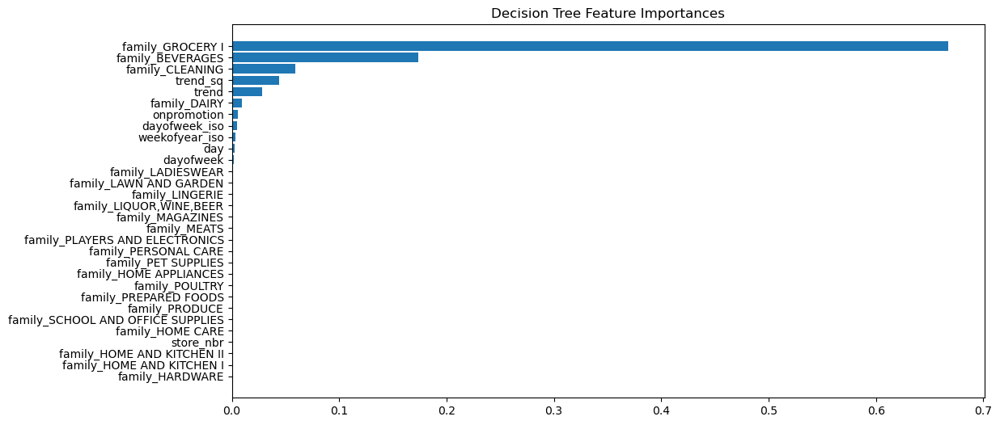


training performance

R² Score: 0.92
RMSE: 155.89
MAE: 69.37

test performance

R² Score: 0.91
RMSE: 178.90
MAE: 67.62


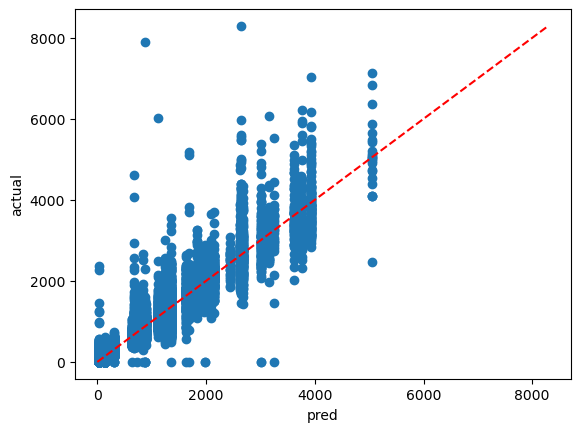

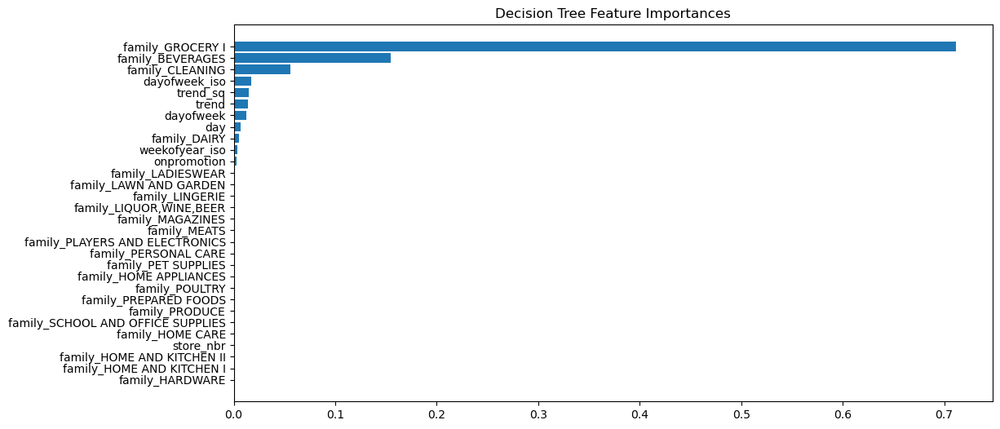


training performance

R² Score: 0.89
RMSE: 175.48
MAE: 89.26

test performance

R² Score: 0.65
RMSE: 391.39
MAE: 136.44


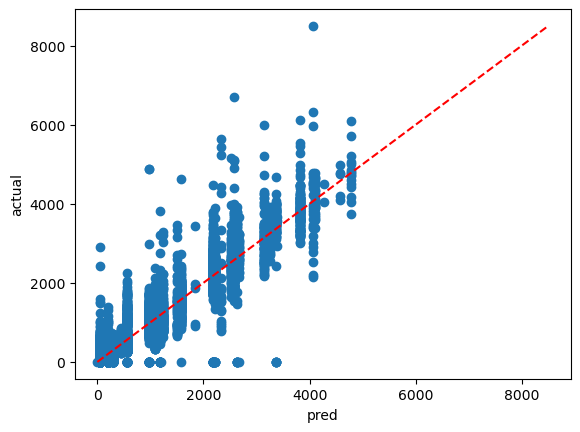

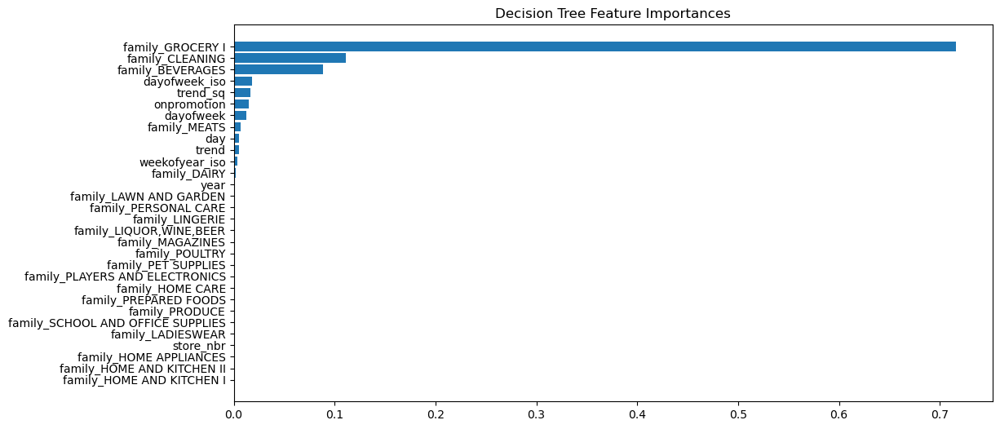


training performance

R² Score: 0.93
RMSE: 148.43
MAE: 79.59

test performance

R² Score: 0.95
RMSE: 125.41
MAE: 80.89


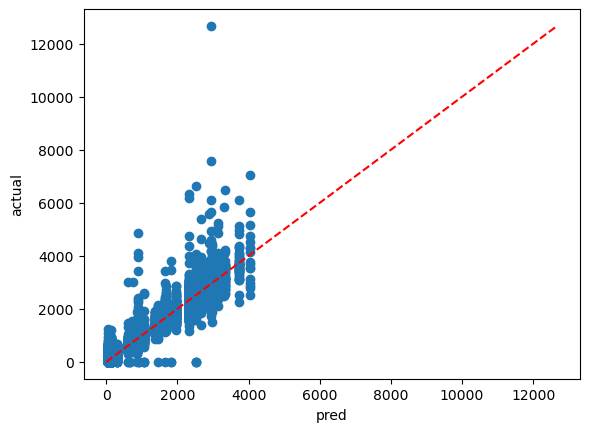

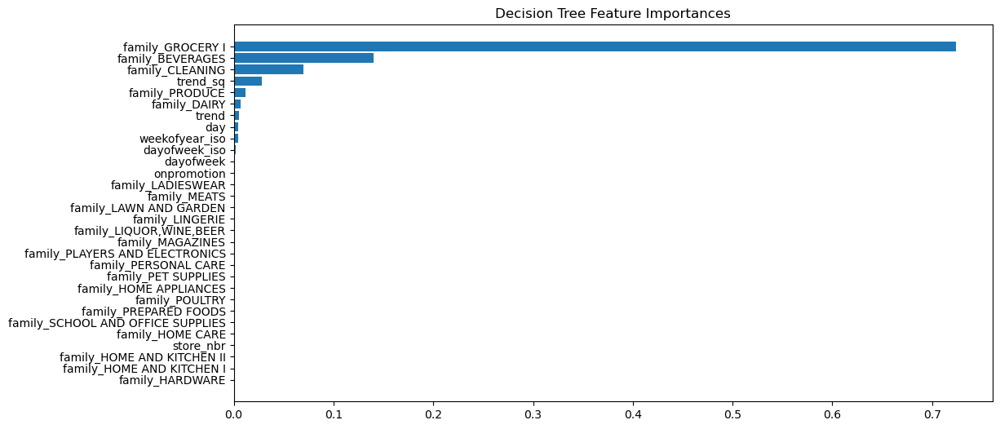


training performance

R² Score: 0.90
RMSE: 168.43
MAE: 85.50

test performance

R² Score: 0.90
RMSE: 148.91
MAE: 78.67


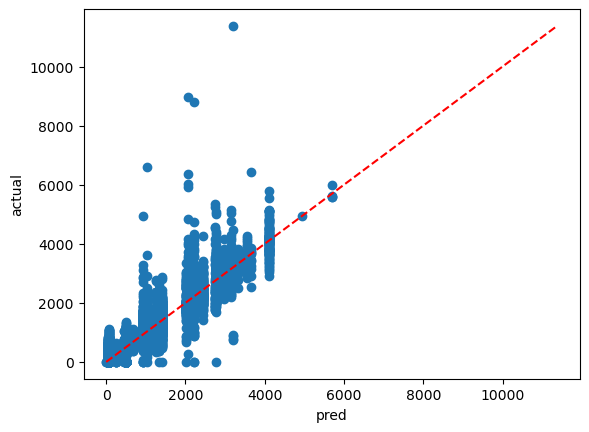

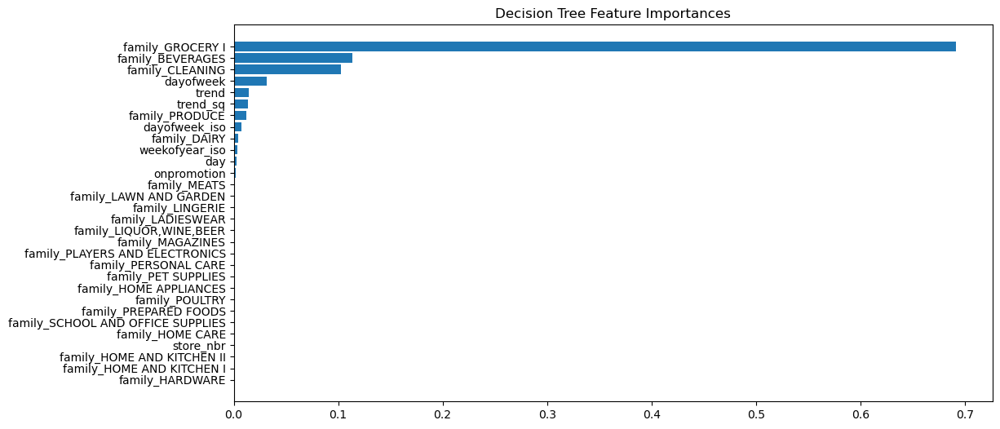


training performance

R² Score: 0.92
RMSE: 234.63
MAE: 134.01

test performance

R² Score: 0.94
RMSE: 231.67
MAE: 145.04


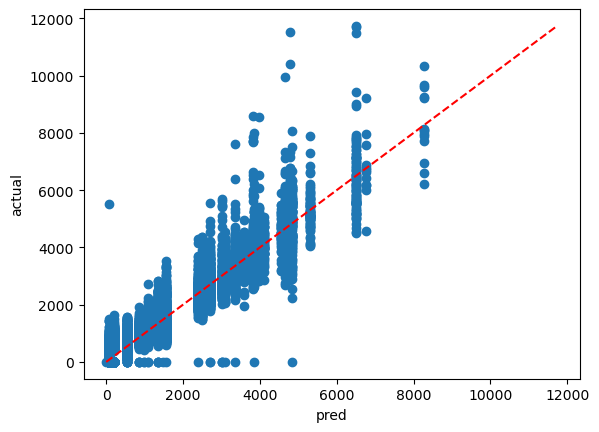

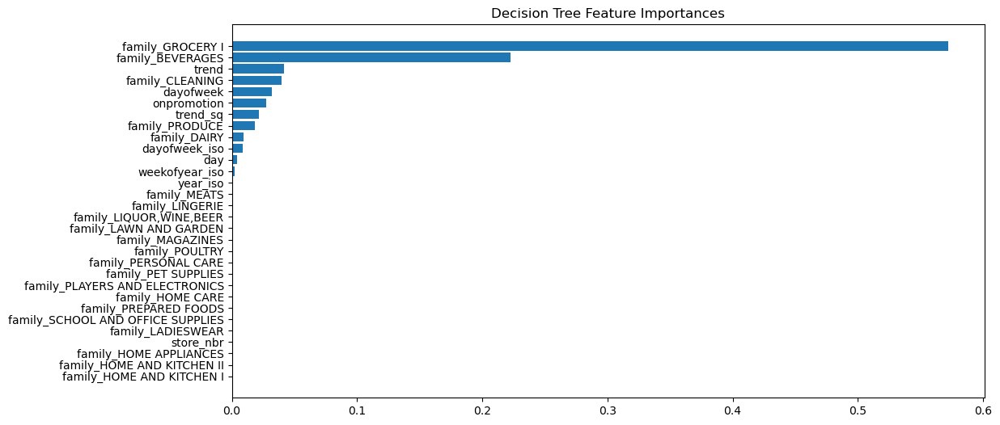


training performance

R² Score: 0.84
RMSE: 244.72
MAE: 116.24

test performance

R² Score: 0.91
RMSE: 210.59
MAE: 112.31


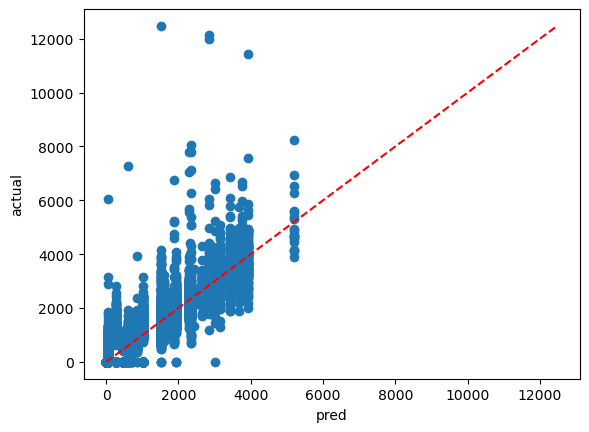

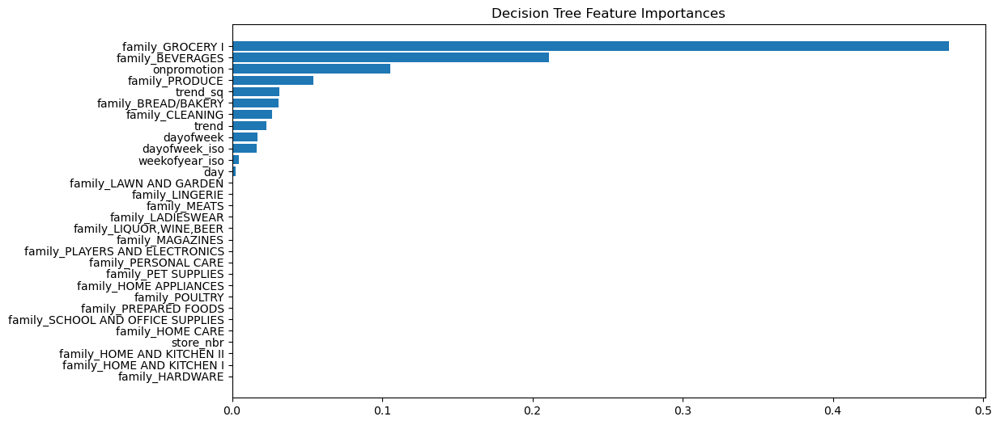


training performance

R² Score: 0.94
RMSE: 164.72
MAE: 84.26

test performance

R² Score: 0.97
RMSE: 138.11
MAE: 75.64


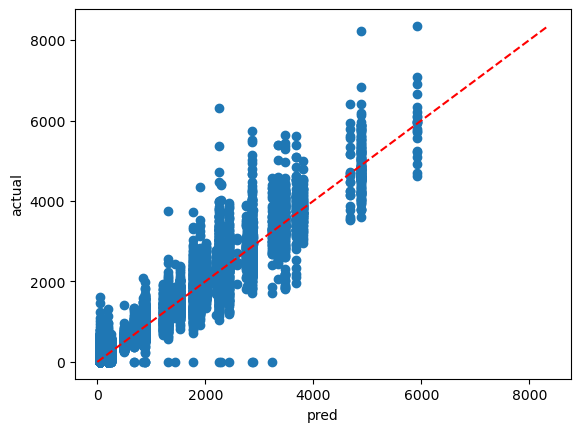

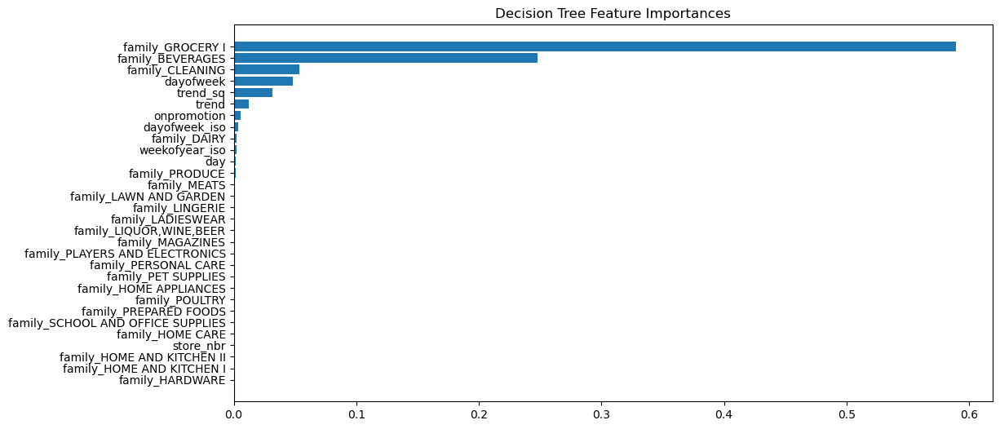


training performance

R² Score: 0.71
RMSE: 585.27
MAE: 174.21

test performance

R² Score: 0.90
RMSE: 277.21
MAE: 169.13


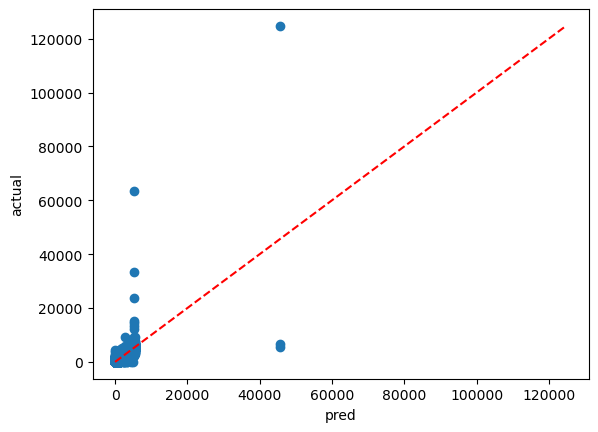

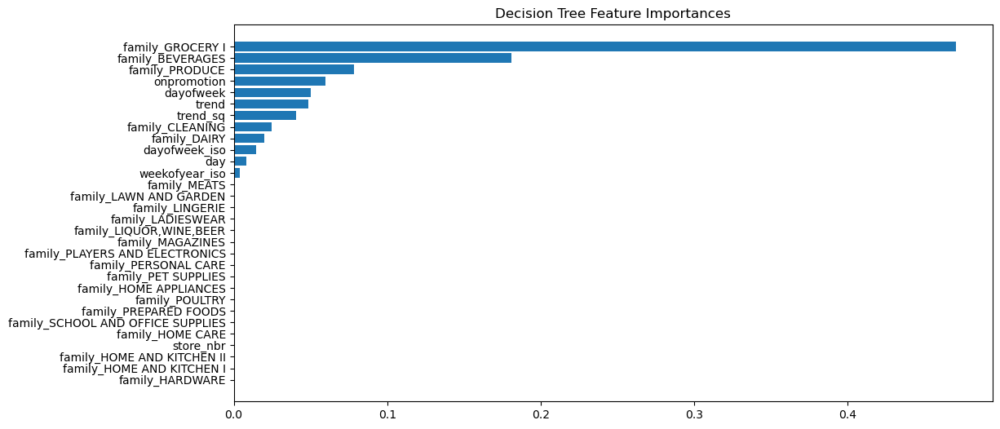


training performance

R² Score: 0.72
RMSE: 506.52
MAE: 117.34

test performance

R² Score: 0.89
RMSE: 465.91
MAE: 236.14


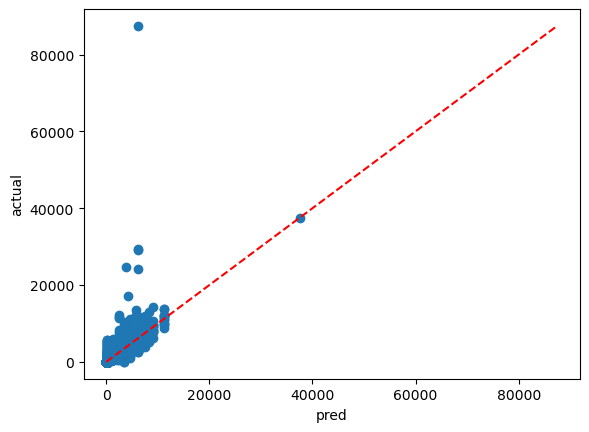

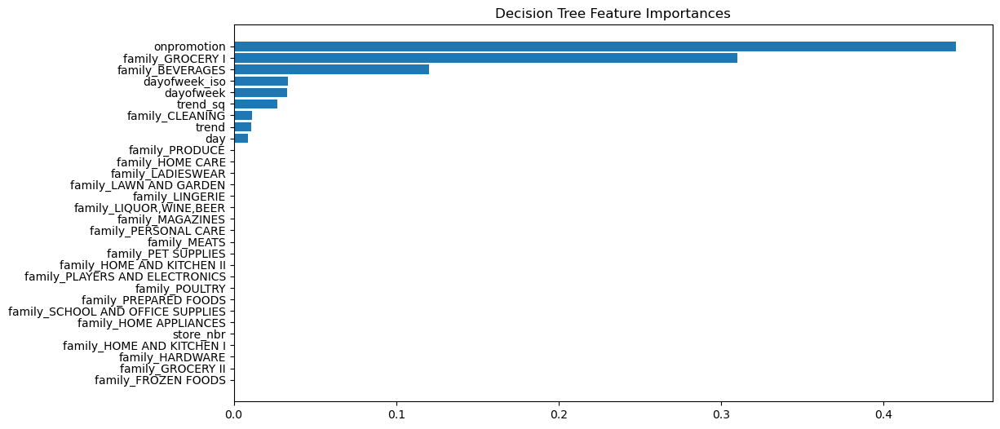


training performance

R² Score: 0.87
RMSE: 230.01
MAE: 72.31

test performance

R² Score: 0.91
RMSE: 326.98
MAE: 166.39


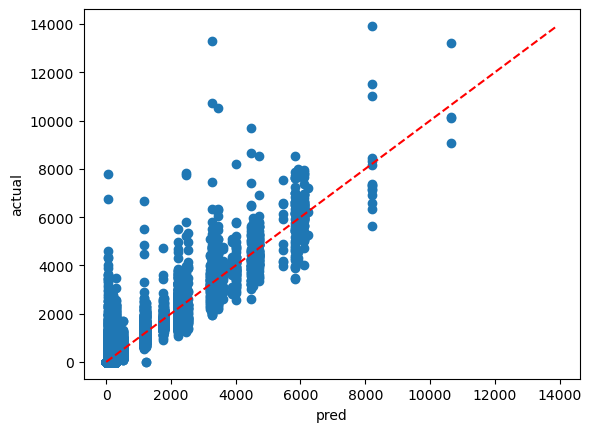

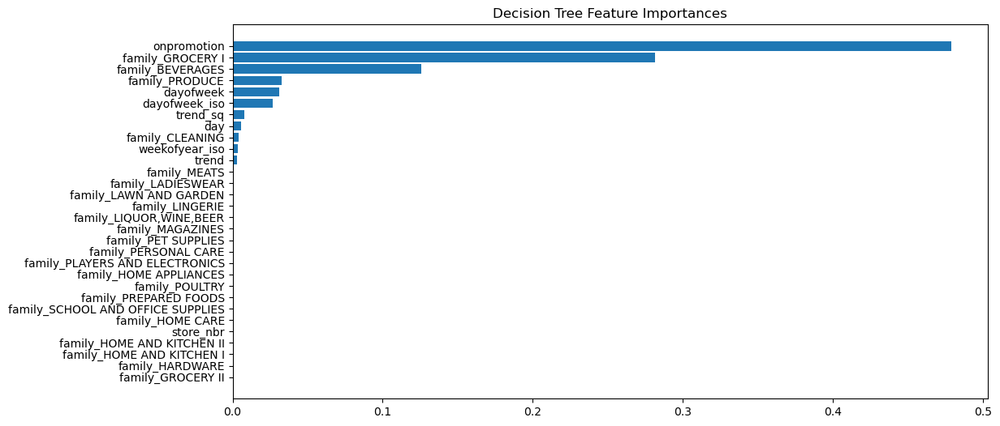


training performance

R² Score: 0.91
RMSE: 91.61
MAE: 28.85

test performance

R² Score: 0.91
RMSE: 176.93
MAE: 90.93


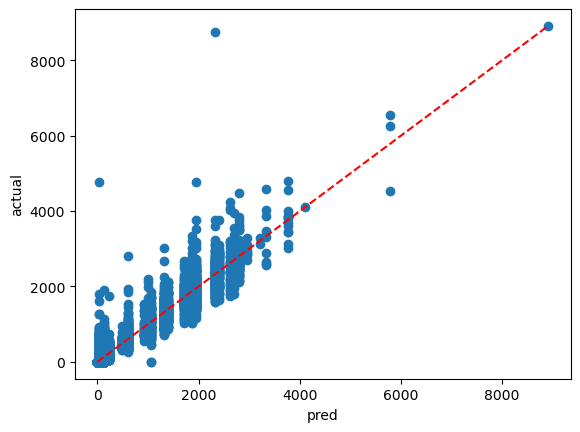

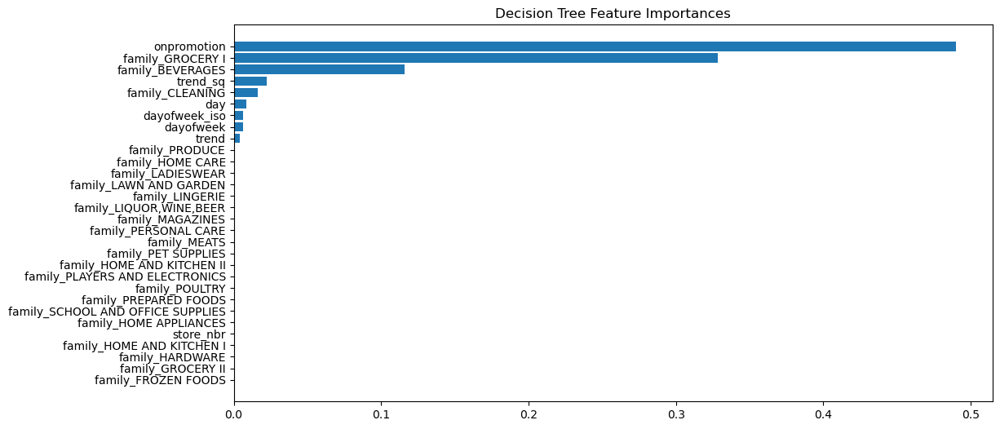


training performance

R² Score: 0.86
RMSE: 170.63
MAE: 100.23

test performance

R² Score: 0.89
RMSE: 154.19
MAE: 99.16


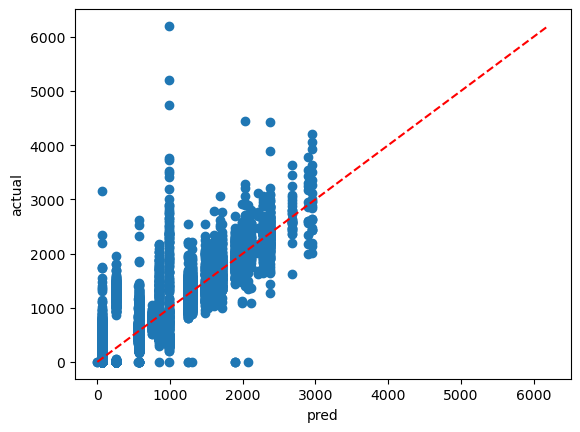

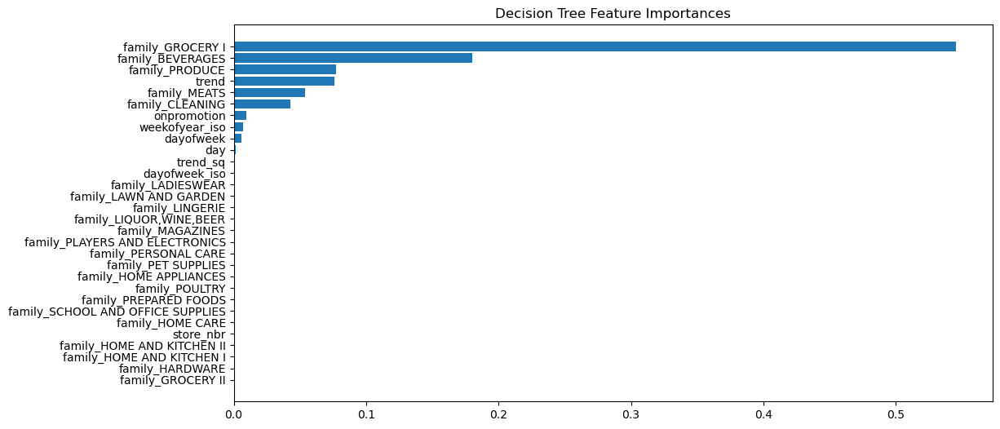


training performance

R² Score: 0.89
RMSE: 335.50
MAE: 185.74

test performance

R² Score: 0.95
RMSE: 228.87
MAE: 160.49


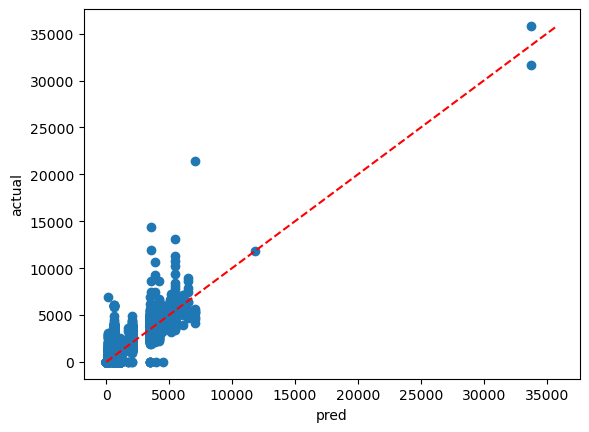

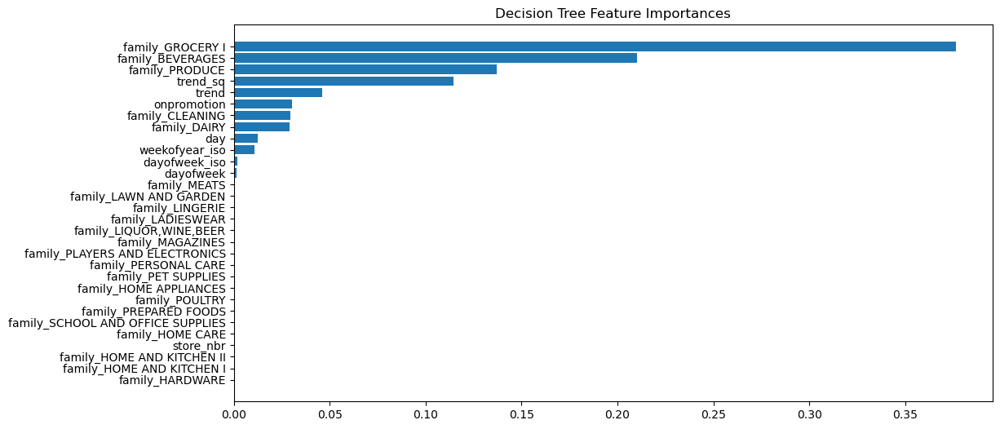


training performance

R² Score: 0.75
RMSE: 278.14
MAE: 114.22

test performance

R² Score: 0.74
RMSE: 343.81
MAE: 135.69


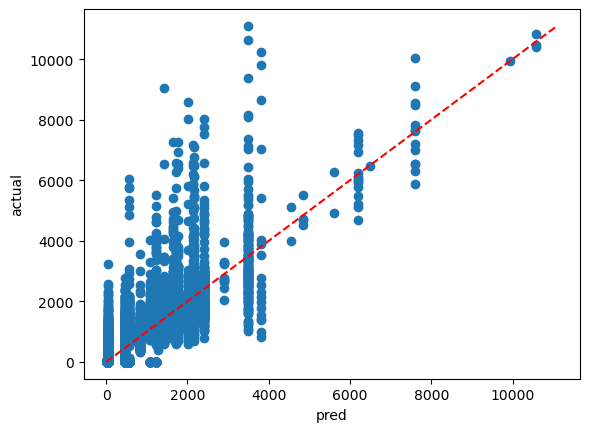

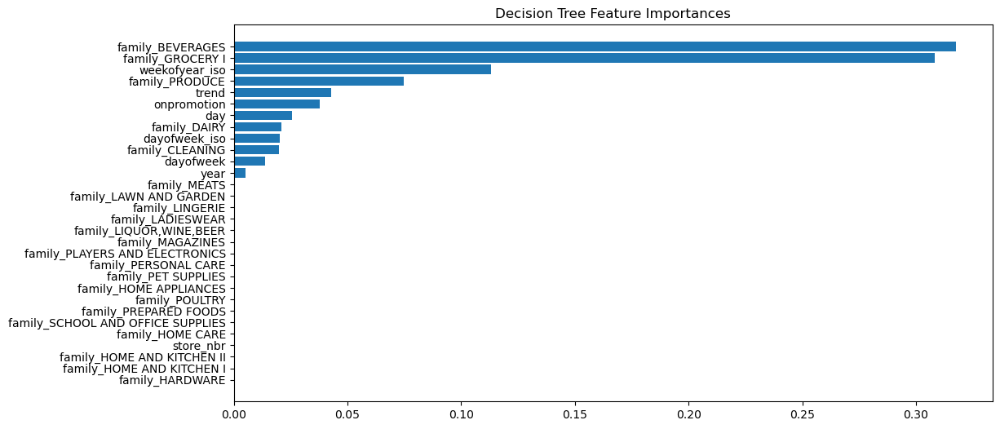


training performance

R² Score: 0.76
RMSE: 207.94
MAE: 76.16

test performance

R² Score: 0.83
RMSE: 135.83
MAE: 76.28


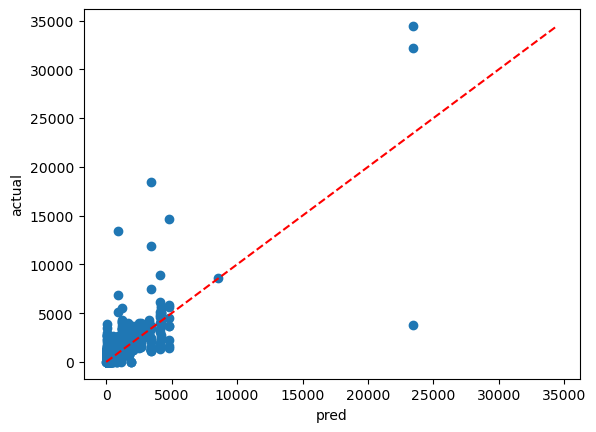

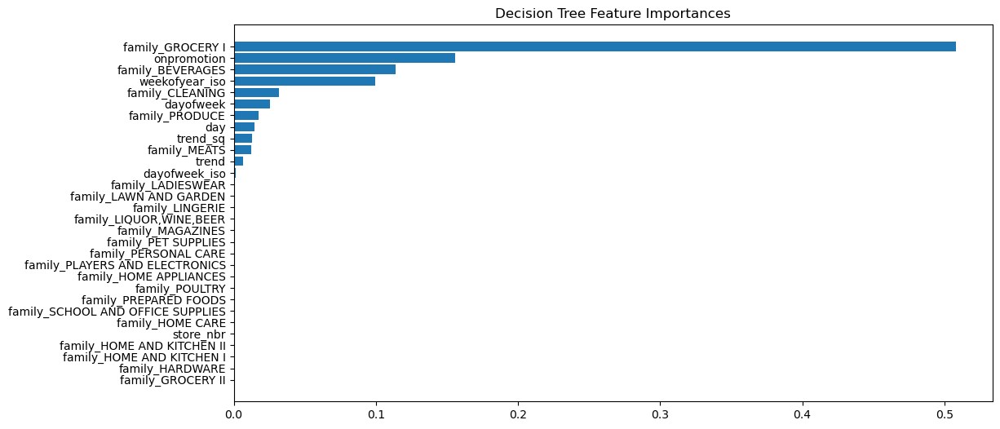


training performance

R² Score: 0.90
RMSE: 261.91
MAE: 154.96

test performance

R² Score: 0.94
RMSE: 239.16
MAE: 158.32


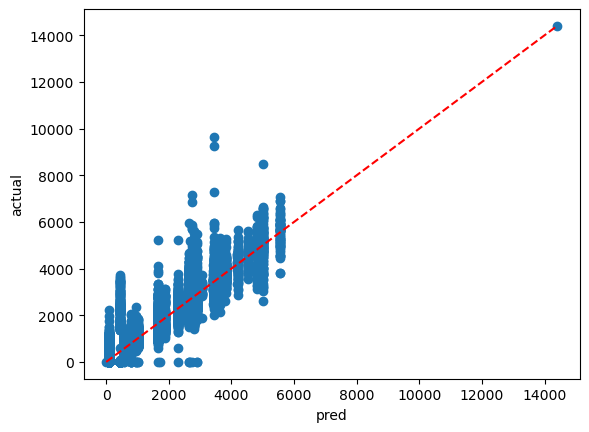

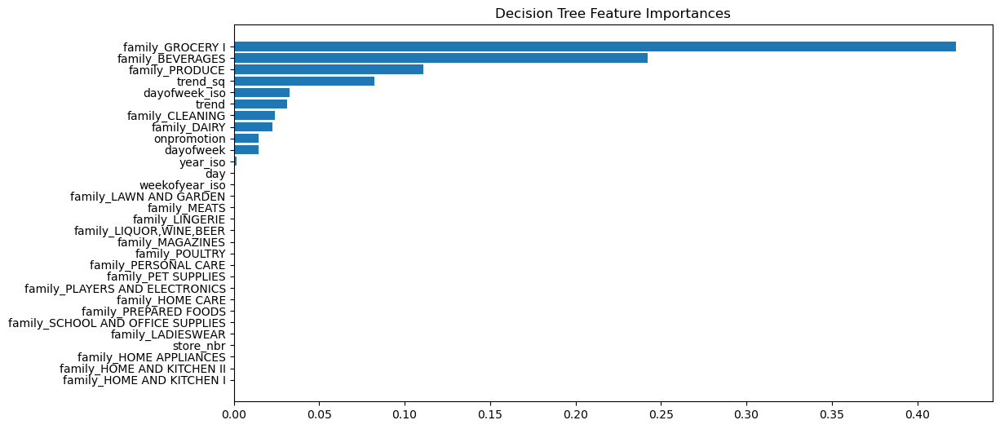


training performance

R² Score: 0.88
RMSE: 295.34
MAE: 161.01

test performance

R² Score: 0.86
RMSE: 485.68
MAE: 211.40


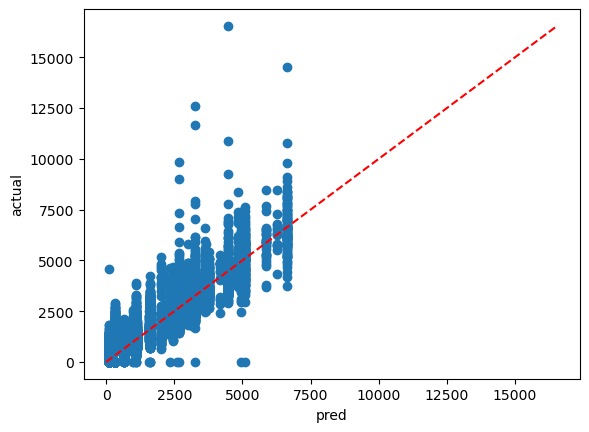

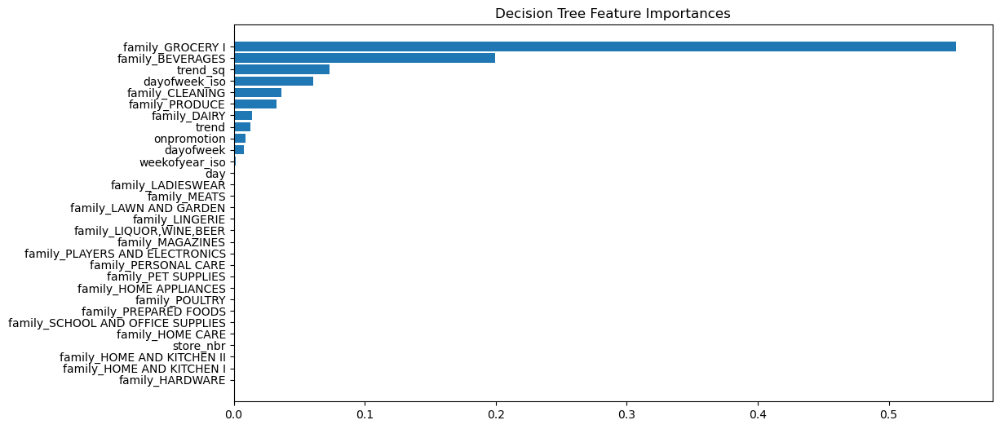


training performance

R² Score: 0.88
RMSE: 204.48
MAE: 75.85

test performance

R² Score: 0.93
RMSE: 264.68
MAE: 147.50


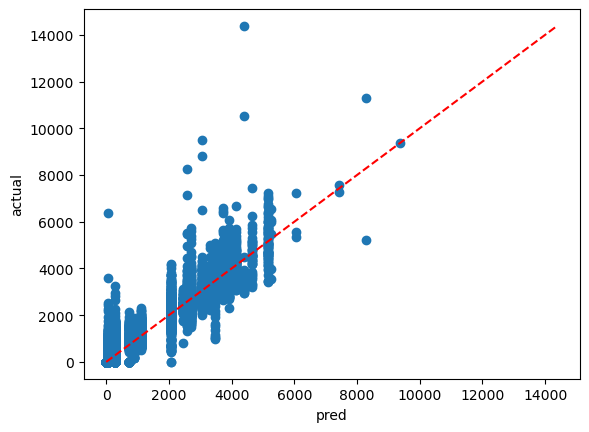

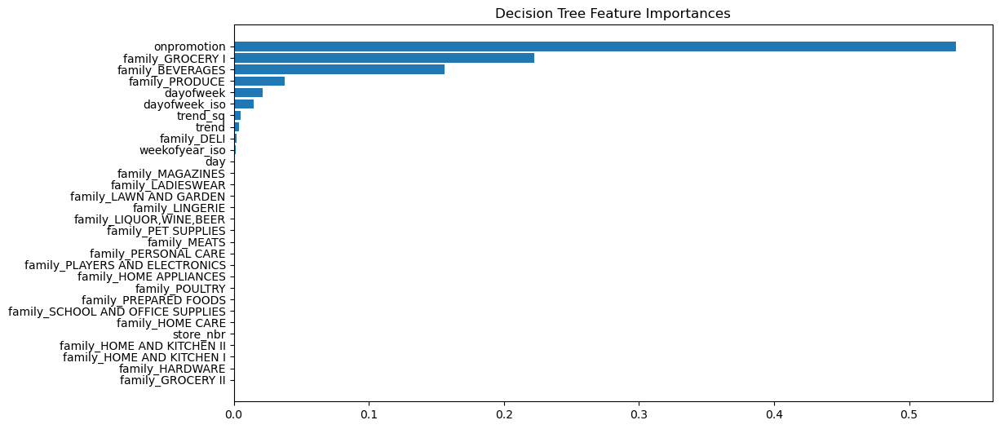


training performance

R² Score: 0.90
RMSE: 678.54
MAE: 369.84

test performance

R² Score: 0.93
RMSE: 594.87
MAE: 343.88


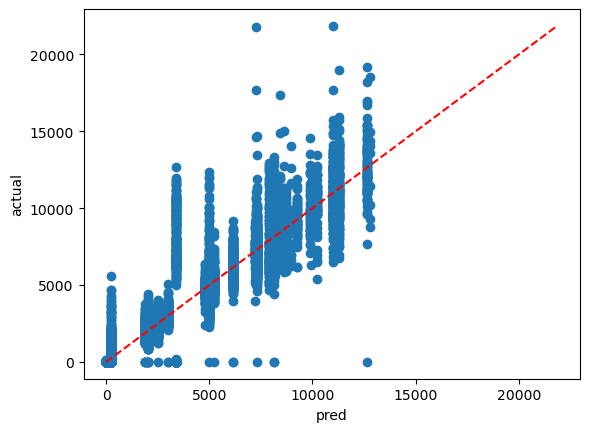

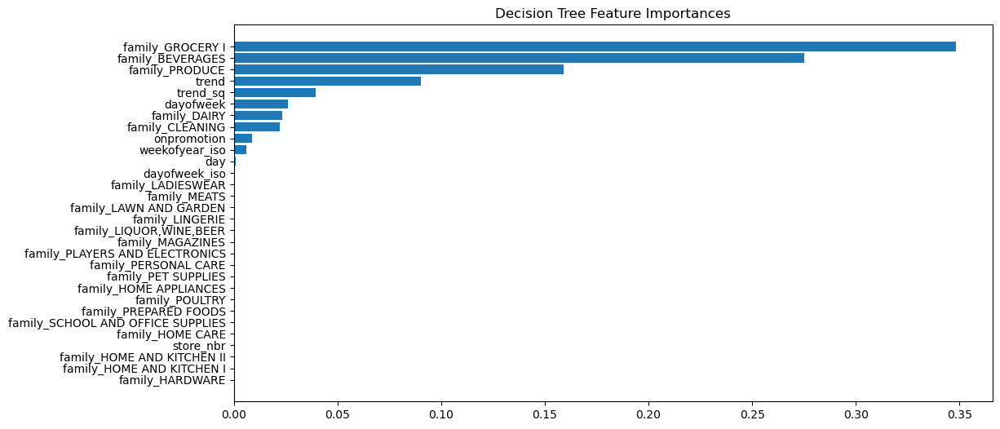


training performance

R² Score: 0.87
RMSE: 125.96
MAE: 58.07

test performance

R² Score: 0.82
RMSE: 222.42
MAE: 88.14


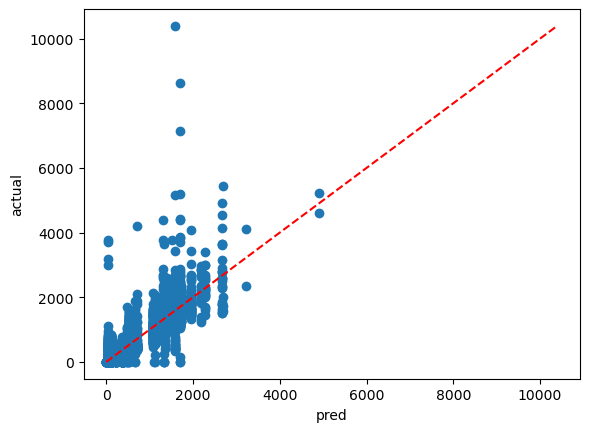

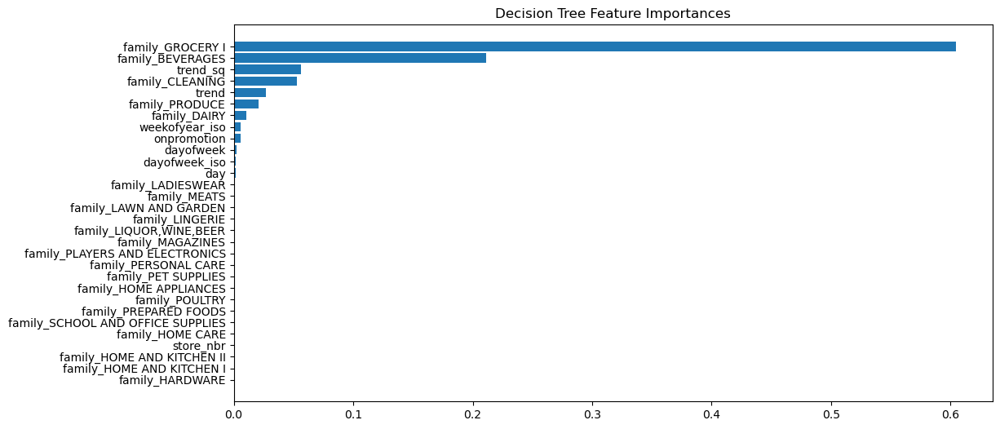


training performance

R² Score: 0.90
RMSE: 264.15
MAE: 140.79

test performance

R² Score: 0.85
RMSE: 422.94
MAE: 199.98


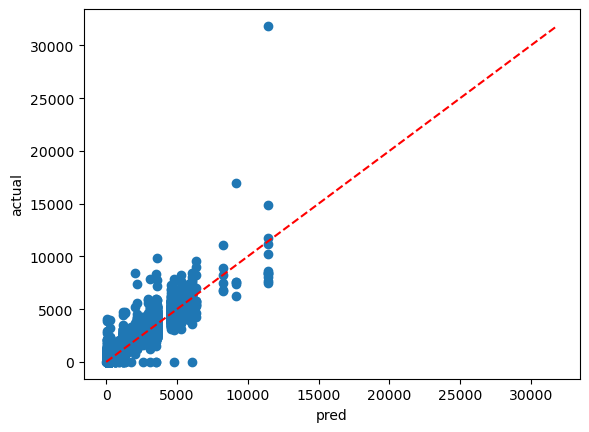

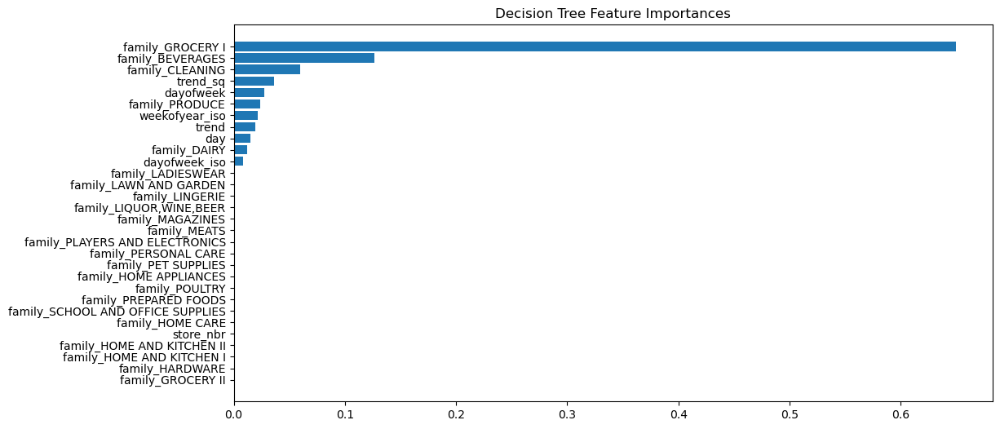


training performance

R² Score: 0.85
RMSE: 130.45
MAE: 48.01

test performance

R² Score: 0.81
RMSE: 185.25
MAE: 71.27


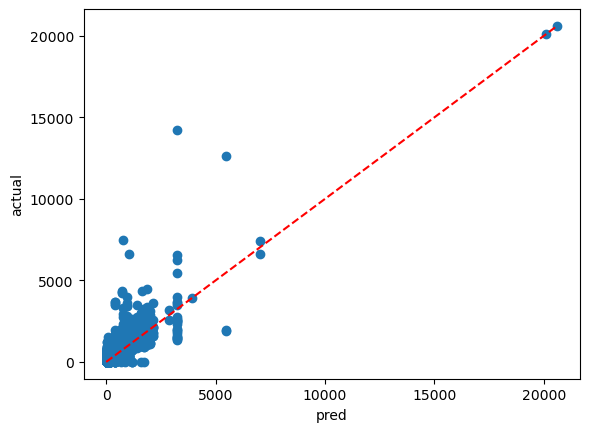

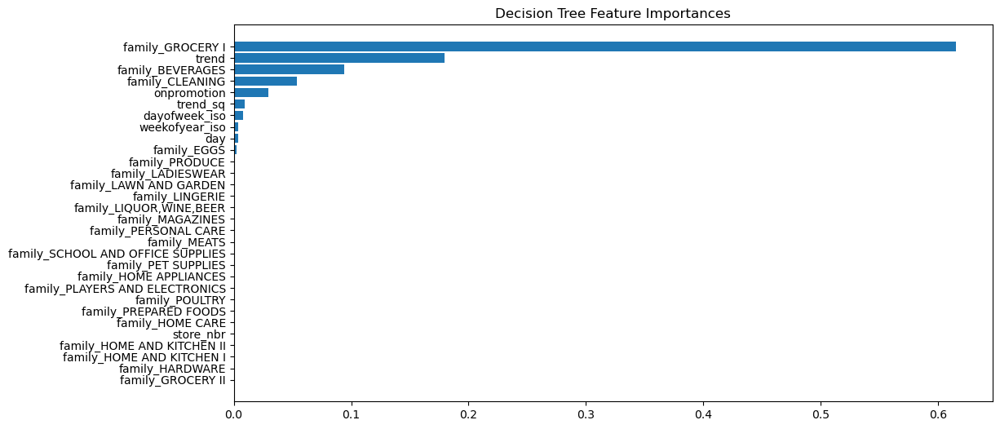


training performance

R² Score: 0.90
RMSE: 202.64
MAE: 113.10

test performance

R² Score: 0.89
RMSE: 237.81
MAE: 119.48


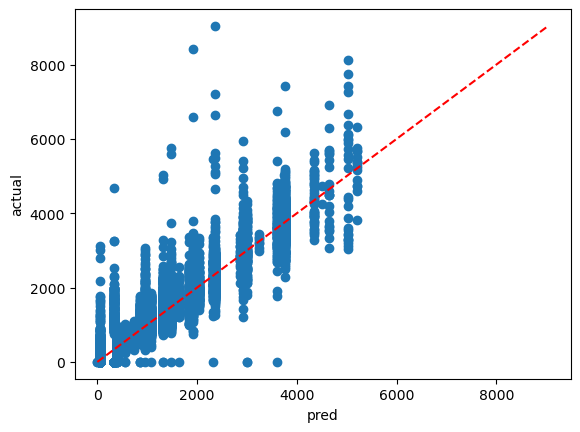

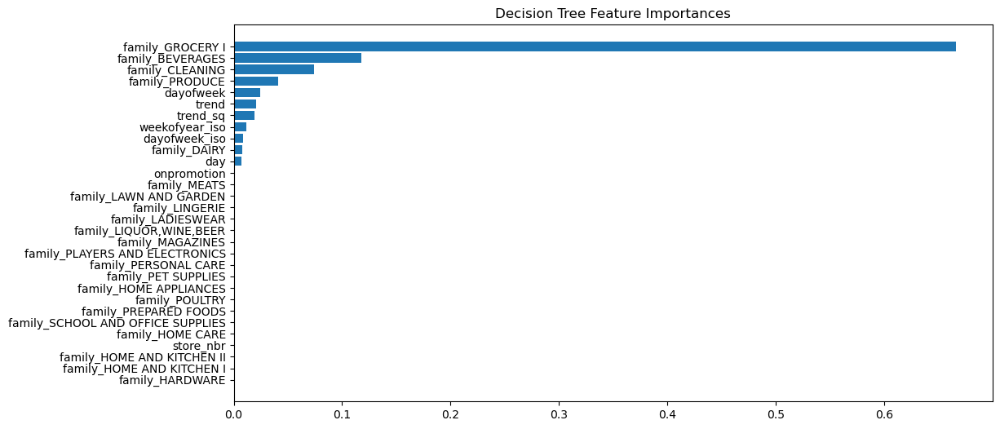


training performance

R² Score: 0.92
RMSE: 217.28
MAE: 118.48

test performance

R² Score: 0.95
RMSE: 191.10
MAE: 116.14


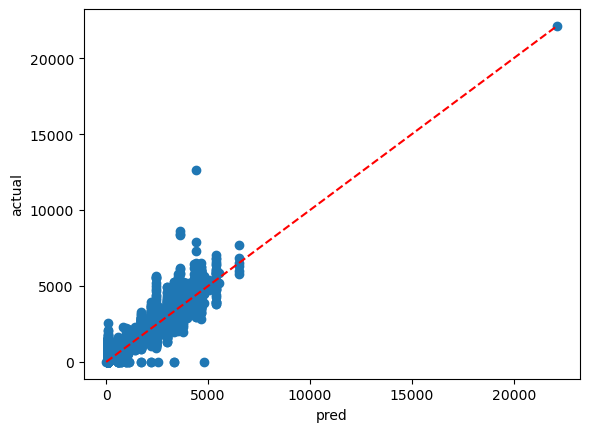

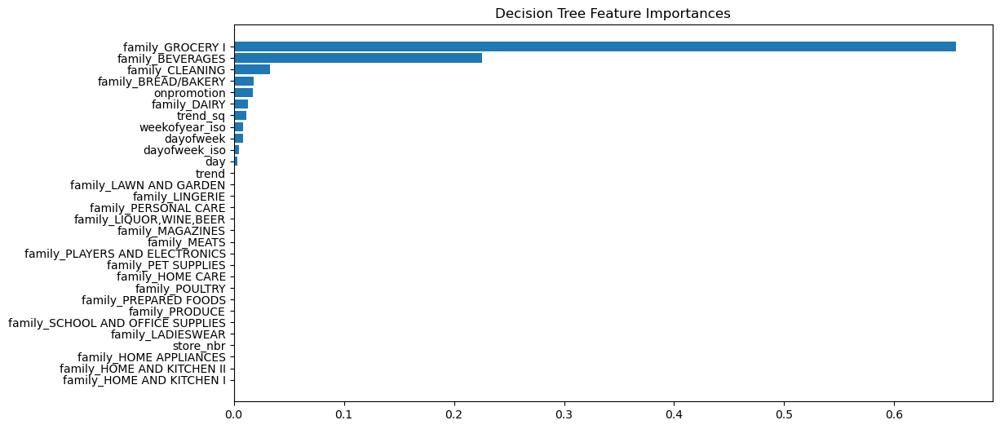


training performance

R² Score: 0.85
RMSE: 182.30
MAE: 53.81

test performance

R² Score: 0.95
RMSE: 101.92
MAE: 50.01


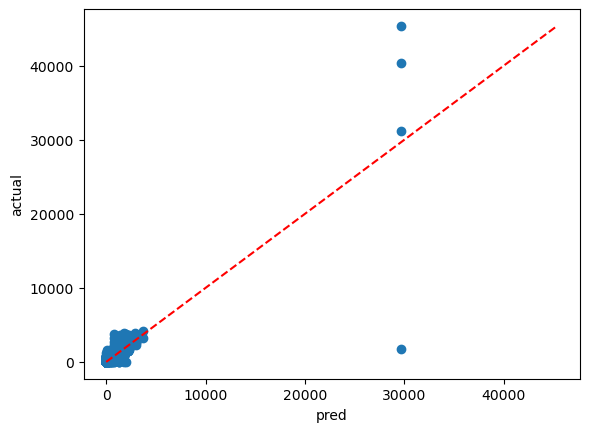

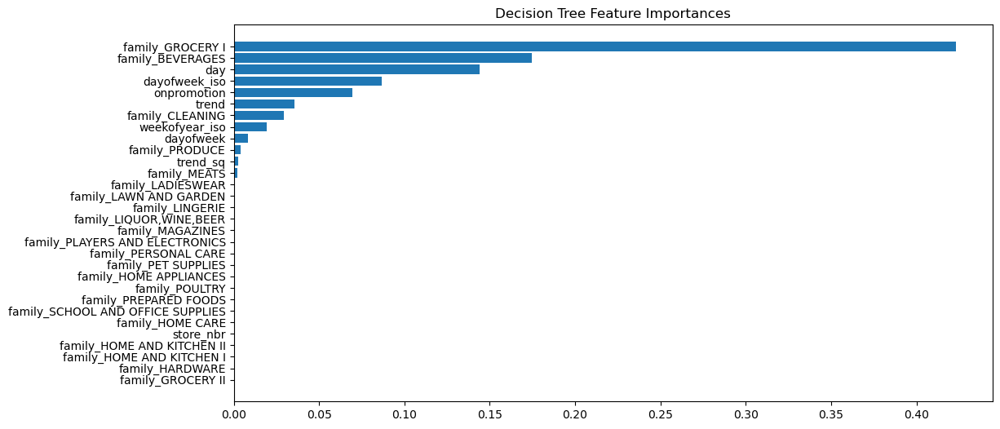


training performance

R² Score: 0.90
RMSE: 232.57
MAE: 121.73

test performance

R² Score: 0.90
RMSE: 312.86
MAE: 148.43


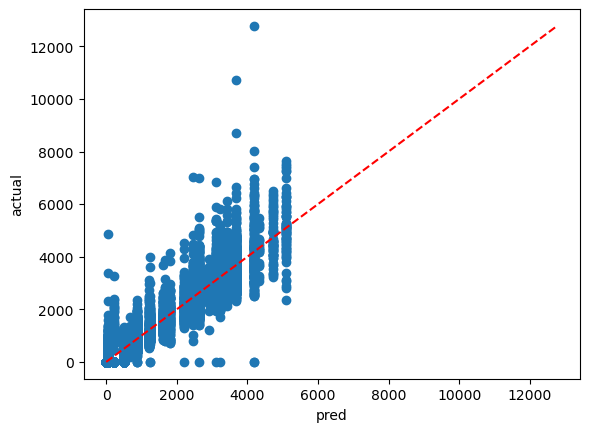

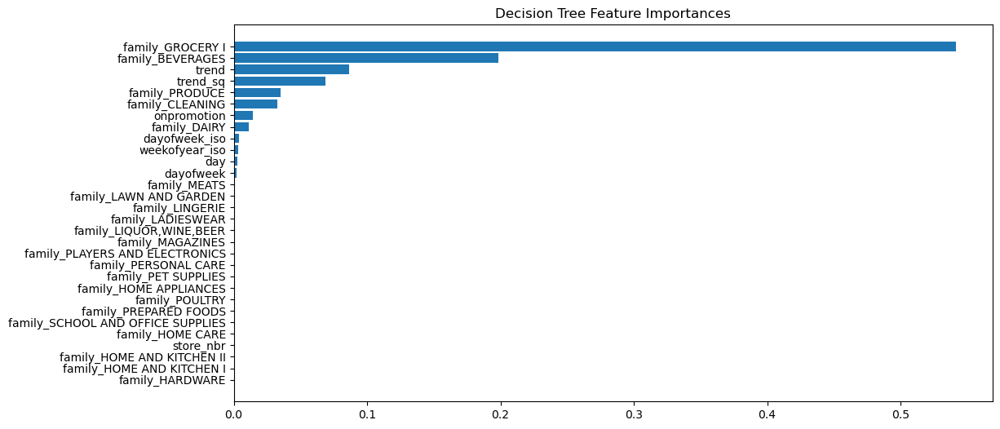


training performance

R² Score: 0.90
RMSE: 265.23
MAE: 141.69

test performance

R² Score: 0.91
RMSE: 247.69
MAE: 138.59


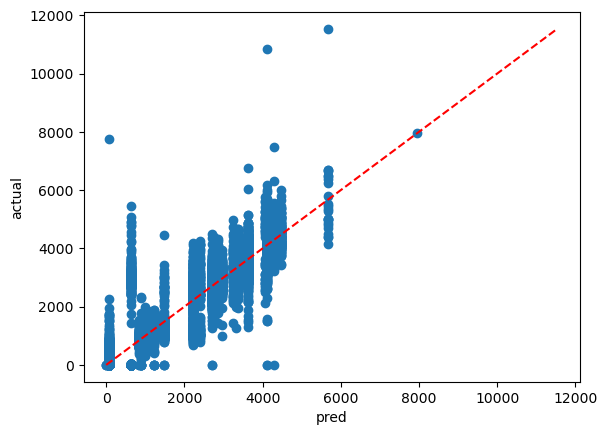

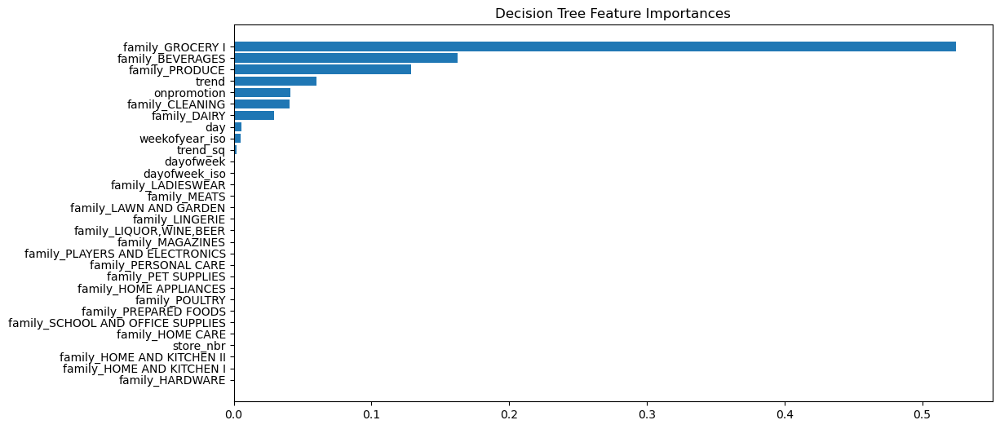


training performance

R² Score: 0.89
RMSE: 282.55
MAE: 141.18

test performance

R² Score: 0.82
RMSE: 363.97
MAE: 143.68


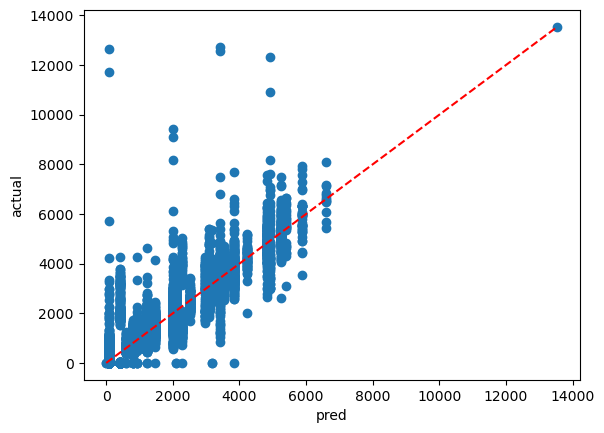

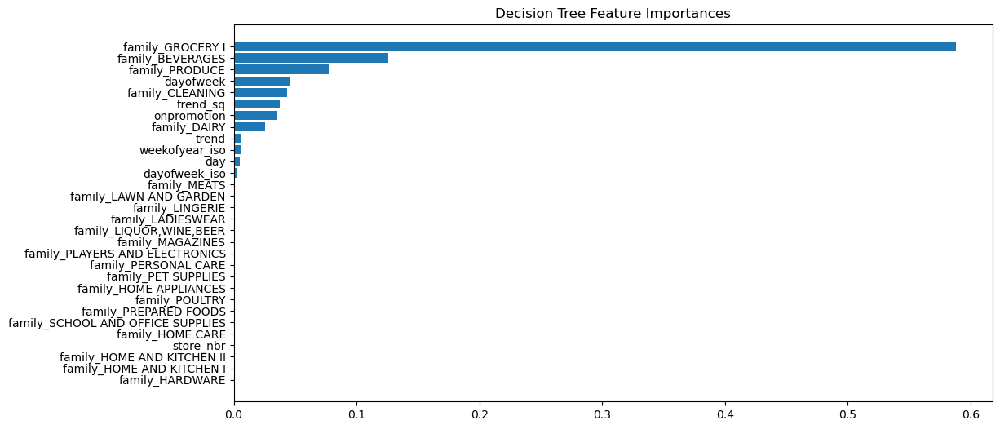


training performance

R² Score: 0.76
RMSE: 490.91
MAE: 156.07

test performance

R² Score: 0.74
RMSE: 615.70
MAE: 242.81


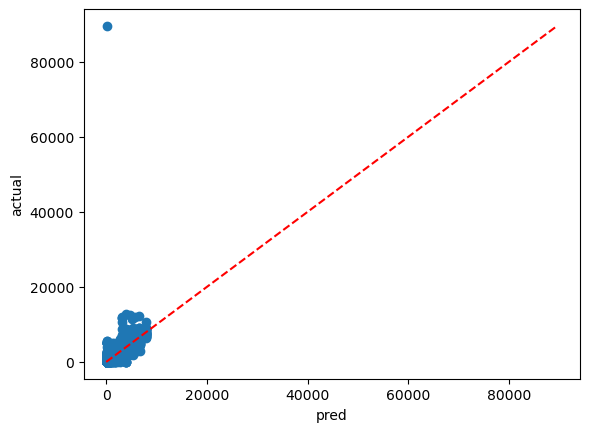

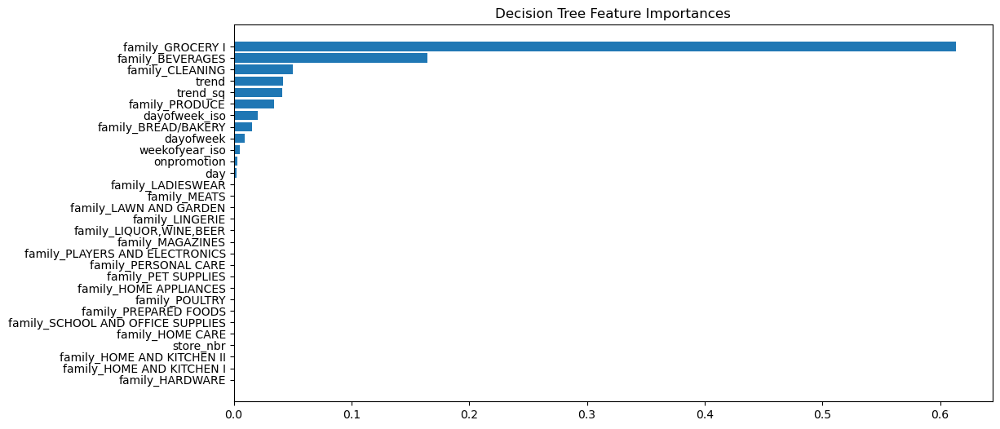


training performance

R² Score: 0.90
RMSE: 259.12
MAE: 149.14

test performance

R² Score: 0.90
RMSE: 243.27
MAE: 146.26


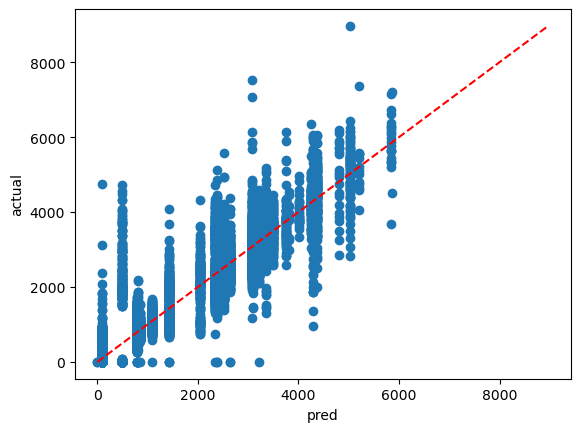

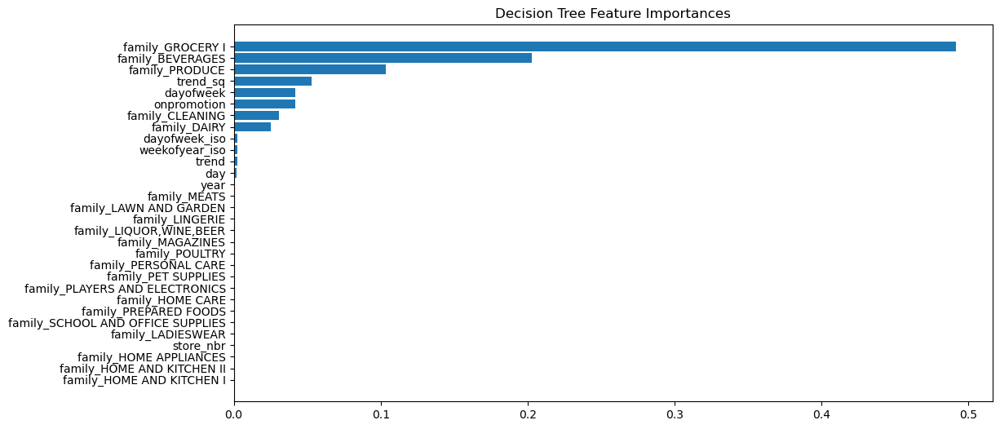


training performance

R² Score: 0.93
RMSE: 248.11
MAE: 126.33

test performance

R² Score: 0.87
RMSE: 529.15
MAE: 202.87


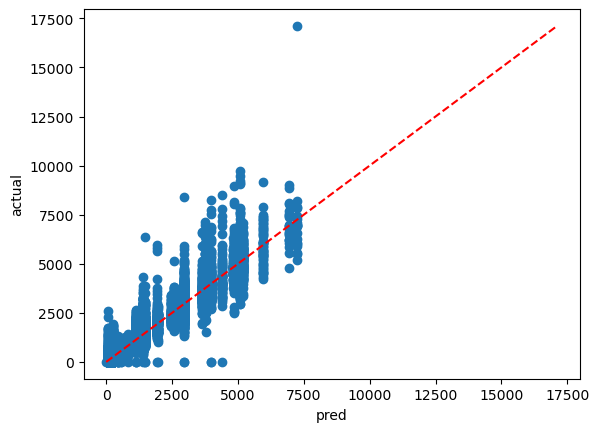

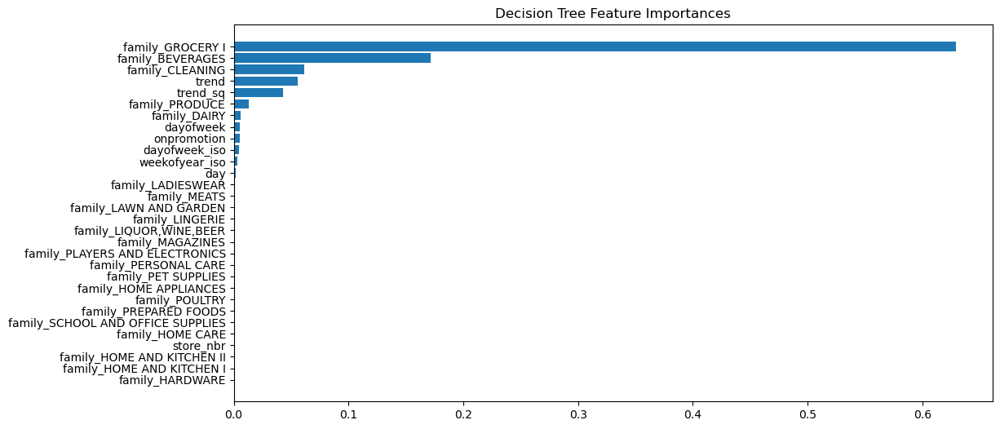


training performance

R² Score: 0.89
RMSE: 222.30
MAE: 117.16

test performance

R² Score: 0.89
RMSE: 276.57
MAE: 143.62


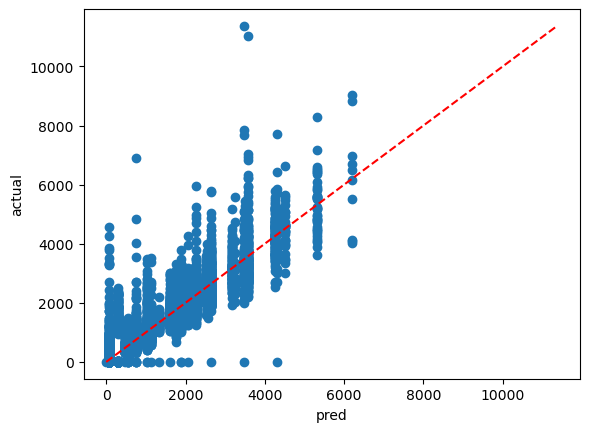

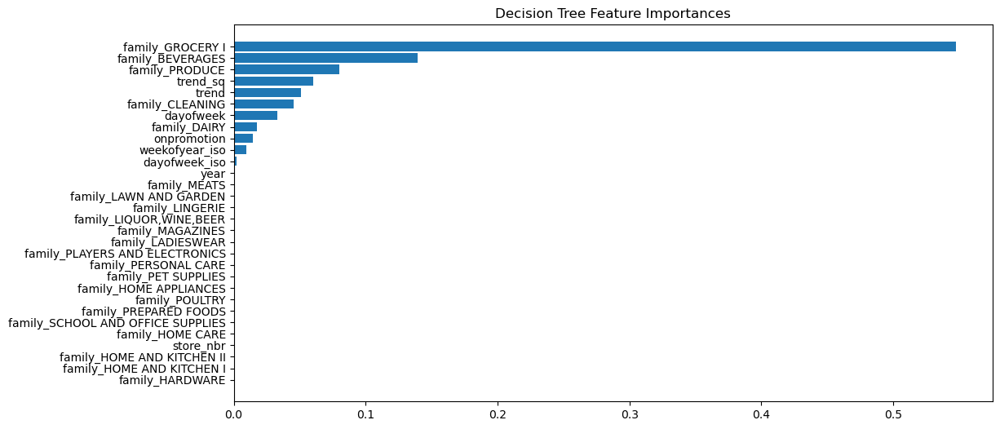


training performance

R² Score: 0.92
RMSE: 162.00
MAE: 56.76

test performance

R² Score: 0.84
RMSE: 304.41
MAE: 146.10


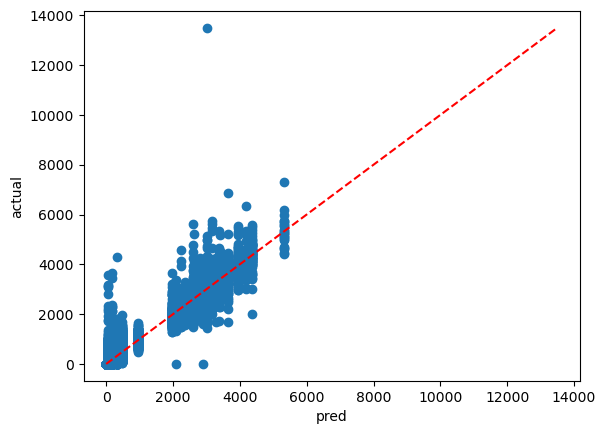

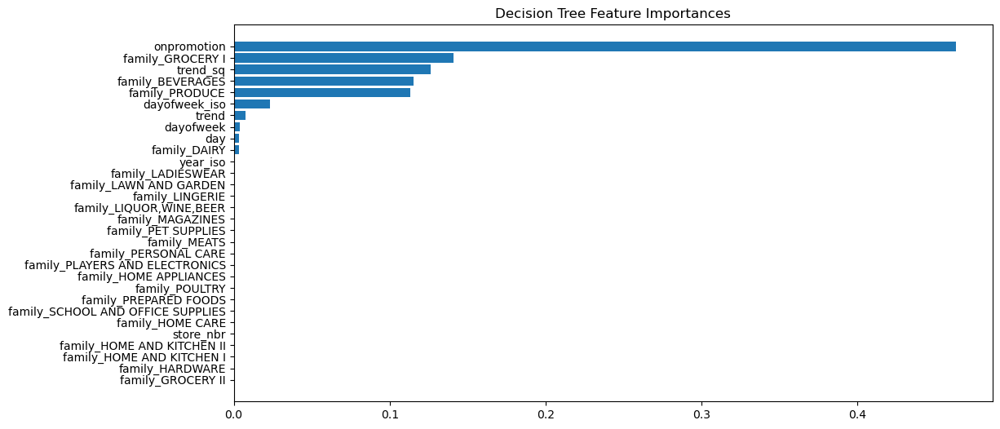


training performance

R² Score: 0.92
RMSE: 226.21
MAE: 111.22

test performance

R² Score: 0.92
RMSE: 345.72
MAE: 160.64


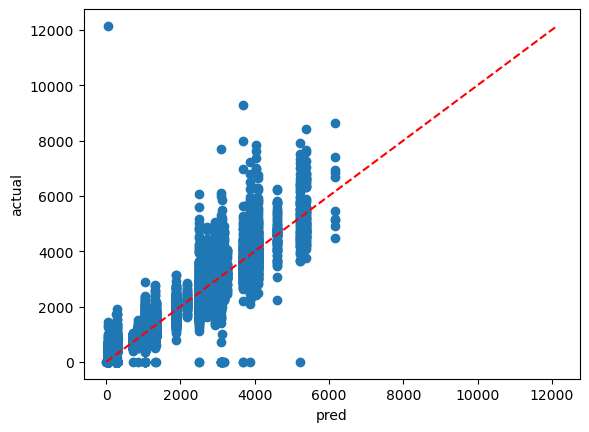

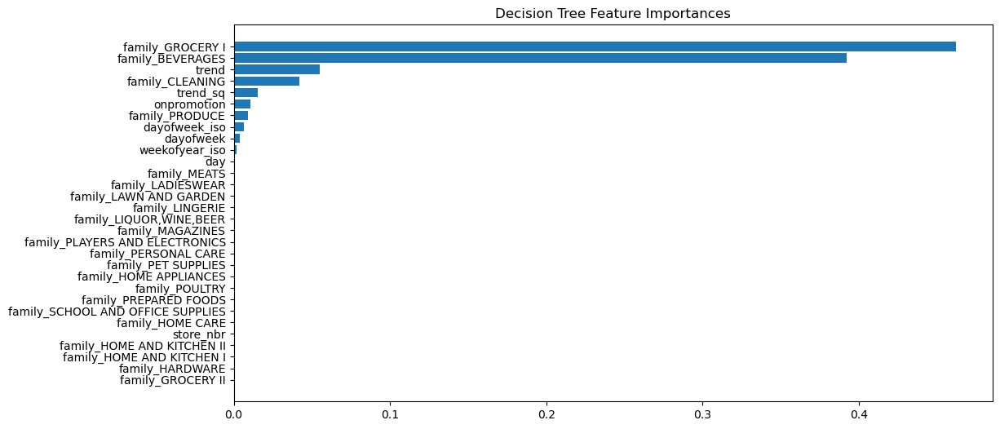


training performance

R² Score: 0.87
RMSE: 952.11
MAE: 476.26

test performance

R² Score: 0.91
RMSE: 811.49
MAE: 451.19


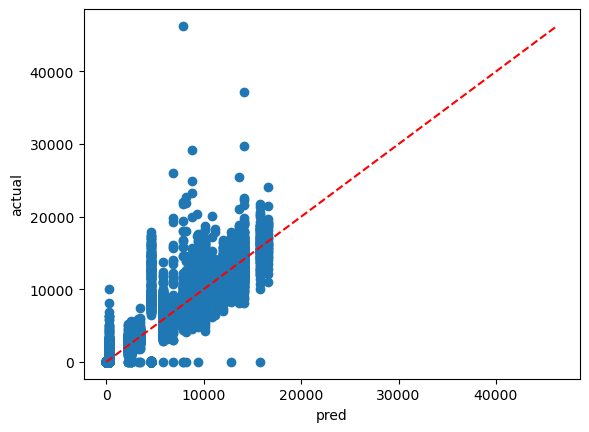

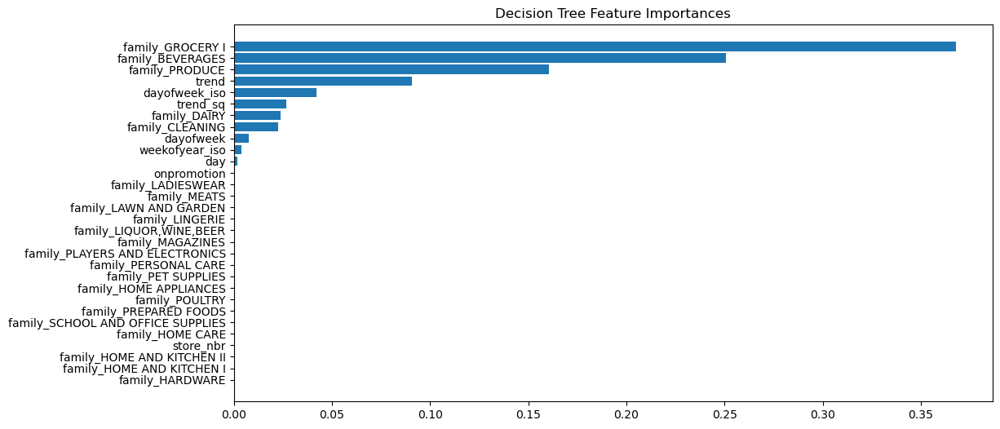


training performance

R² Score: 0.88
RMSE: 841.40
MAE: 435.32

test performance

R² Score: 0.93
RMSE: 692.64
MAE: 418.14


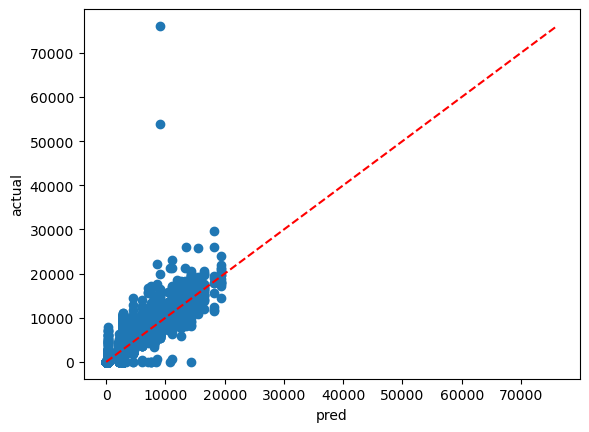

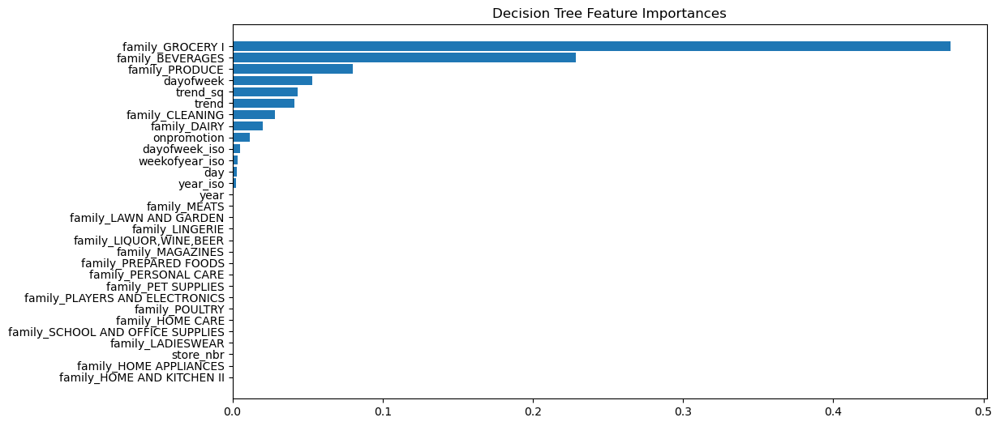


training performance

R² Score: 0.89
RMSE: 614.62
MAE: 367.05

test performance

R² Score: 0.86
RMSE: 729.02
MAE: 390.43


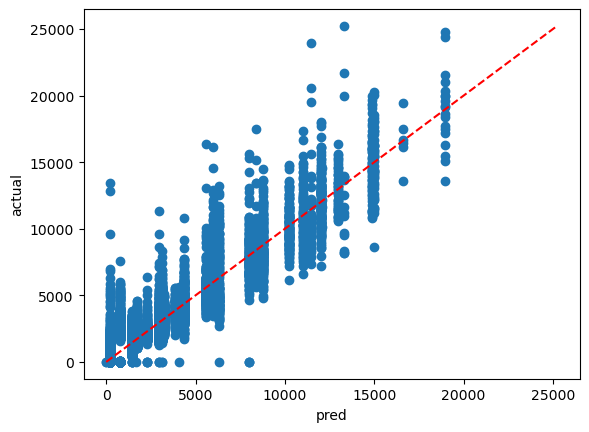

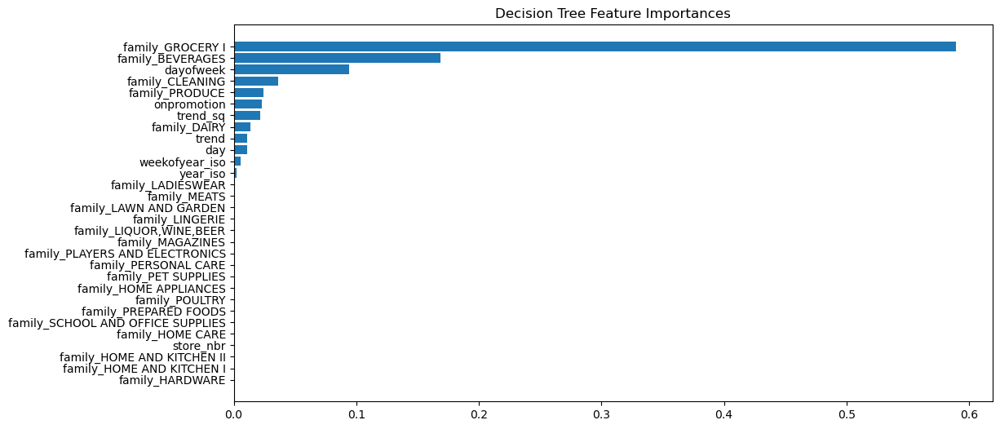


training performance

R² Score: 0.90
RMSE: 688.04
MAE: 396.30

test performance

R² Score: 0.91
RMSE: 721.55
MAE: 394.13


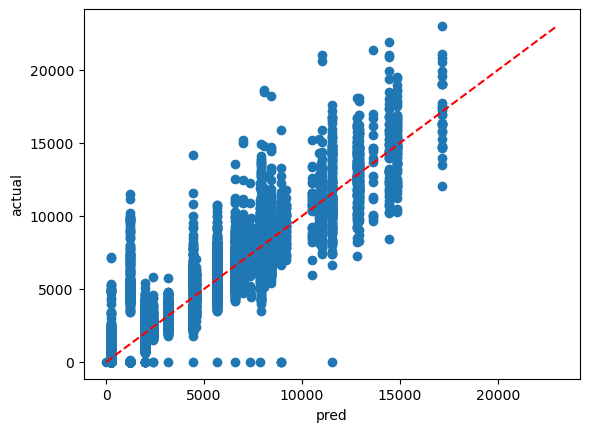

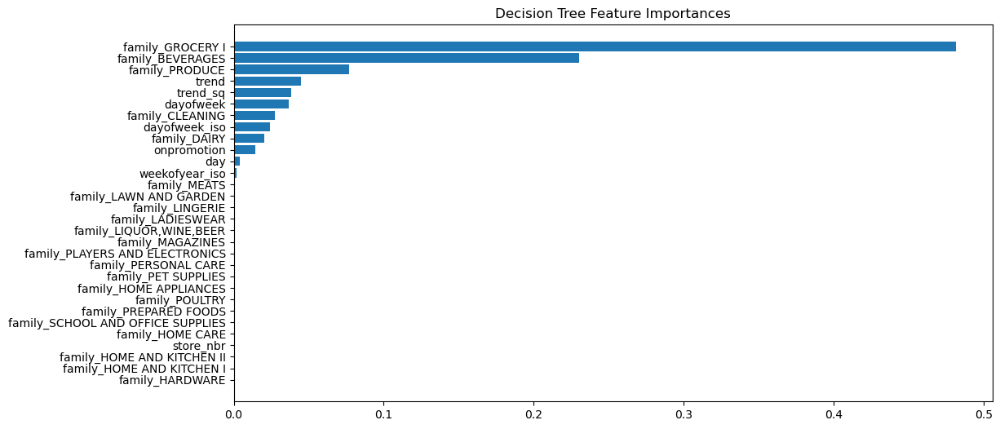


training performance

R² Score: 0.89
RMSE: 551.54
MAE: 314.03

test performance

R² Score: 0.89
RMSE: 579.21
MAE: 348.96


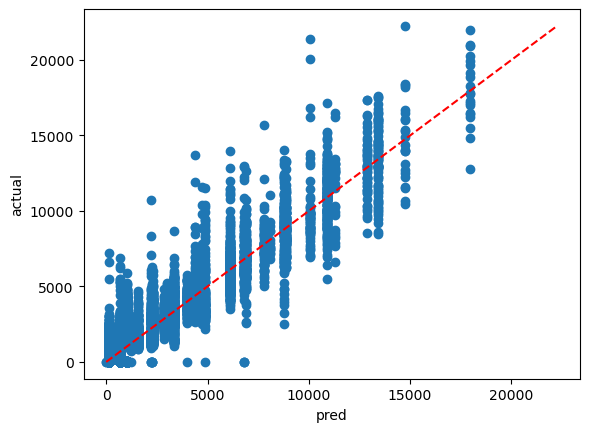

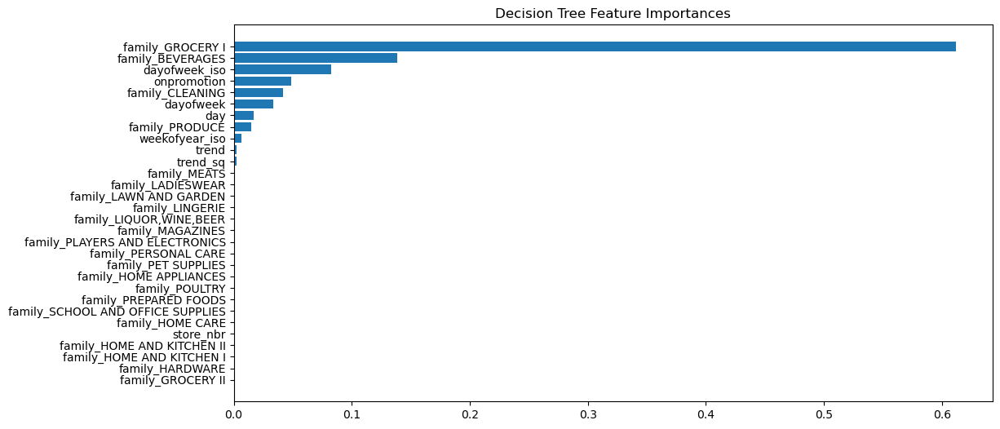


training performance

R² Score: 0.90
RMSE: 606.66
MAE: 330.39

test performance

R² Score: 0.92
RMSE: 606.49
MAE: 348.81


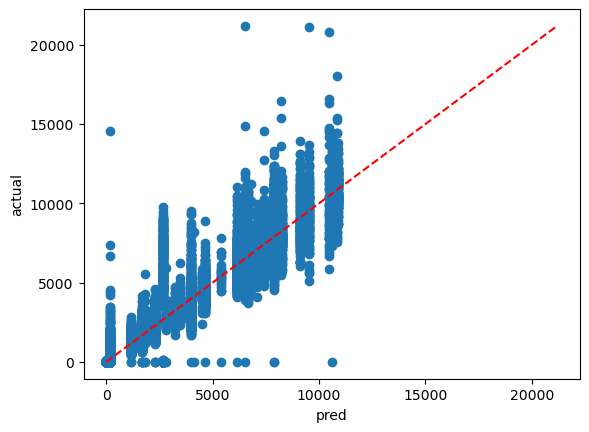

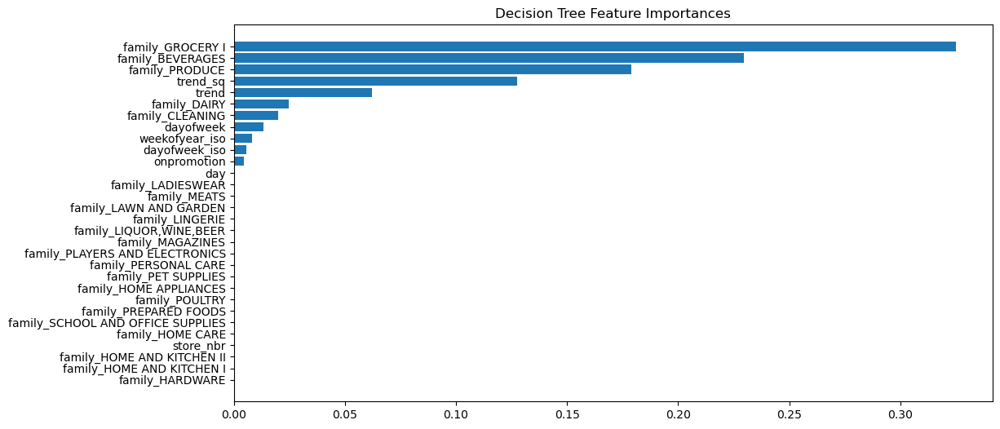


training performance

R² Score: 0.90
RMSE: 202.80
MAE: 120.72

test performance

R² Score: 0.95
RMSE: 150.02
MAE: 101.19


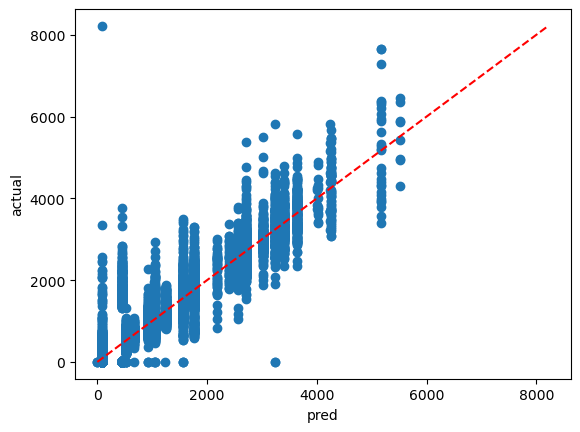

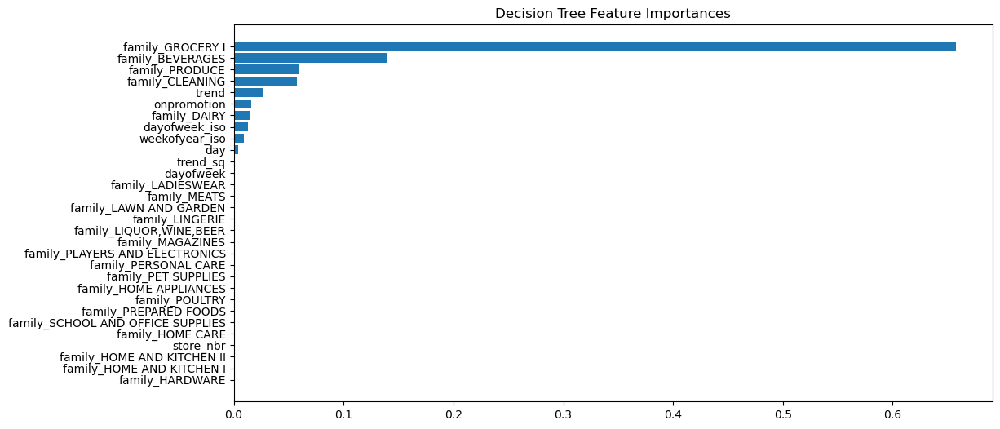


training performance

R² Score: 0.92
RMSE: 367.54
MAE: 217.52

test performance

R² Score: 0.93
RMSE: 373.83
MAE: 218.54


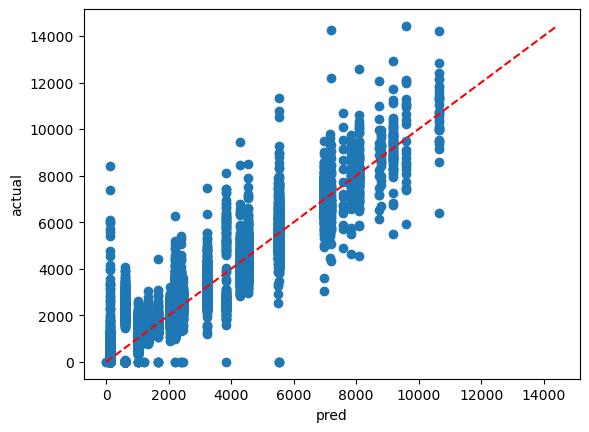

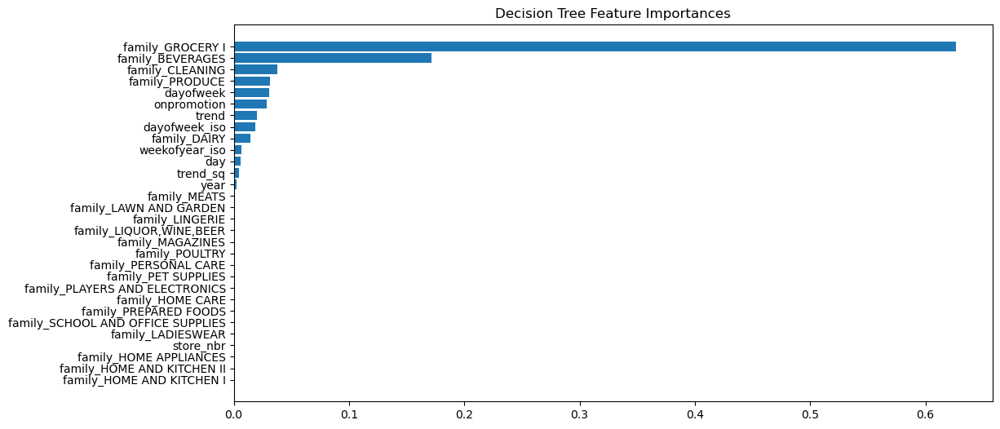


training performance

R² Score: 0.88
RMSE: 469.71
MAE: 252.95

test performance

R² Score: 0.94
RMSE: 370.73
MAE: 233.95


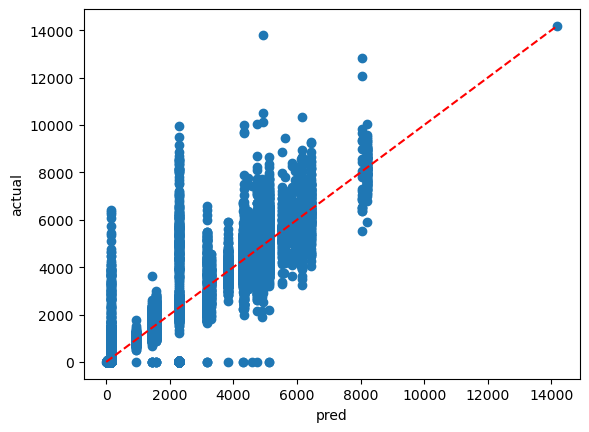

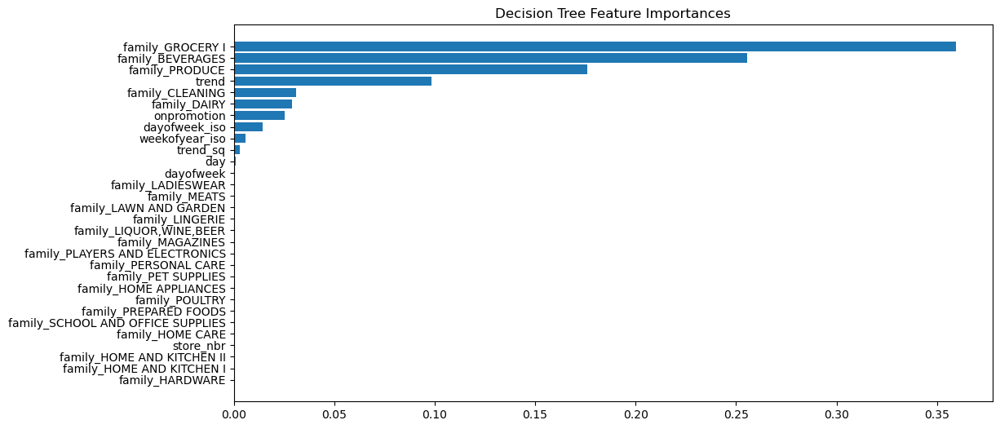


training performance

R² Score: 0.97
RMSE: 74.31
MAE: 11.23

test performance

R² Score: 0.92
RMSE: 431.27
MAE: 226.63


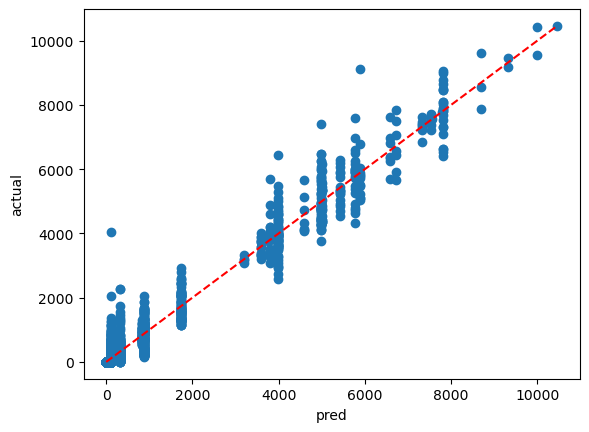

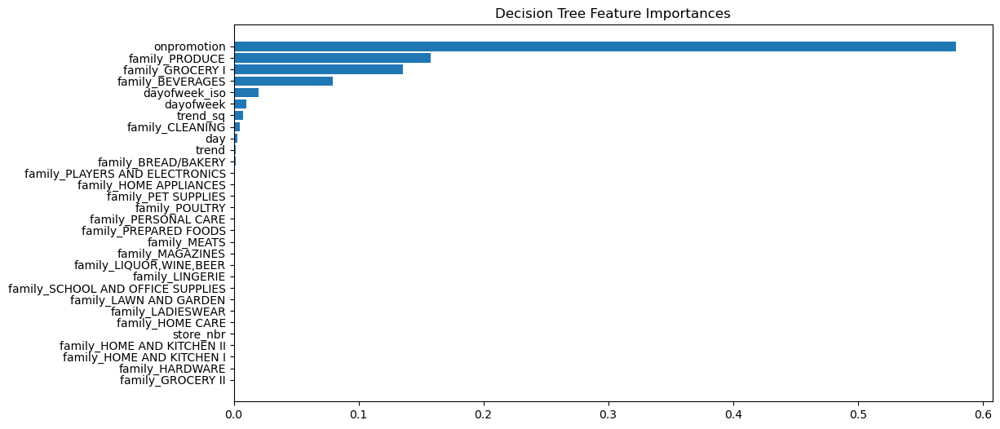


training performance

R² Score: 0.88
RMSE: 206.23
MAE: 86.80

test performance

R² Score: 0.93
RMSE: 201.30
MAE: 122.04


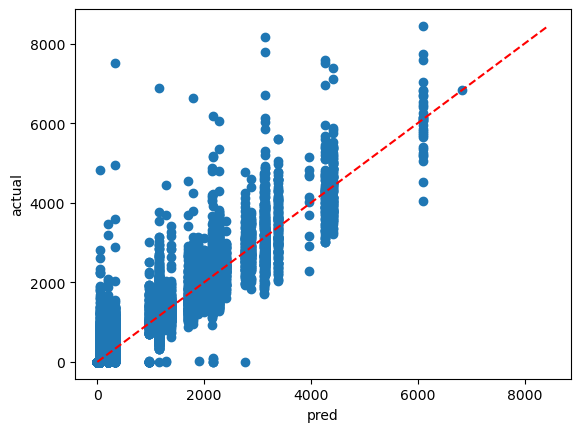

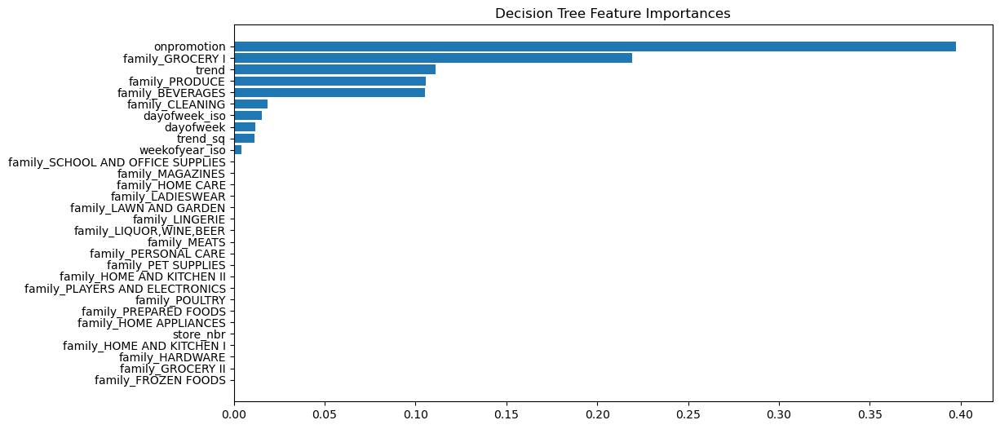


training performance

R² Score: 0.91
RMSE: 176.04
MAE: 72.85

test performance

R² Score: 0.91
RMSE: 296.04
MAE: 104.17


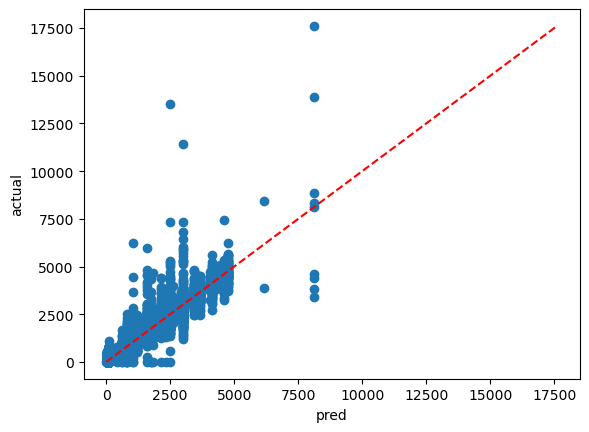

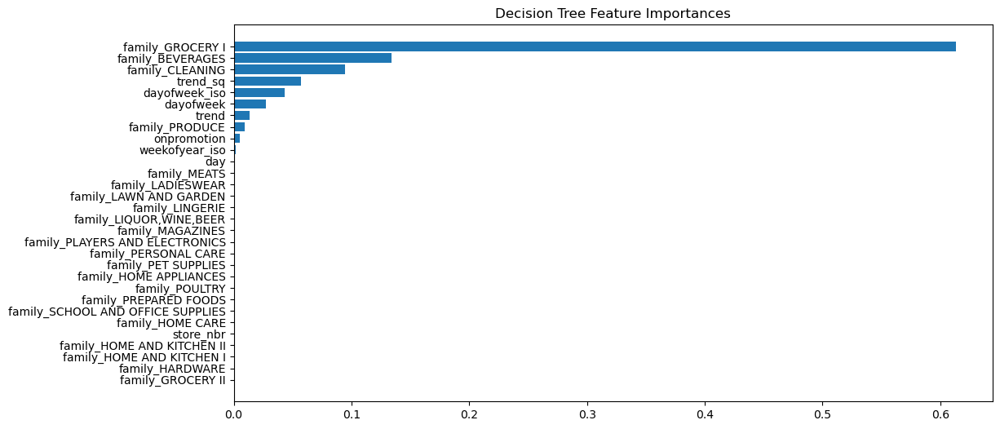


training performance

R² Score: 0.91
RMSE: 327.47
MAE: 196.90

test performance

R² Score: 0.91
RMSE: 314.03
MAE: 189.10


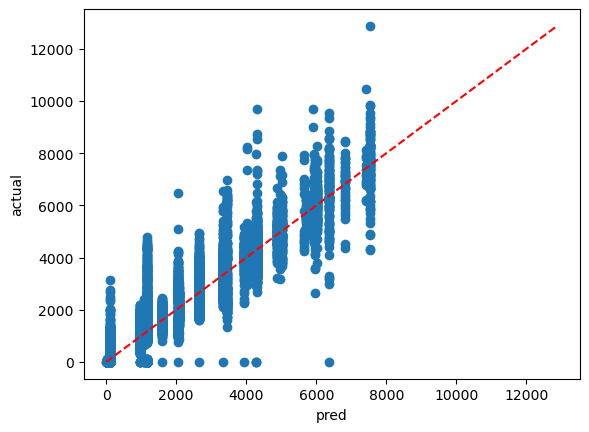

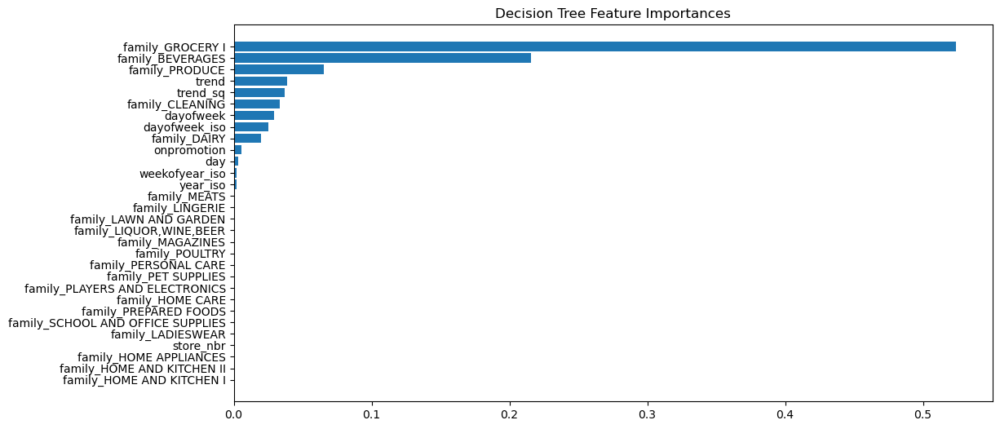


training performance

R² Score: 0.89
RMSE: 369.50
MAE: 194.19

test performance

R² Score: 0.92
RMSE: 329.66
MAE: 202.24


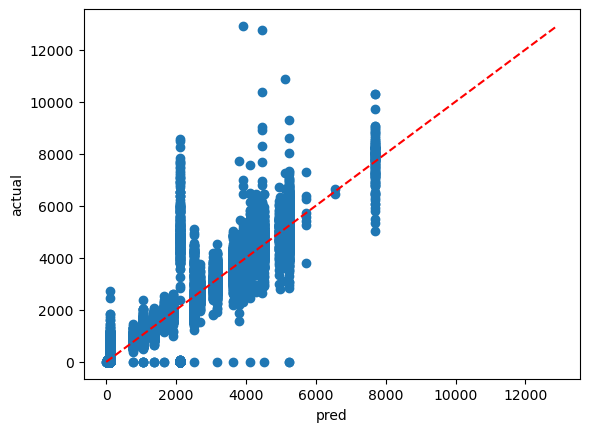

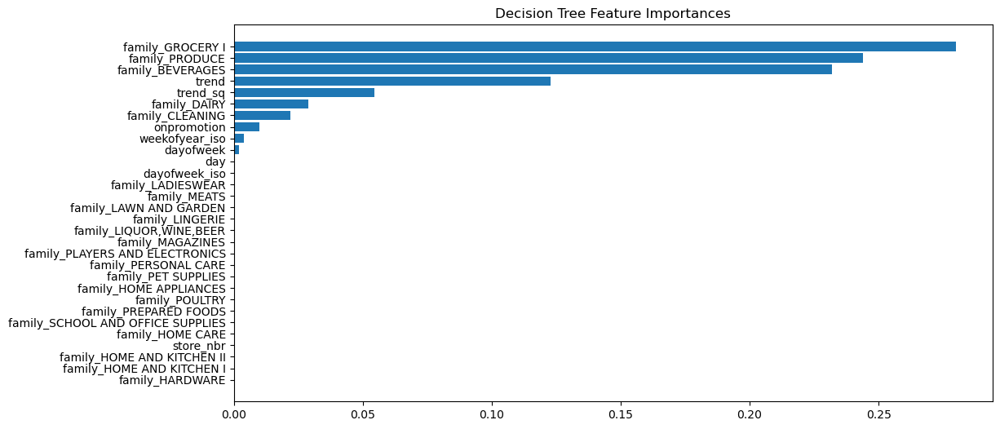


training performance

R² Score: 0.89
RMSE: 421.85
MAE: 228.88

test performance

R² Score: 0.94
RMSE: 337.70
MAE: 208.69


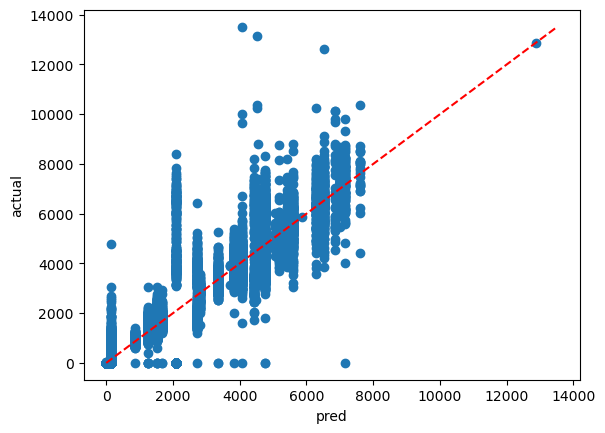

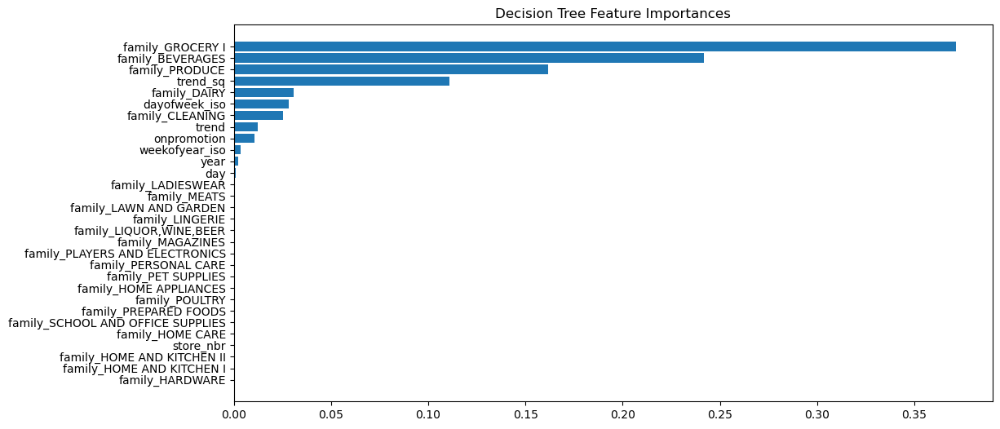


training performance

R² Score: 0.91
RMSE: 386.05
MAE: 211.41

test performance

R² Score: 0.92
RMSE: 397.00
MAE: 211.96


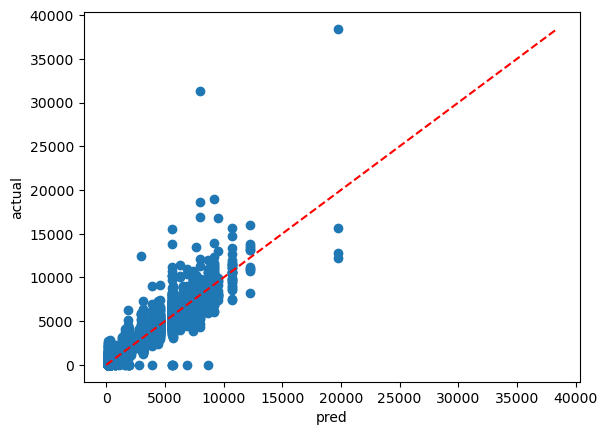

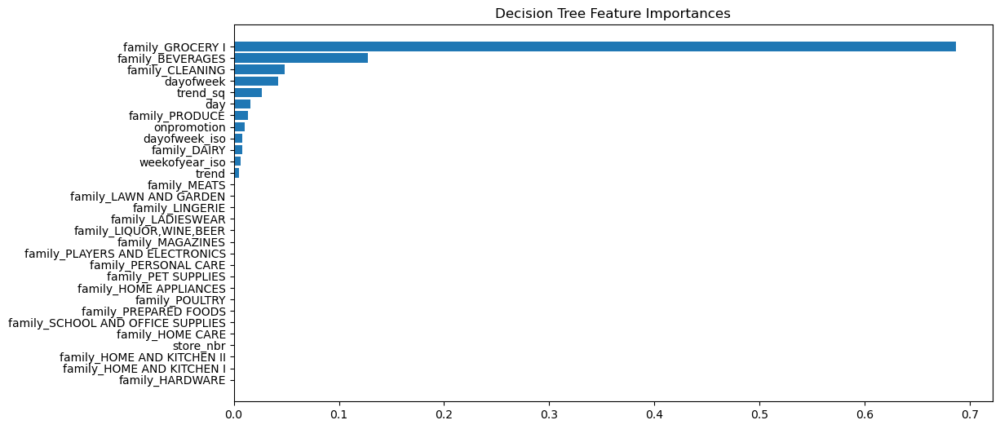


training performance

R² Score: 0.89
RMSE: 363.57
MAE: 153.67

test performance

R² Score: 0.91
RMSE: 378.39
MAE: 175.72


In [ ]:
y_fit_all,y_pred_all, y_test_reals_all=  apply_func_each_store(X_train, X_test,y_train,y_test, X_test_real,func=dtree)

In [ ]:
(r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train, y_fit_all, y_test, y_pred_all)


training performance

R² Score: 0.89
RMSE: 363.57
MAE: 153.67

test performance

R² Score: 0.91
RMSE: 378.39
MAE: 175.72


In [ ]:
y_test_reals_all.rename(columns={0:'sales'}).to_csv("dtree_per_family.csv")
# !kaggle competitions submit -c store-sales-time-series-forecasting -f dtree_per_family.csv -m "dtree per family"

## Random Forest Regressor

In [ ]:
from sklearn.ensemble import RandomForestRegressor
def rf(X_train_1, X_test_1, y_train_1, y_test_1, X_test_real_1):
    rf = RandomForestRegressor(max_depth=7, random_state=0)
    rf.fit(X_train_1, y_train_1)
    y_pred_rf = pd.DataFrame(rf.predict(X_test_1),index=X_test_1.index)
    y_fit_rf = pd.DataFrame(rf.predict(X_train_1), index=X_train_1.index)
    (r2_train,rmse_train,mae_train), (r2_test,rmse_test,mae_test) = performance_both(y_train_1, y_fit_rf, y_test_1, y_pred_rf)

    rf_importances = pd.DataFrame(rf.feature_importances_, 
                                  index=X_train_1.columns, 
                                  columns=['importance']).sort_values('importance', ascending=False)
    plt.figure(figsize=(12, 6))
    plt.title("Random Forest Feature Importances")
    plt.barh(rf_importances.index[:30], rf_importances['importance'][:30])
    plt.gca().invert_yaxis()
    plt.show()
    y_pred_test_real = rf.predict(X_test_real_1)
    y_pred_test_real =  pd.DataFrame(y_pred_test_real, index=X_test_real_1.index)
    return y_fit_rf, y_pred_rf, y_pred_test_real



training performance

R² Score: 0.93
RMSE: 158.04
MAE: 79.15

test performance

R² Score: 0.94
RMSE: 165.42
MAE: 85.74


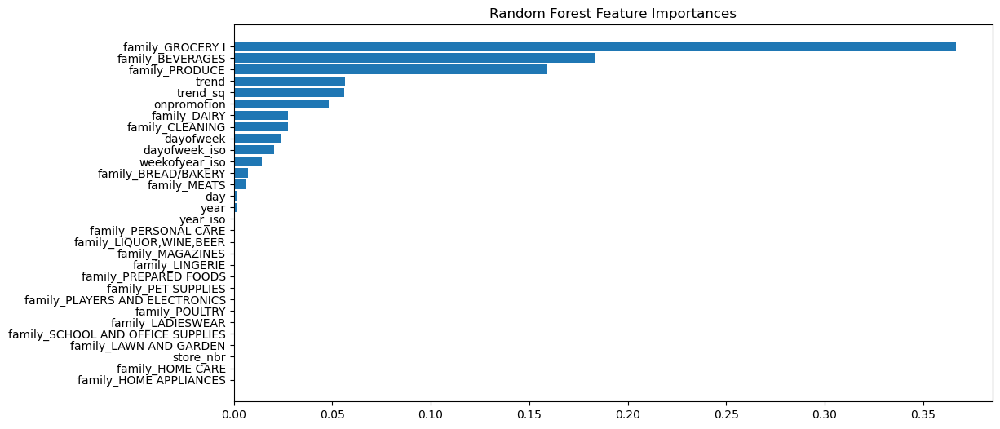


training performance

R² Score: 0.96
RMSE: 92.16
MAE: 49.94

test performance

R² Score: 0.90
RMSE: 180.22
MAE: 75.16


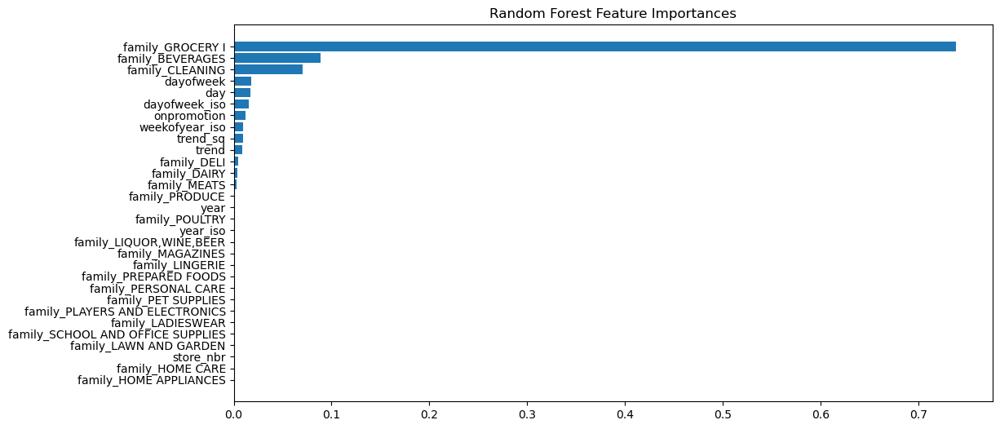


training performance

R² Score: 0.96
RMSE: 260.27
MAE: 144.29

test performance

R² Score: 0.97
RMSE: 300.35
MAE: 152.13


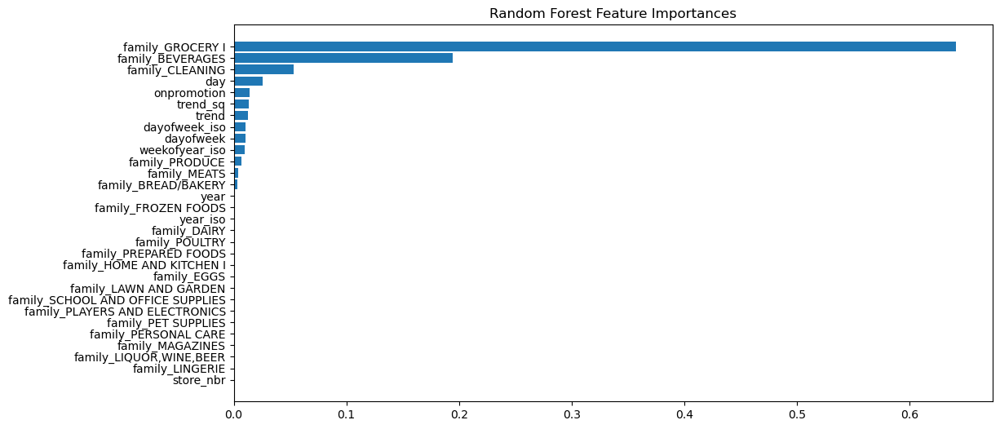


training performance

R² Score: 0.94
RMSE: 126.00
MAE: 57.11

test performance

R² Score: 0.81
RMSE: 256.29
MAE: 86.41


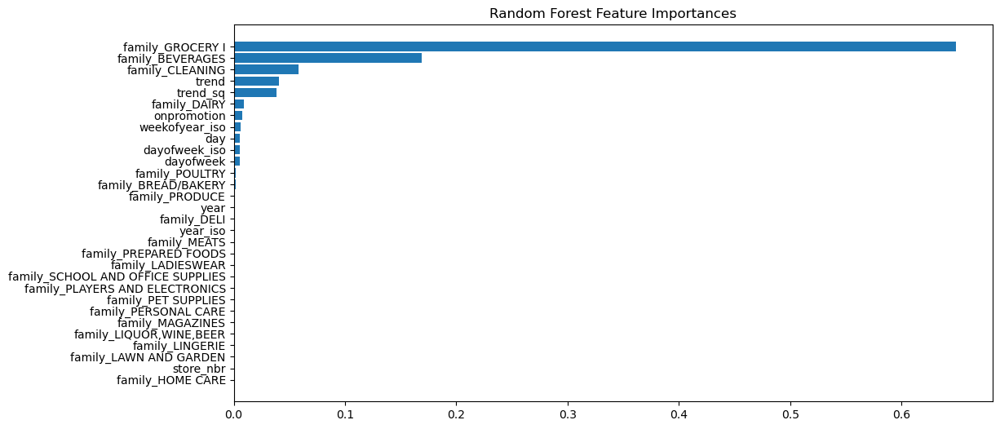


training performance

R² Score: 0.95
RMSE: 125.86
MAE: 53.37

test performance

R² Score: 0.93
RMSE: 160.77
MAE: 58.99


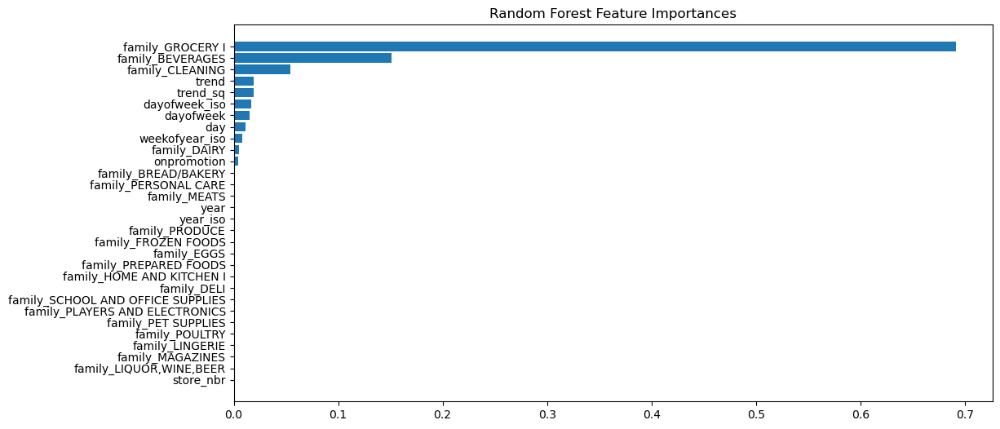


training performance

R² Score: 0.94
RMSE: 130.26
MAE: 65.14

test performance

R² Score: 0.69
RMSE: 368.15
MAE: 120.38


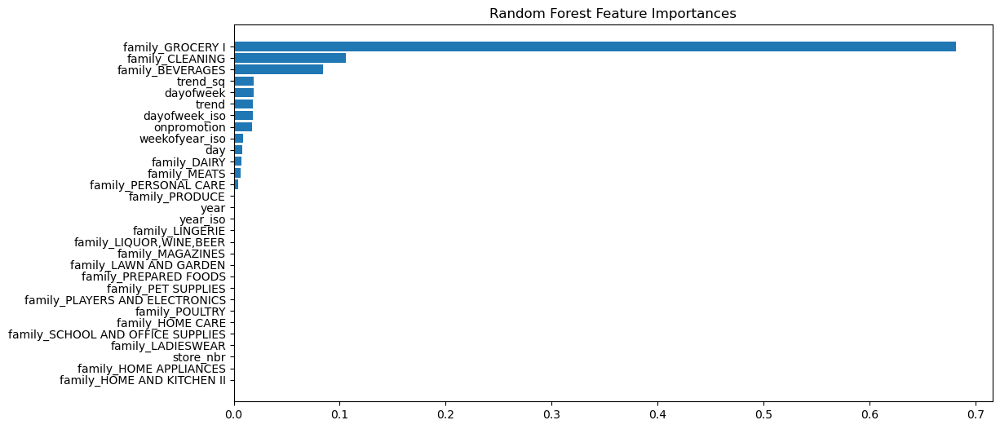


training performance

R² Score: 0.96
RMSE: 114.28
MAE: 56.74

test performance

R² Score: 0.97
RMSE: 103.53
MAE: 59.60


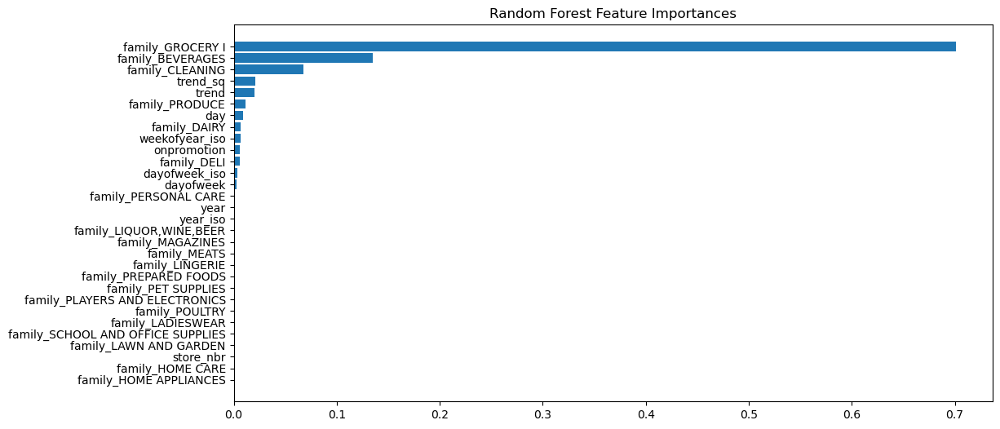


training performance

R² Score: 0.94
RMSE: 126.97
MAE: 61.89

test performance

R² Score: 0.90
RMSE: 152.29
MAE: 70.34


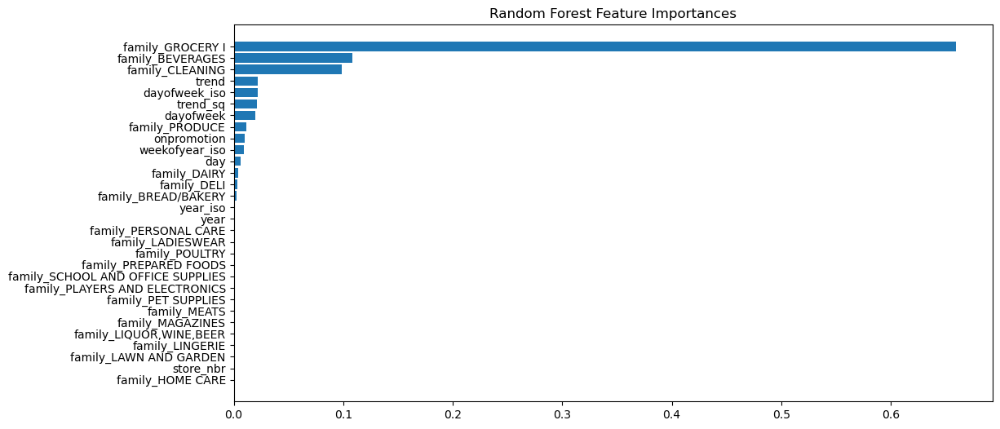


training performance

R² Score: 0.96
RMSE: 174.98
MAE: 95.35

test performance

R² Score: 0.96
RMSE: 189.89
MAE: 103.96


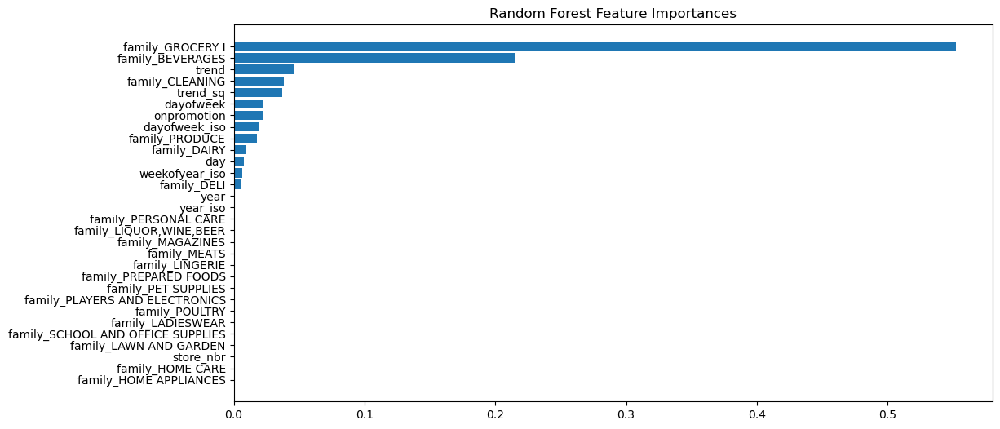


training performance

R² Score: 0.92
RMSE: 172.74
MAE: 77.42

test performance

R² Score: 0.95
RMSE: 153.47
MAE: 84.06


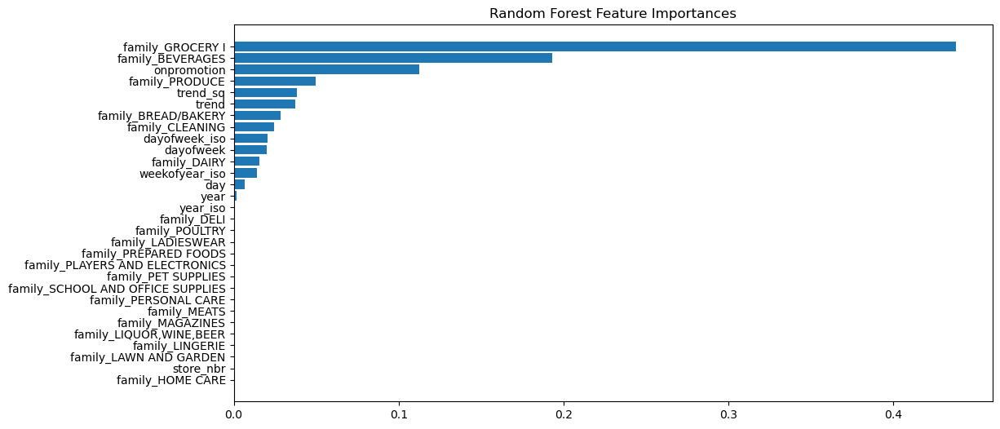


training performance

R² Score: 0.96
RMSE: 128.13
MAE: 65.13

test performance

R² Score: 0.97
RMSE: 132.63
MAE: 65.47


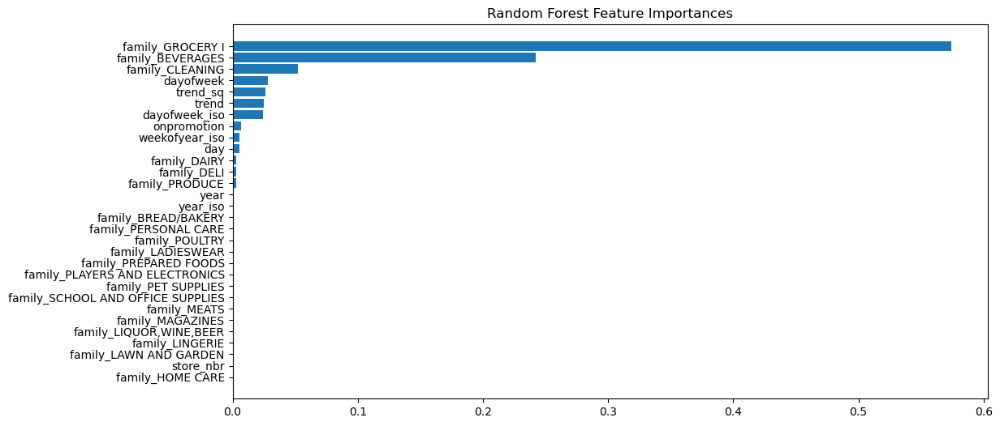


training performance

R² Score: 0.90
RMSE: 349.03
MAE: 119.94

test performance

R² Score: 0.92
RMSE: 246.76
MAE: 133.73


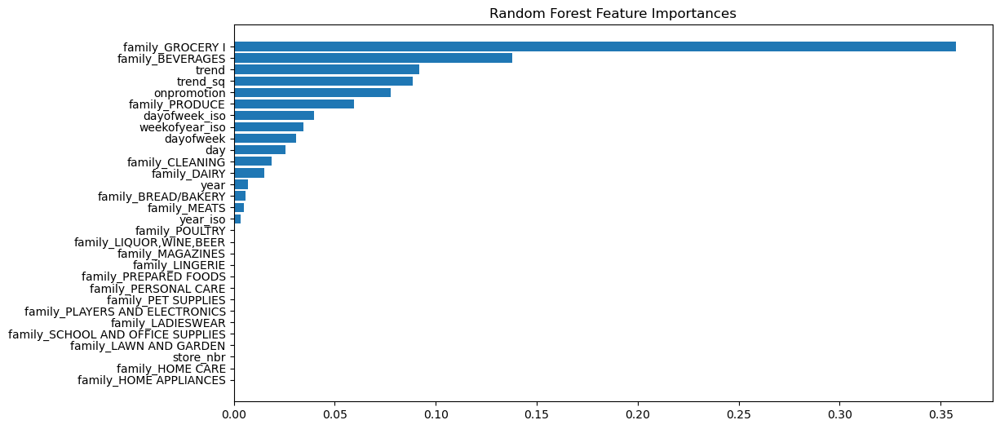


training performance

R² Score: 0.86
RMSE: 363.91
MAE: 87.38

test performance

R² Score: 0.88
RMSE: 478.13
MAE: 215.91


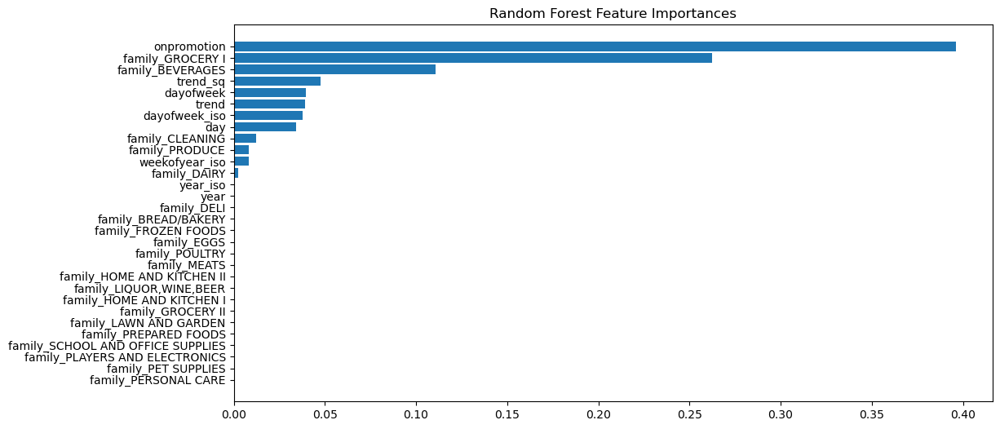


training performance

R² Score: 0.95
RMSE: 148.52
MAE: 51.60

test performance

R² Score: 0.88
RMSE: 372.88
MAE: 163.92


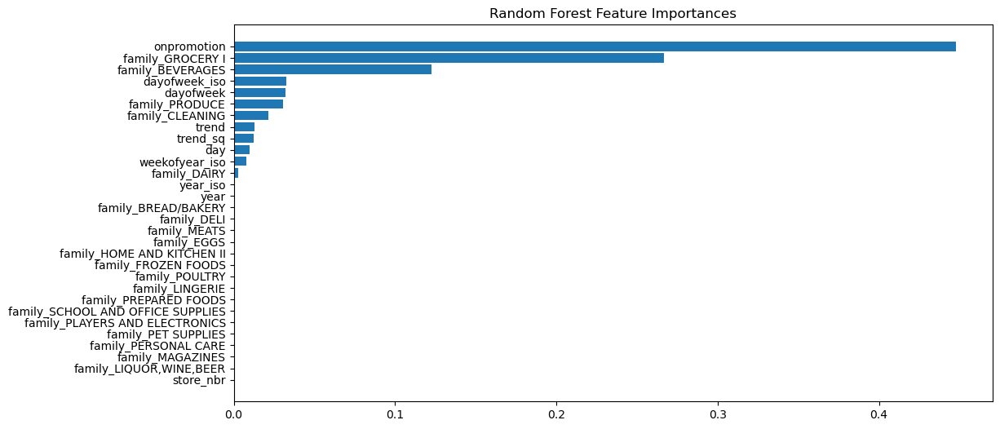


training performance

R² Score: 0.96
RMSE: 64.65
MAE: 20.81

test performance

R² Score: 0.93
RMSE: 152.19
MAE: 75.33


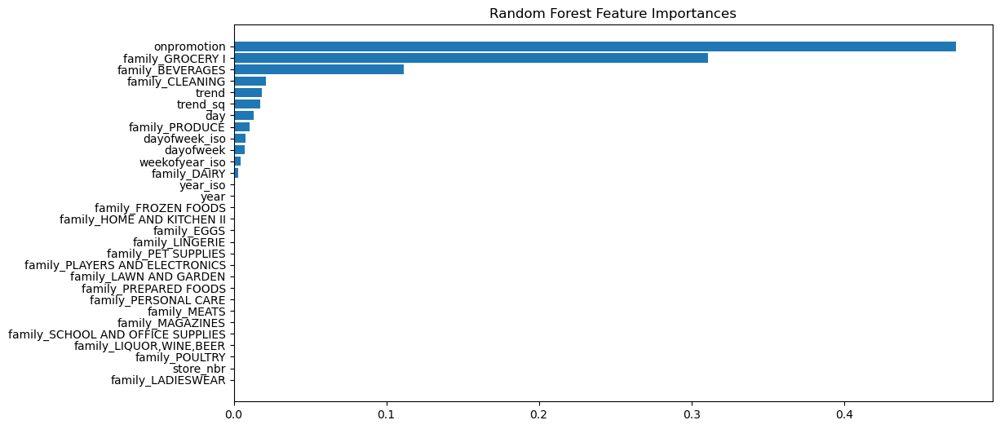


training performance

R² Score: 0.92
RMSE: 127.44
MAE: 67.05

test performance

R² Score: 0.94
RMSE: 110.98
MAE: 66.79


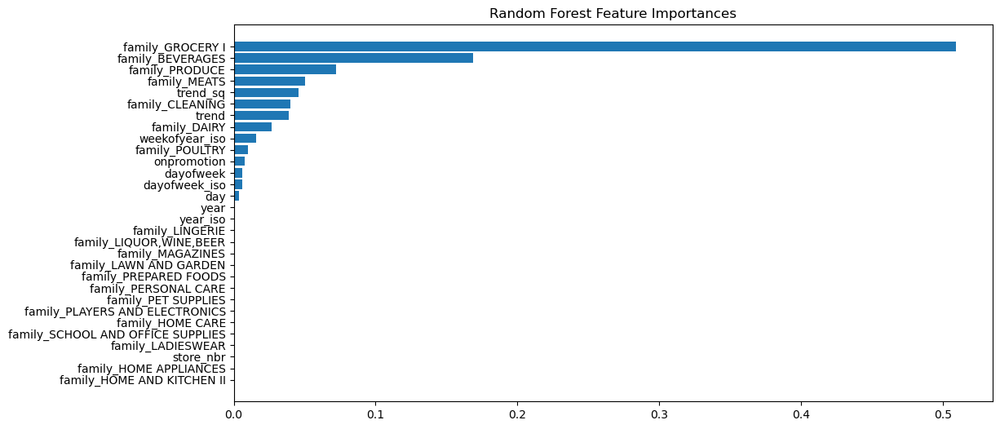


training performance

R² Score: 0.94
RMSE: 243.12
MAE: 124.26

test performance

R² Score: 0.97
RMSE: 179.99
MAE: 118.45


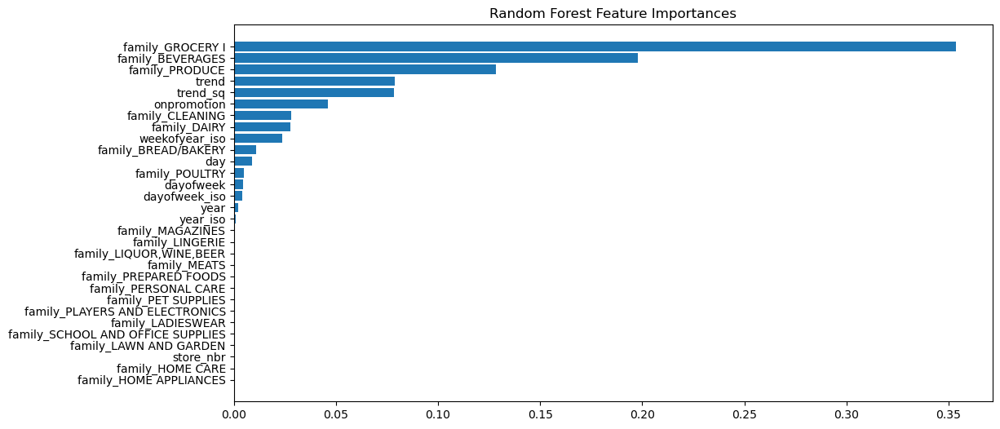


training performance

R² Score: 0.86
RMSE: 209.98
MAE: 85.46

test performance

R² Score: 0.76
RMSE: 331.67
MAE: 117.75


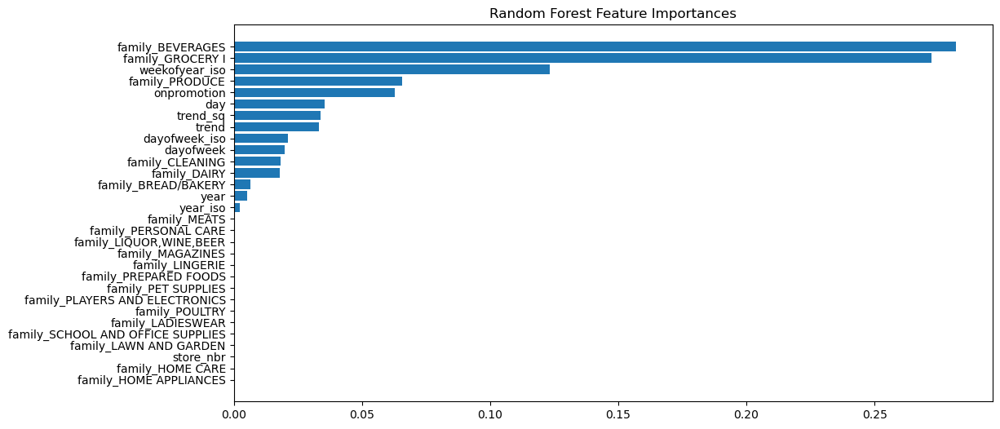


training performance

R² Score: 0.87
RMSE: 150.67
MAE: 54.36

test performance

R² Score: 0.91
RMSE: 96.65
MAE: 52.22


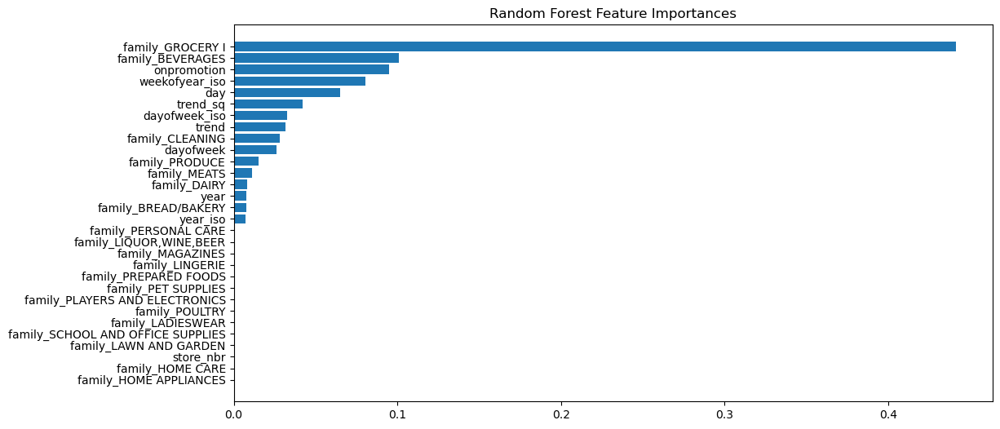


training performance

R² Score: 0.95
RMSE: 182.63
MAE: 103.98

test performance

R² Score: 0.96
RMSE: 188.29
MAE: 118.91


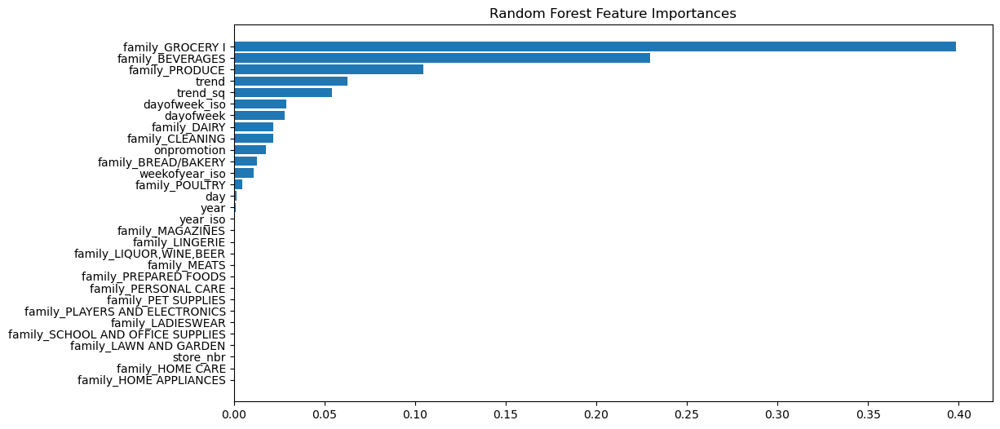


training performance

R² Score: 0.94
RMSE: 214.83
MAE: 108.25

test performance

R² Score: 0.92
RMSE: 361.21
MAE: 140.06


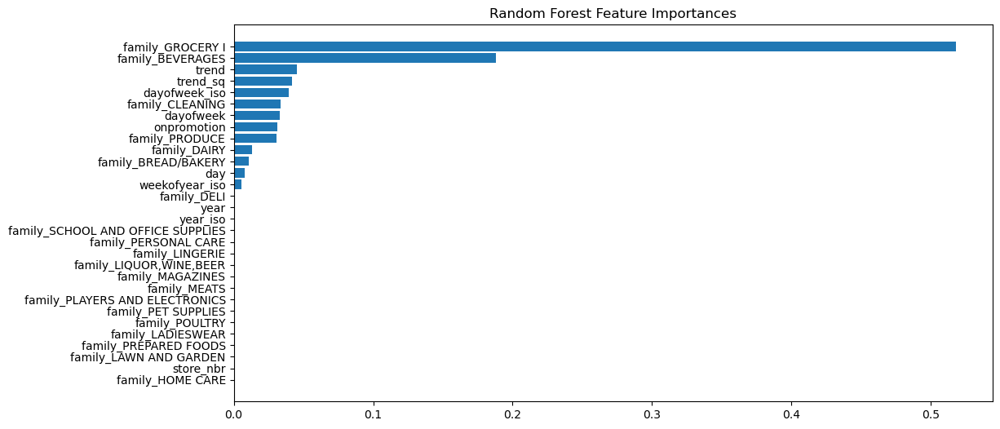


training performance

R² Score: 0.95
RMSE: 141.23
MAE: 54.07

test performance

R² Score: 0.95
RMSE: 208.24
MAE: 109.82


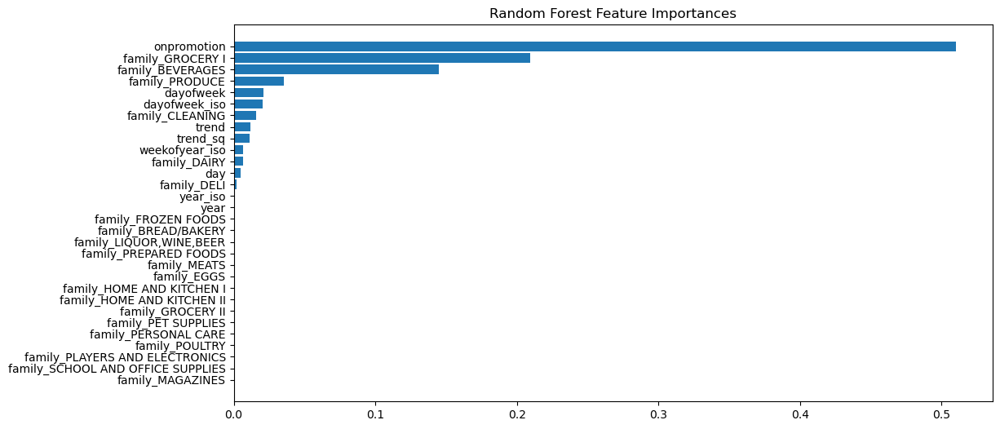


training performance

R² Score: 0.95
RMSE: 462.53
MAE: 252.86

test performance

R² Score: 0.94
RMSE: 540.90
MAE: 269.22


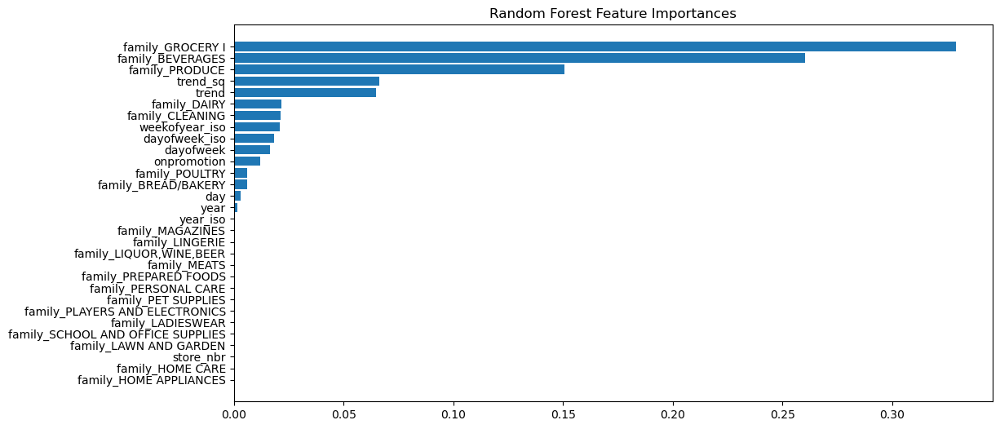


training performance

R² Score: 0.93
RMSE: 94.47
MAE: 42.66

test performance

R² Score: 0.81
RMSE: 227.34
MAE: 77.36


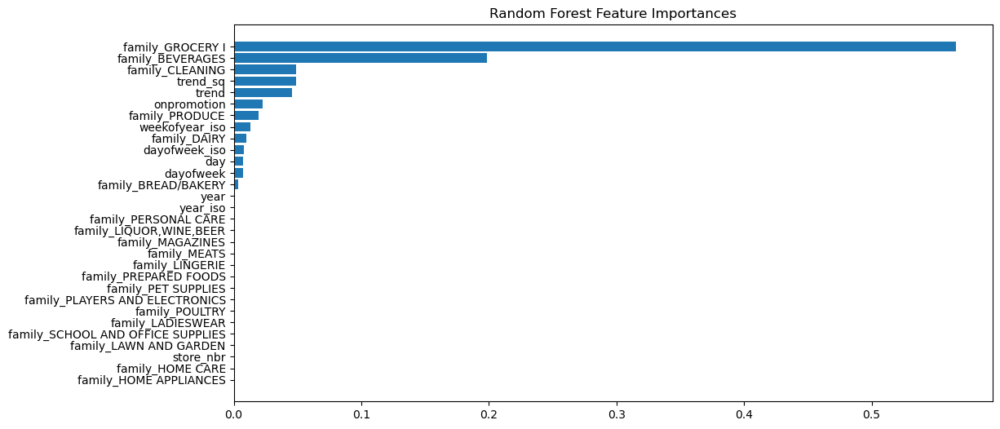


training performance

R² Score: 0.95
RMSE: 186.23
MAE: 97.37

test performance

R² Score: 0.95
RMSE: 253.17
MAE: 114.15


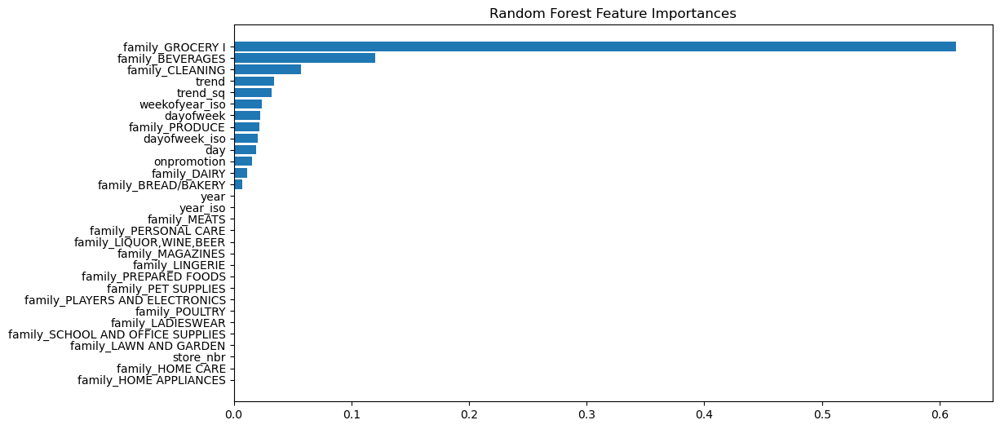


training performance

R² Score: 0.90
RMSE: 106.35
MAE: 38.55

test performance

R² Score: 0.59
RMSE: 270.87
MAE: 82.93


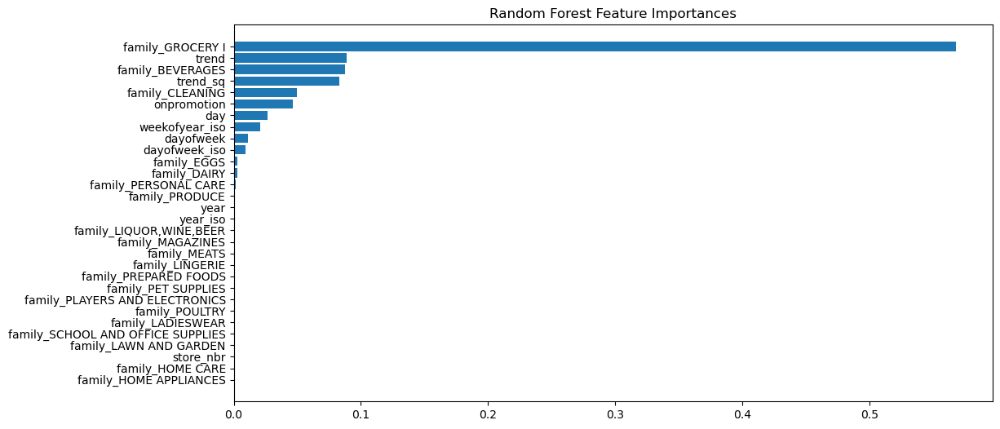


training performance

R² Score: 0.94
RMSE: 157.08
MAE: 82.77

test performance

R² Score: 0.93
RMSE: 189.96
MAE: 84.84


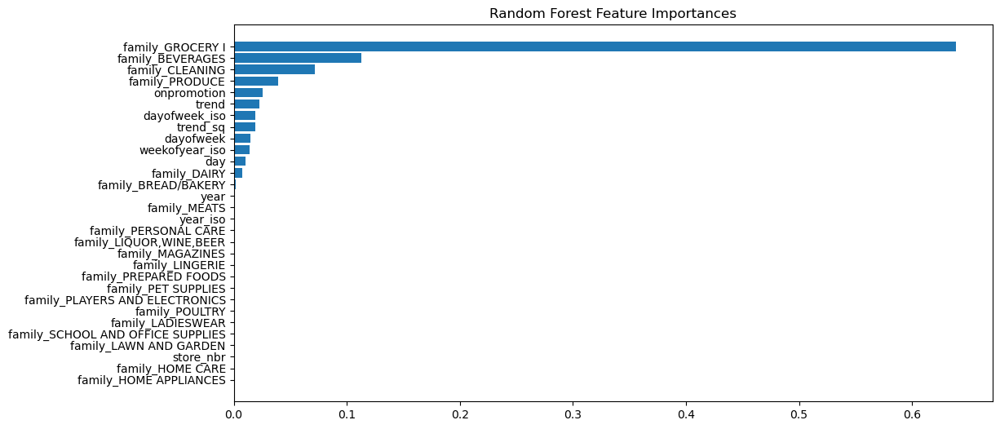


training performance

R² Score: 0.96
RMSE: 161.51
MAE: 85.54

test performance

R² Score: 0.97
RMSE: 145.10
MAE: 81.97


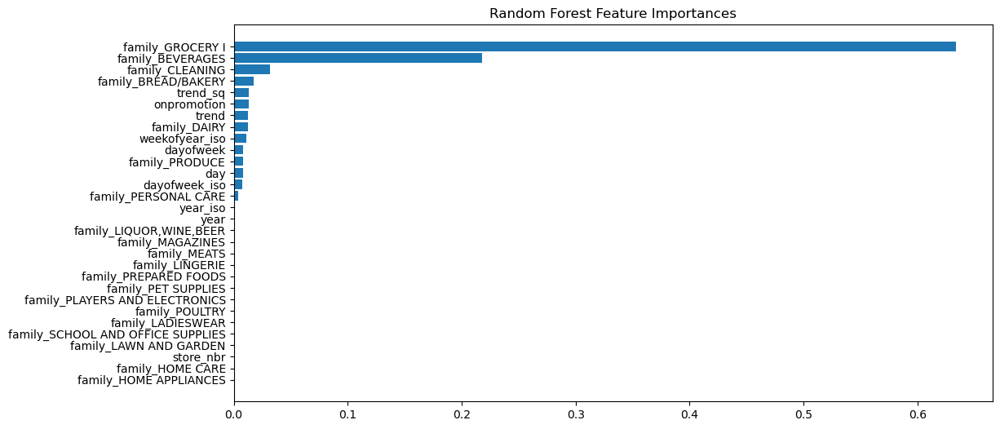


training performance

R² Score: 0.91
RMSE: 140.37
MAE: 44.19

test performance

R² Score: 0.95
RMSE: 97.48
MAE: 42.75


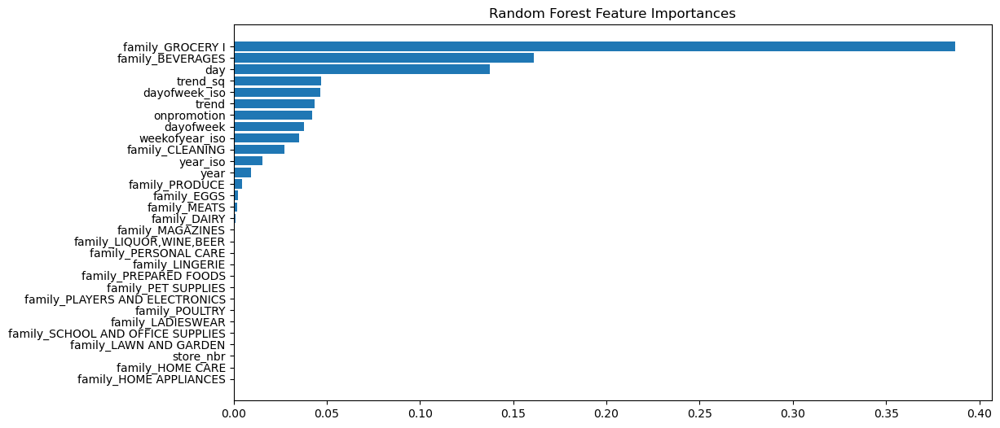


training performance

R² Score: 0.95
RMSE: 170.39
MAE: 82.47

test performance

R² Score: 0.92
RMSE: 290.47
MAE: 114.98


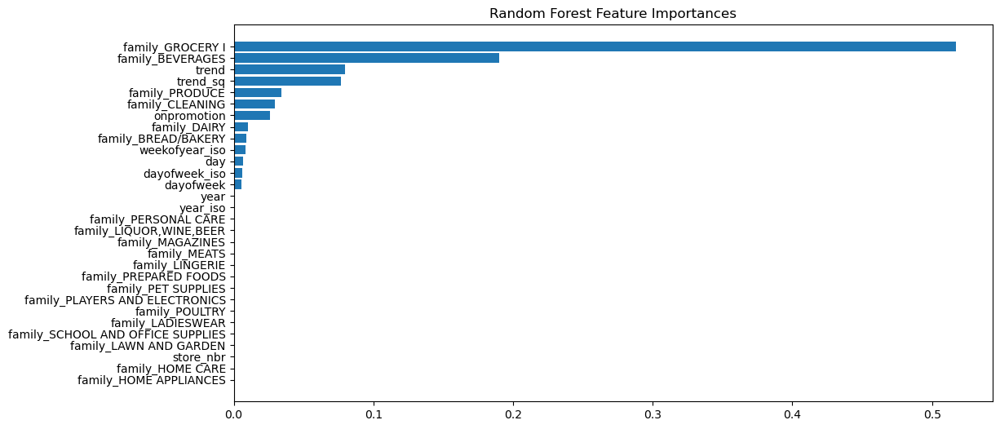


training performance

R² Score: 0.95
RMSE: 187.33
MAE: 96.11

test performance

R² Score: 0.93
RMSE: 215.99
MAE: 112.78


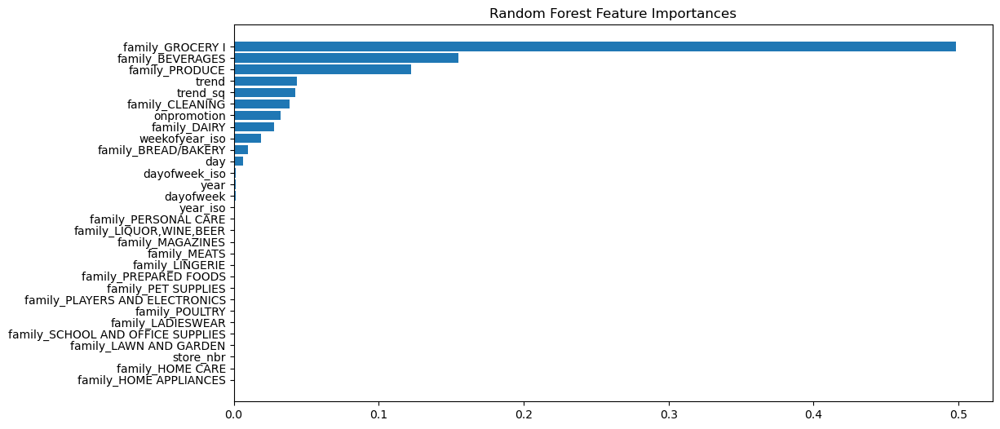


training performance

R² Score: 0.93
RMSE: 214.76
MAE: 97.53

test performance

R² Score: 0.74
RMSE: 439.15
MAE: 157.55


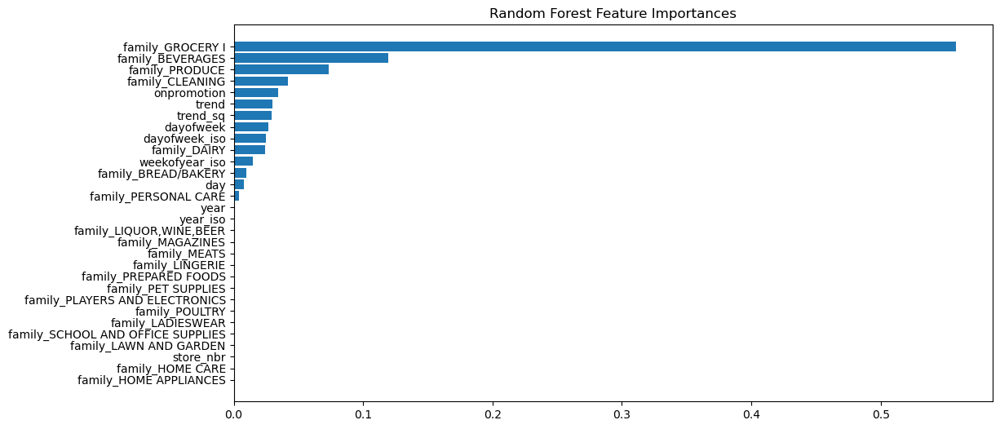


training performance

R² Score: 0.80
RMSE: 446.82
MAE: 110.57

test performance

R² Score: 0.81
RMSE: 529.06
MAE: 193.61


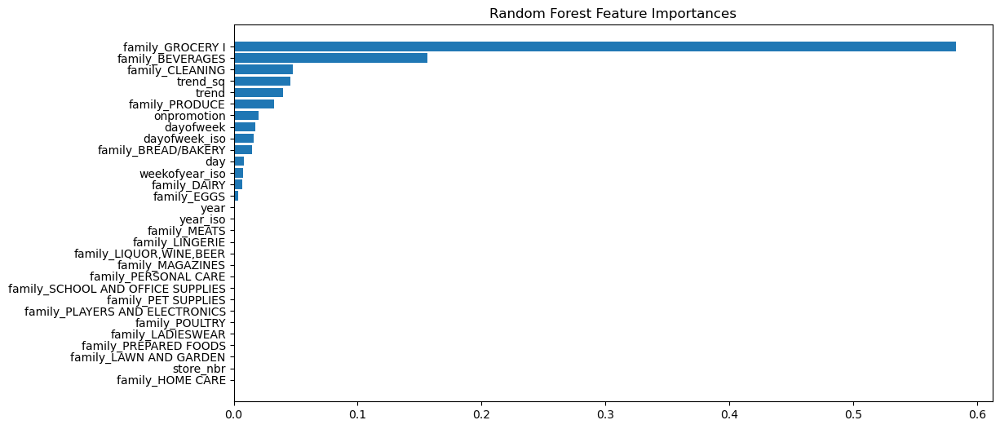


training performance

R² Score: 0.94
RMSE: 188.88
MAE: 104.57

test performance

R² Score: 0.92
RMSE: 222.66
MAE: 117.10


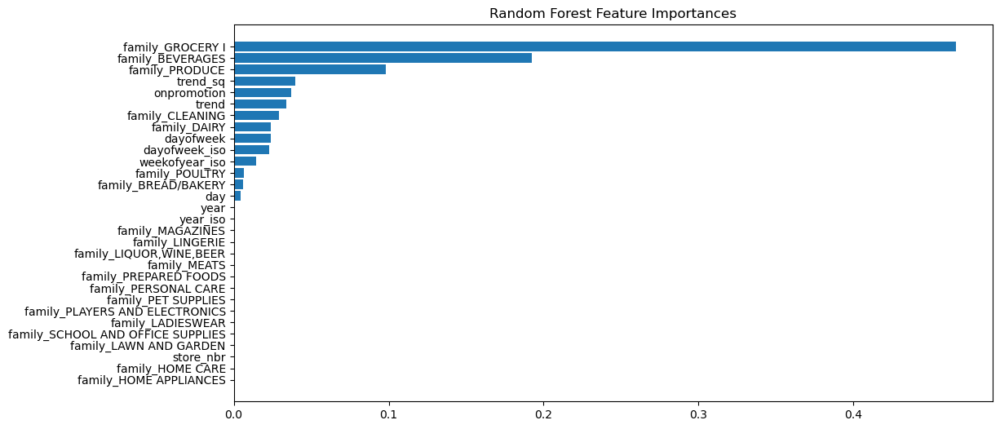


training performance

R² Score: 0.96
RMSE: 185.38
MAE: 87.69

test performance

R² Score: 0.88
RMSE: 505.79
MAE: 176.39


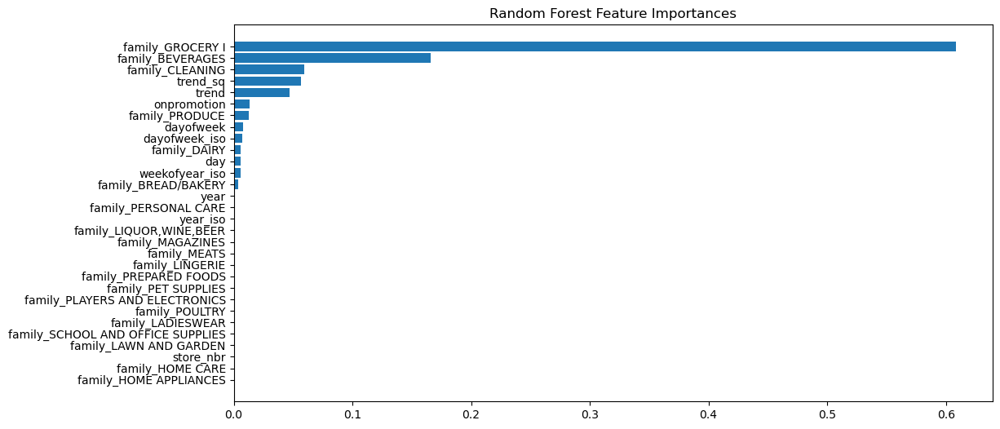


training performance

R² Score: 0.94
RMSE: 165.30
MAE: 79.27

test performance

R² Score: 0.86
RMSE: 321.04
MAE: 133.79


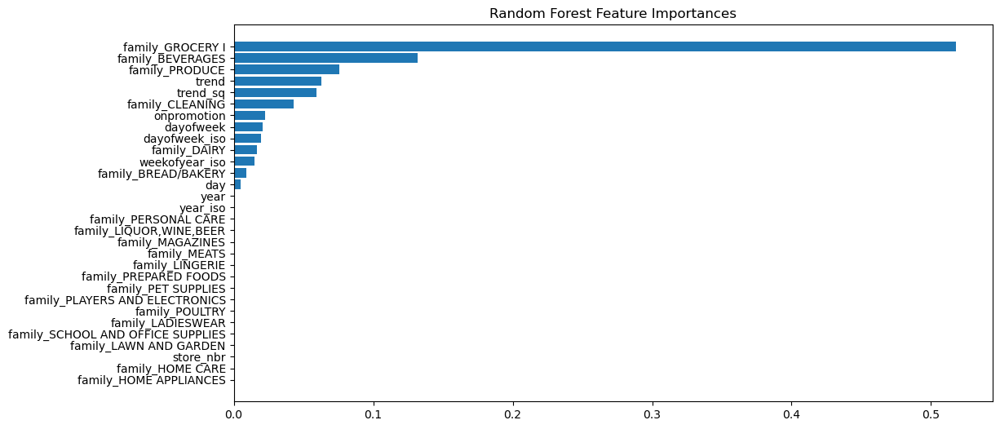


training performance

R² Score: 0.97
RMSE: 106.33
MAE: 38.59

test performance

R² Score: 0.88
RMSE: 266.31
MAE: 115.58


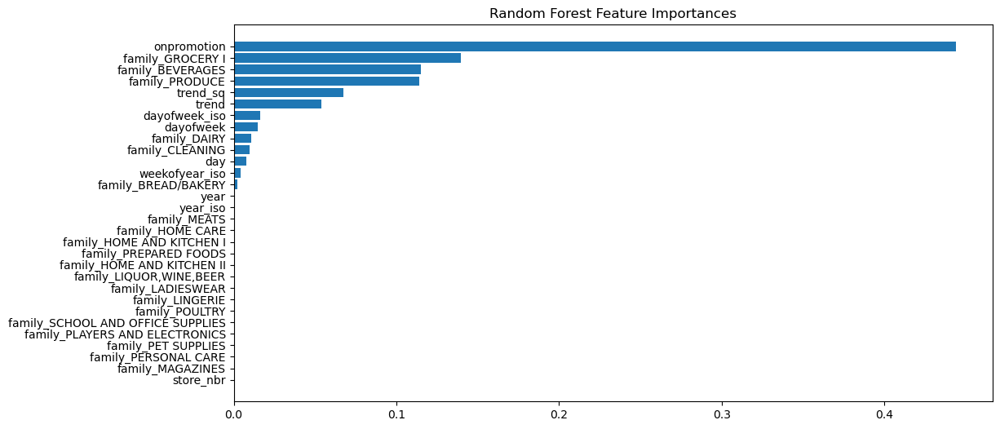


training performance

R² Score: 0.95
RMSE: 173.67
MAE: 83.11

test performance

R² Score: 0.96
RMSE: 241.81
MAE: 117.76


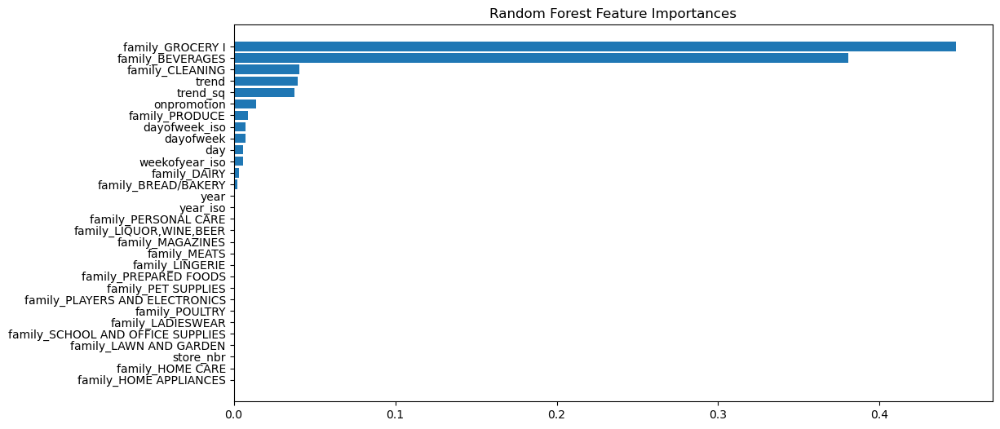


training performance

R² Score: 0.94
RMSE: 667.82
MAE: 335.86

test performance

R² Score: 0.93
RMSE: 700.69
MAE: 350.15


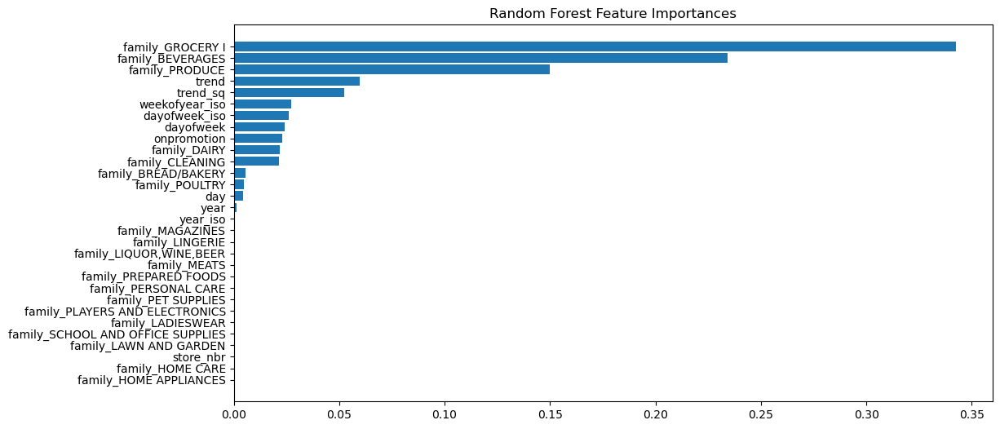


training performance

R² Score: 0.94
RMSE: 601.67
MAE: 304.30

test performance

R² Score: 0.94
RMSE: 618.89
MAE: 339.94


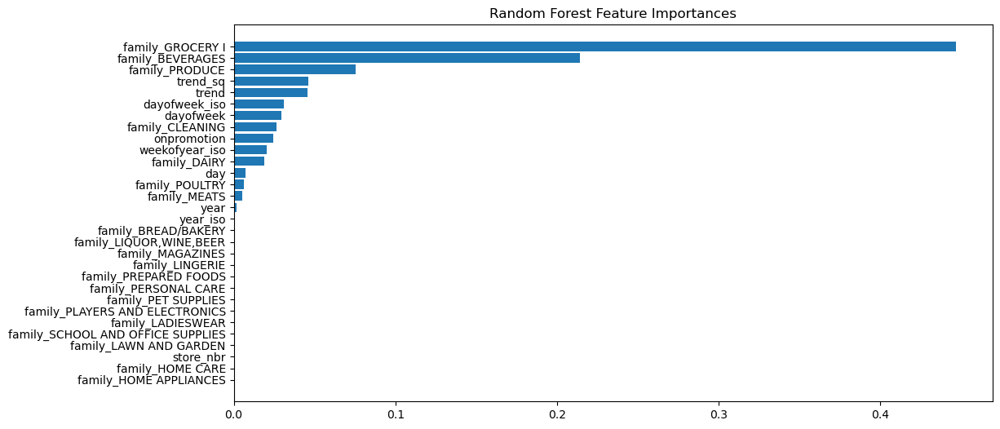


training performance

R² Score: 0.94
RMSE: 460.26
MAE: 255.57

test performance

R² Score: 0.88
RMSE: 685.58
MAE: 320.41


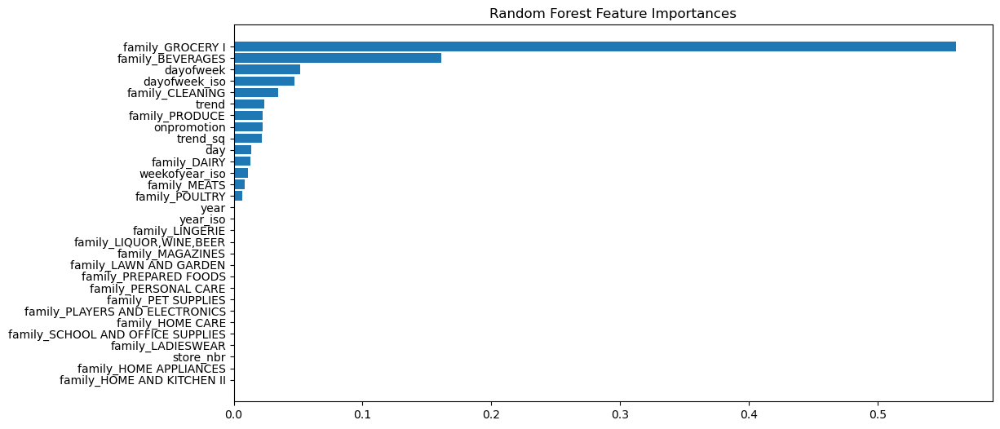


training performance

R² Score: 0.95
RMSE: 495.83
MAE: 276.66

test performance

R² Score: 0.93
RMSE: 641.63
MAE: 316.82


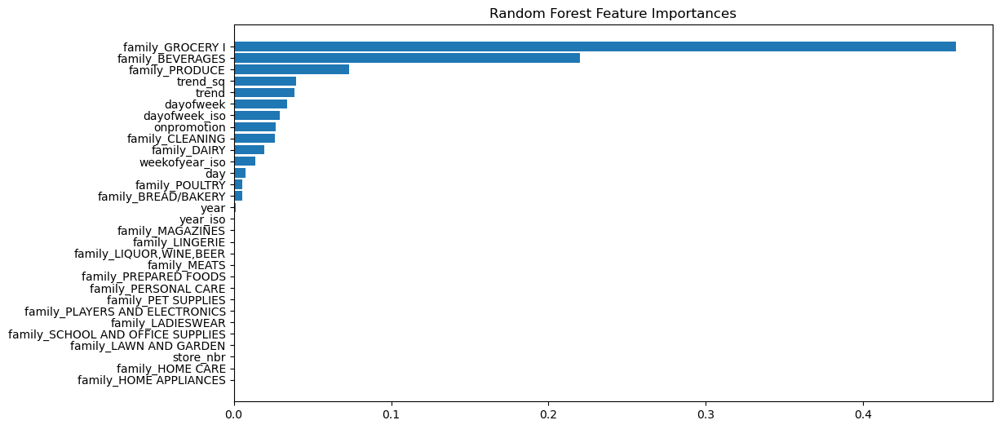


training performance

R² Score: 0.94
RMSE: 400.99
MAE: 214.88

test performance

R² Score: 0.92
RMSE: 502.83
MAE: 261.68


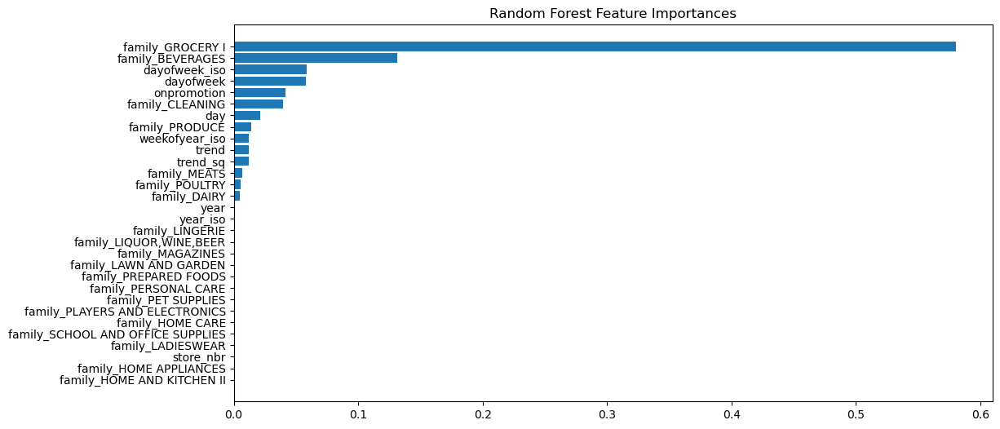


training performance

R² Score: 0.95
RMSE: 427.91
MAE: 231.18

test performance

R² Score: 0.93
RMSE: 537.24
MAE: 281.73


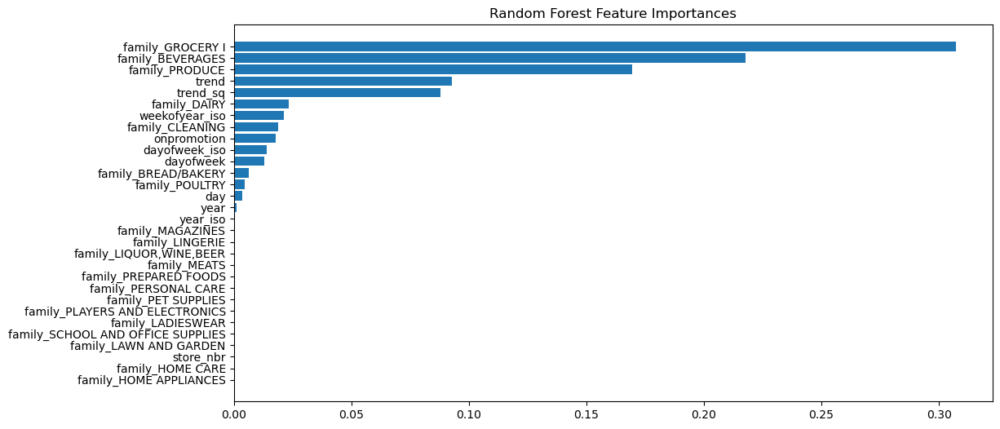


training performance

R² Score: 0.95
RMSE: 151.15
MAE: 85.92

test performance

R² Score: 0.96
RMSE: 128.62
MAE: 78.96


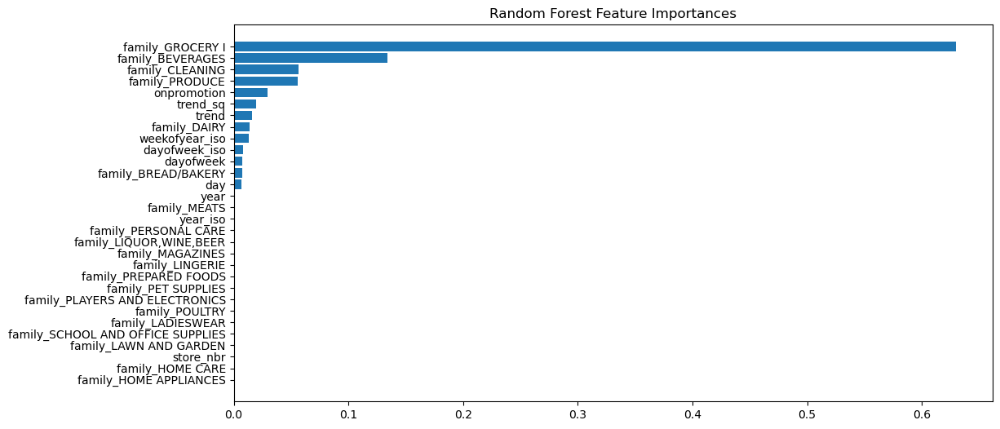


training performance

R² Score: 0.95
RMSE: 279.44
MAE: 152.76

test performance

R² Score: 0.95
RMSE: 328.06
MAE: 173.21


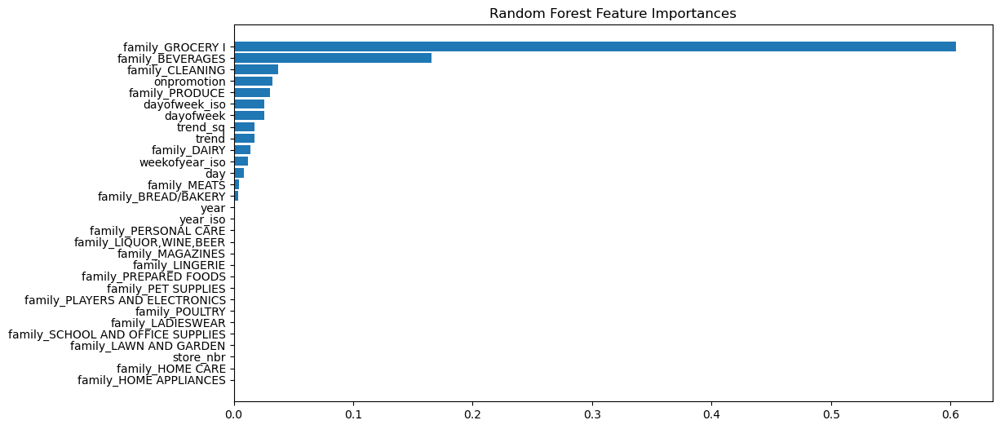


training performance

R² Score: 0.94
RMSE: 333.09
MAE: 175.08

test performance

R² Score: 0.96
RMSE: 286.47
MAE: 171.10


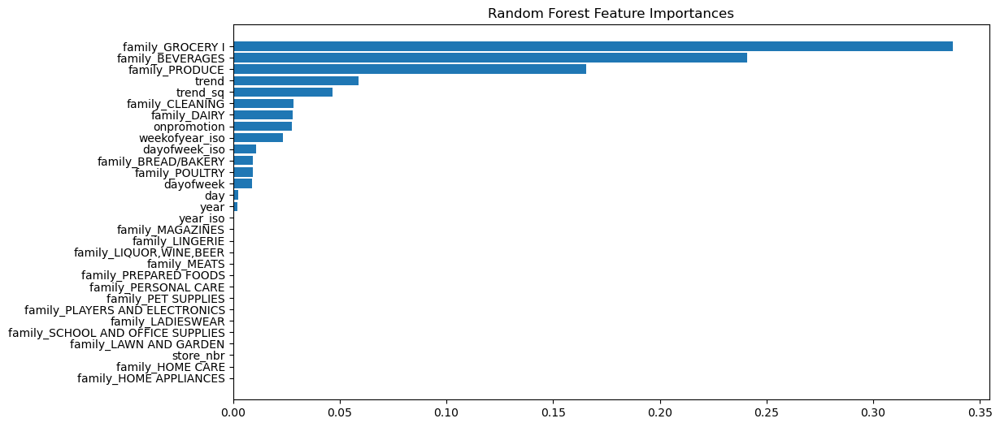


training performance

R² Score: 0.99
RMSE: 47.81
MAE: 7.30

test performance

R² Score: 0.95
RMSE: 334.57
MAE: 158.21


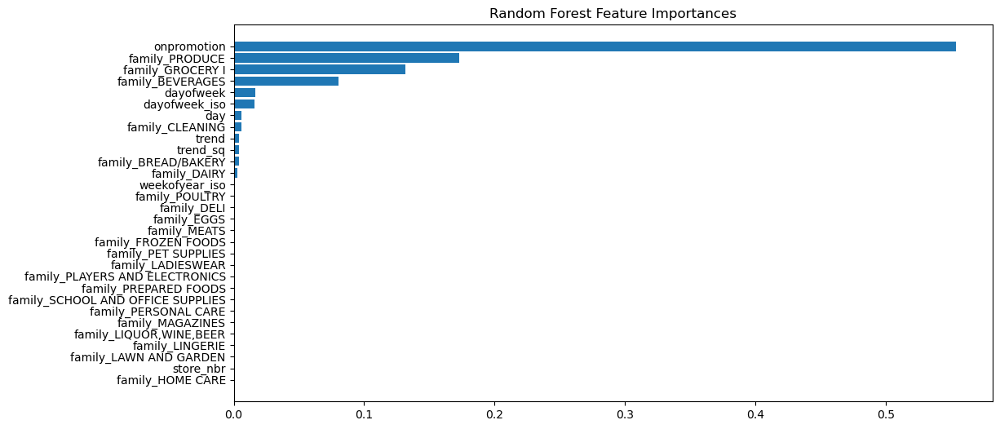


training performance

R² Score: 0.94
RMSE: 144.48
MAE: 63.75

test performance

R² Score: 0.95
RMSE: 159.50
MAE: 93.04


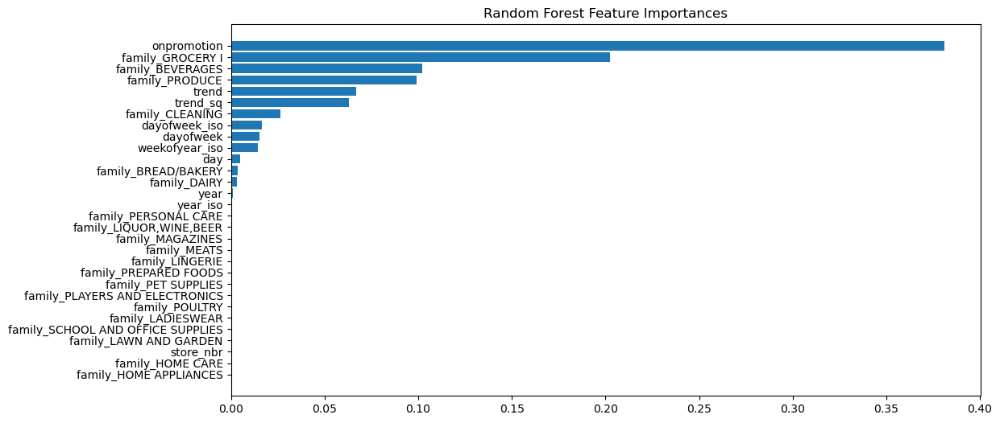


training performance

R² Score: 0.95
RMSE: 128.98
MAE: 53.55

test performance

R² Score: 0.88
RMSE: 338.25
MAE: 101.76


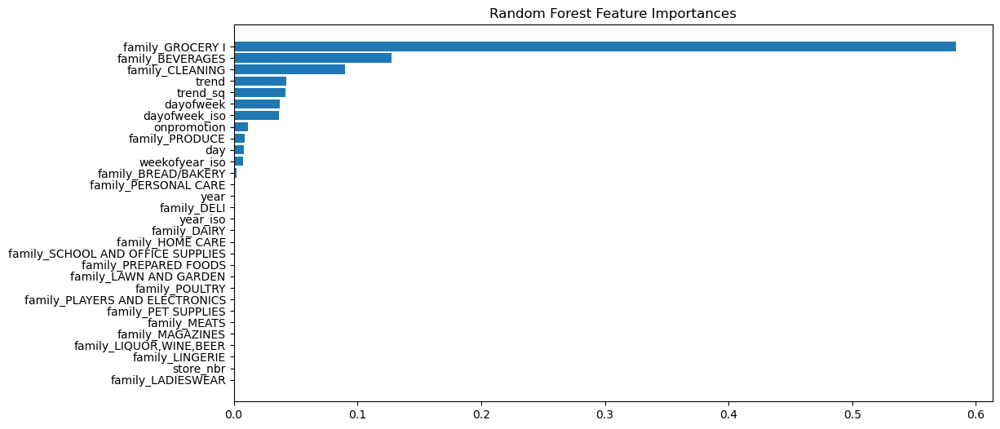


training performance

R² Score: 0.95
RMSE: 232.66
MAE: 136.64

test performance

R² Score: 0.93
RMSE: 281.31
MAE: 146.38


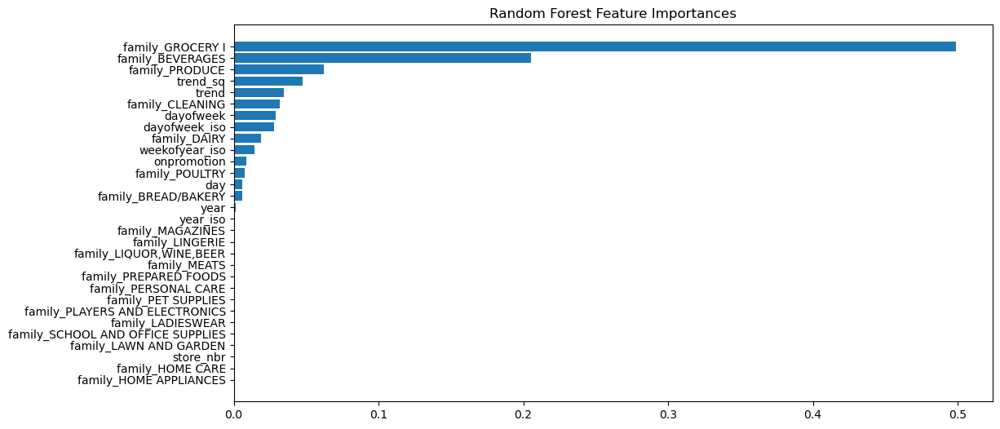


training performance

R² Score: 0.95
RMSE: 245.32
MAE: 134.27

test performance

R² Score: 0.96
RMSE: 251.33
MAE: 151.64


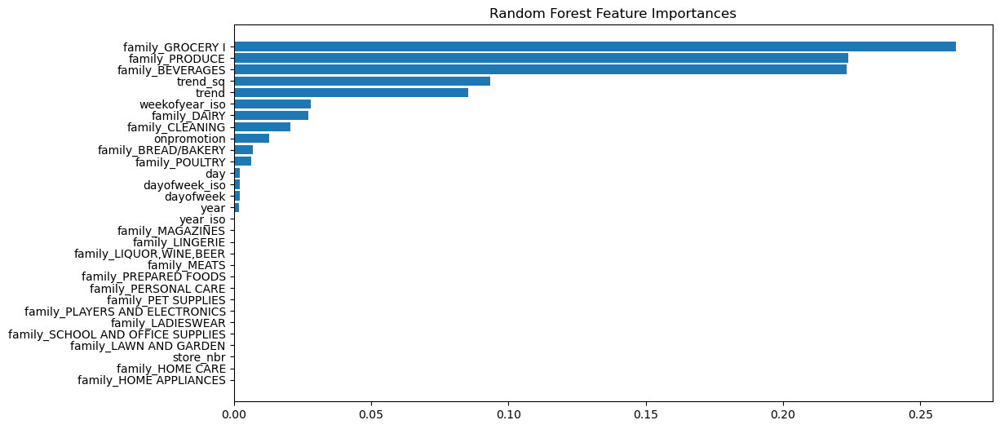


training performance

R² Score: 0.95
RMSE: 286.32
MAE: 156.95

test performance

R² Score: 0.95
RMSE: 302.47
MAE: 161.40


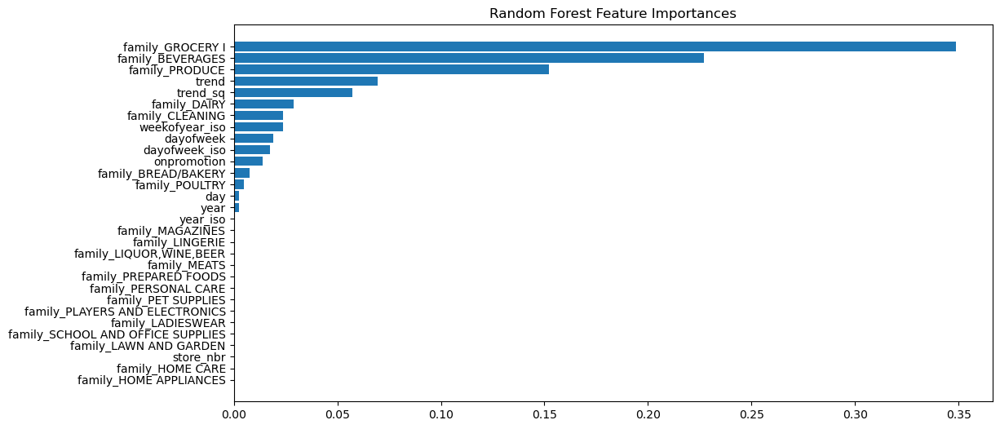


training performance

R² Score: 0.95
RMSE: 272.47
MAE: 146.85

test performance

R² Score: 0.95
RMSE: 320.76
MAE: 164.16


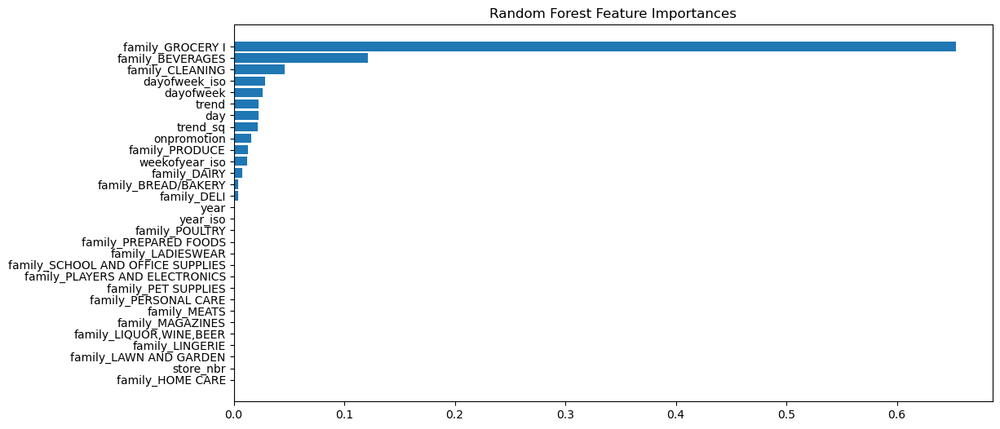


training performance

R² Score: 0.94
RMSE: 261.69
MAE: 108.11

test performance

R² Score: 0.93
RMSE: 335.97
MAE: 139.60


In [ ]:
y_fit_all,y_pred_all,y_pred_test_real=  apply_func_each_store(X_train, X_test,y_train,y_test, X_test_real, func=rf)

In [ ]:
(r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train, y_fit_all, y_test, y_pred_all)


training performance

R² Score: 0.94
RMSE: 261.69
MAE: 108.11

test performance

R² Score: 0.93
RMSE: 335.97
MAE: 139.60


In [ ]:
y_pred_test_real

,0
id,
3000888,46.843886
3000889,46.843886
3000890,46.843886
3000891,2361.454385
3000892,46.843886
...,...
3029395,88.168185
3029396,84.118444
3029397,1328.903551


In [ ]:
y_pred_test_real.rename(columns={0:'sales'}).to_csv("rf_per_family.csv")
# !kaggle competitions submit -c store-sales-time-series-forecasting -f rf_per_family.csv -m "random forest per family"

100%|████████████████████████████████████████| 735k/735k [00:00<00:00, 1.76MB/s]
Successfully submitted to Store Sales - Time Series Forecasting

## XGBoost

In [ ]:
from xgboost.sklearn import XGBRegressor
def xgb_predictor(X_train_1, X_test_1, y_train_1, y_test_1,X_test_real_1):
    xgb_sklearn = XGBRegressor(max_depth= 6, # How deep should each tree be?
            eta= 0.1, # The learning rate: how big are our steps?
            verbosity= 0, # Whether to print out messages as you fit. 1 makes it quiet
            objective='reg:squarederror', # What is our loss function? For now, logistic - outputs probability. Would change for multiclass
            gamma= 1, # Minimum loss reduction
            subsample= 1, # How much to subsample for each tree. Smaller number (like 0.5) would subsample
            colsample_bytree=1, # like the random forest restriction on variables, sample of columns to get
            lam=0, # How much L2 penalty on the node weights
            alpha=0, # How much L1 penalty on the node weights
            eval_metric='mae', # this is the default eval_metric for logistic 
            min_child_weight = 1,# Minimum sum of instance weights (hessian) in a child. 
            seed= 1).fit(X_train_1, y_train_1)

    y_pred_all = xgb_sklearn.predict(X_test_1)
    y_pred_all_train = xgb_sklearn.predict(X_train_1)
    (r2_train,rmse_train,mae_train), (r2_test,rmse_test,mae_test) = performance_both(y_train_1, y_pred_all_train, y_test_1, y_pred_all)

    y_fit_train = pd.DataFrame(y_pred_all_train, index=X_train_1.index)
    y_pred_test = pd.DataFrame(y_pred_all, index=X_test_1.index)
    plot_pred_vs_actual(y_pred_all_train, y_train_1['sales'])

    dtree_importance = pd.DataFrame(xgb_sklearn.feature_importances_, 
                                    index=X_train_1.columns, 
                                    columns=['importance']).sort_values('importance', ascending=False)
    plt.figure(figsize=(12, 6))
    plt.title("XGBoost Feature Importances")
    plt.barh(dtree_importance.index[:30], dtree_importance['importance'][:30])
    plt.gca().invert_yaxis()
    plt.show()
    y_pred_test_real = xgb_sklearn.predict(X_test_real_1)
    y_pred_test_real =  pd.DataFrame(y_pred_test_real, index=X_test_real_1.index)
    return y_fit_train, y_pred_test, y_pred_test_real

In [ ]:
# from sklearn.model_selection import GridSearchCV 
# param_grid1 = {
#     'max_depth': range(2, 10, 2),
#     'min_child_weight': range(1, 6, 2),
#     'gamma': np.arange(0, 1, 0.5),
#     'subsample': np.arange(0,1,0.3)

# }

# grid_search = GridSearchCV(estimator = xgb_sklearn, param_grid = param_grid1, 
#                            scoring = 'neg_mean_squared_error', cv = 5).fit(X, y)


training performance

R² Score: 0.97
RMSE: 105.09
MAE: 37.96

test performance

R² Score: 0.96
RMSE: 138.22
MAE: 52.29


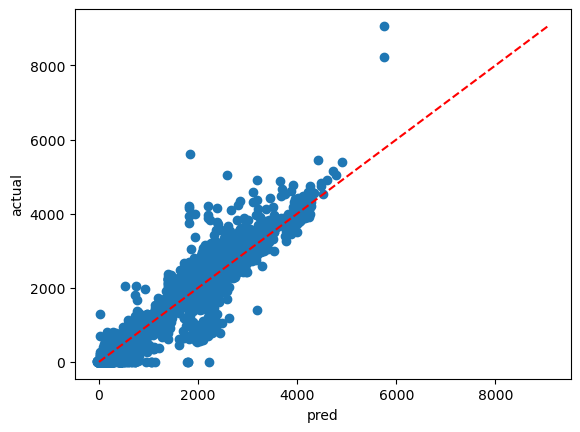

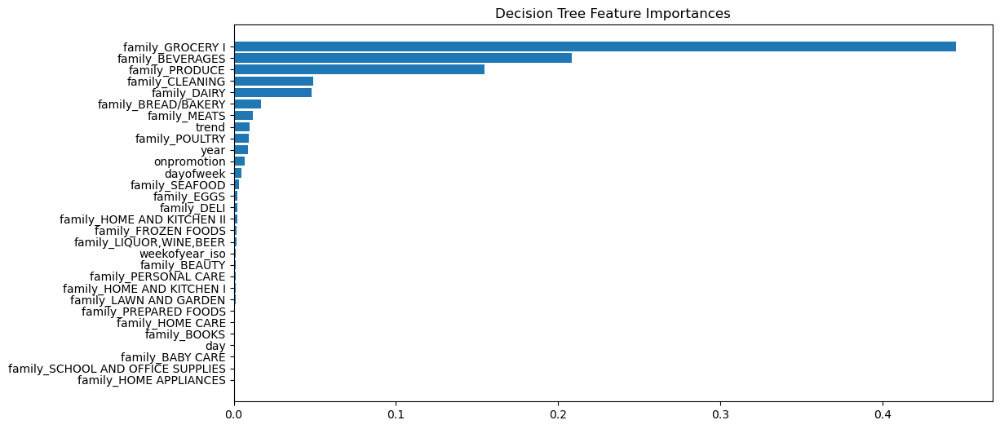


training performance

R² Score: 0.98
RMSE: 59.56
MAE: 22.91

test performance

R² Score: 0.95
RMSE: 121.30
MAE: 40.51


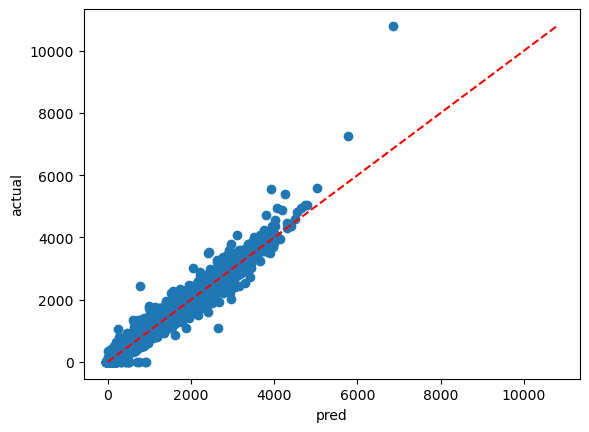

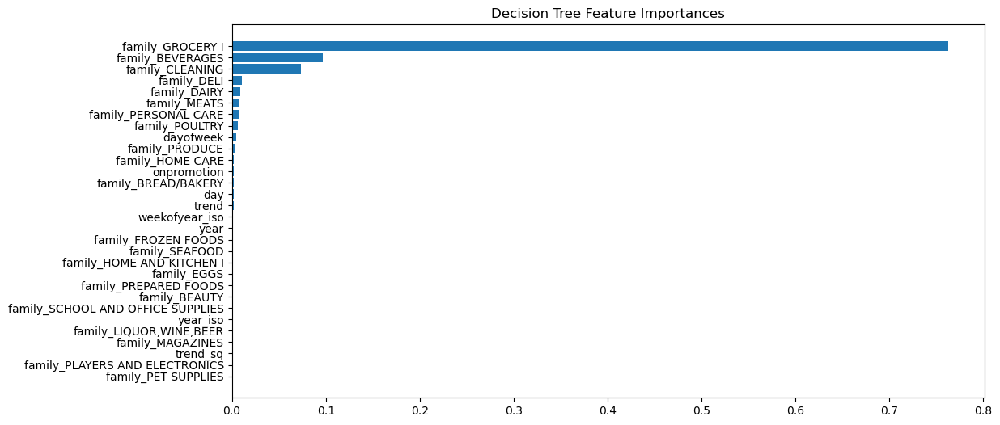


training performance

R² Score: 0.98
RMSE: 167.61
MAE: 63.18

test performance

R² Score: 0.98
RMSE: 212.83
MAE: 85.04


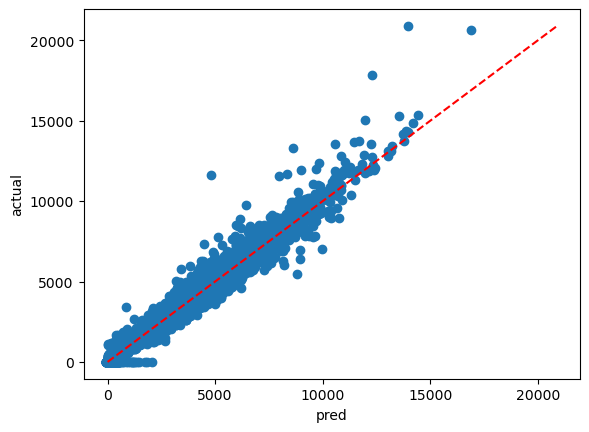

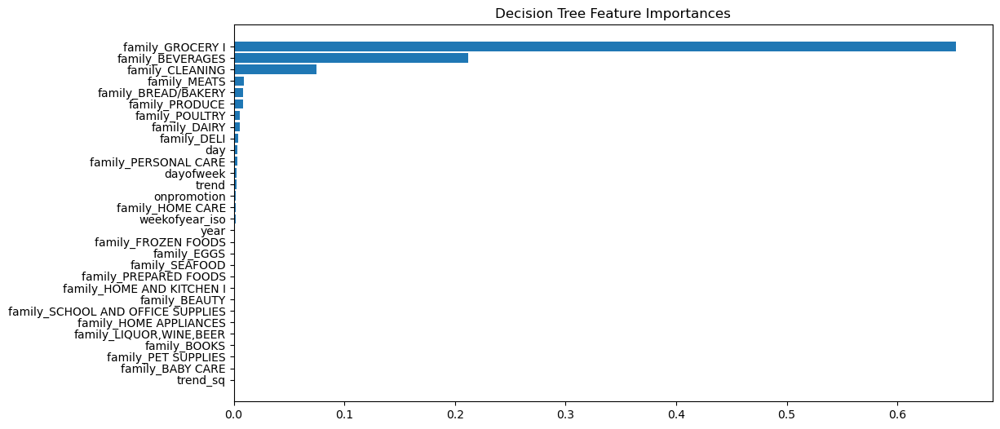


training performance

R² Score: 0.97
RMSE: 83.68
MAE: 28.72

test performance

R² Score: 0.95
RMSE: 131.71
MAE: 42.33


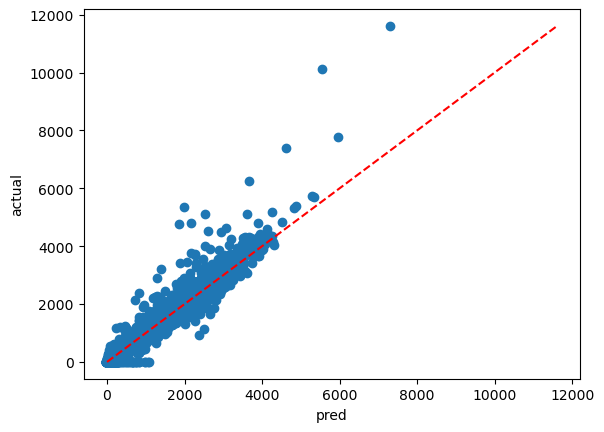

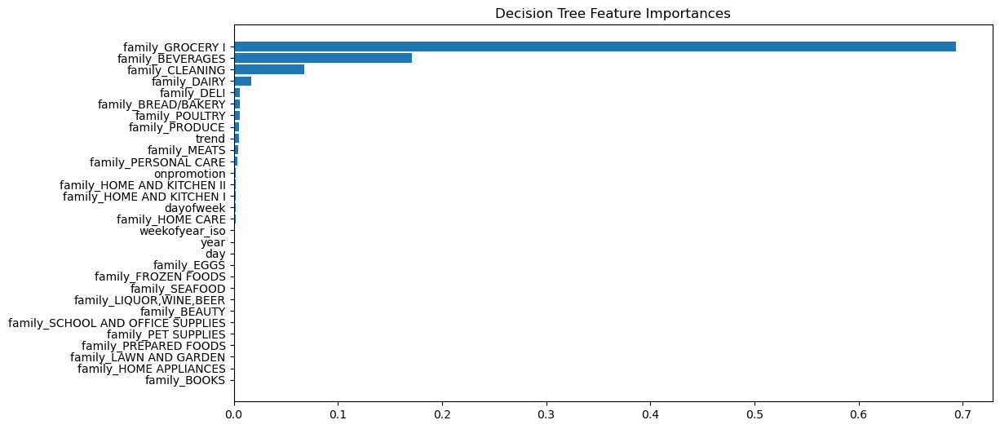


training performance

R² Score: 0.97
RMSE: 98.36
MAE: 29.43

test performance

R² Score: 0.94
RMSE: 144.07
MAE: 43.24


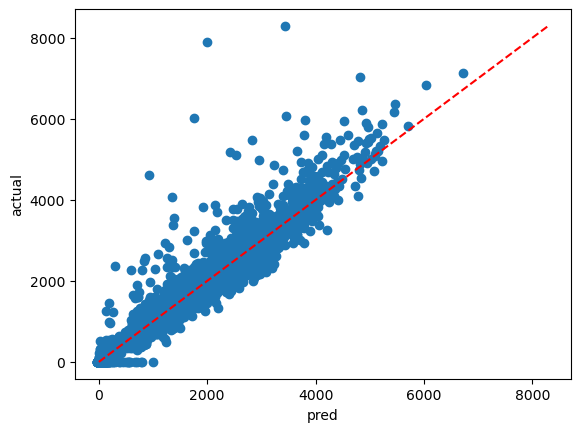

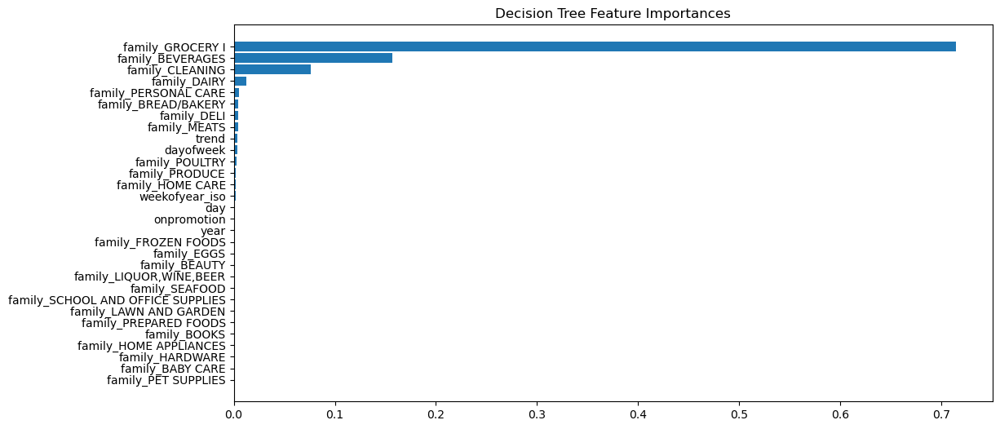


training performance

R² Score: 0.98
RMSE: 85.17
MAE: 32.49

test performance

R² Score: 0.89
RMSE: 217.24
MAE: 58.95


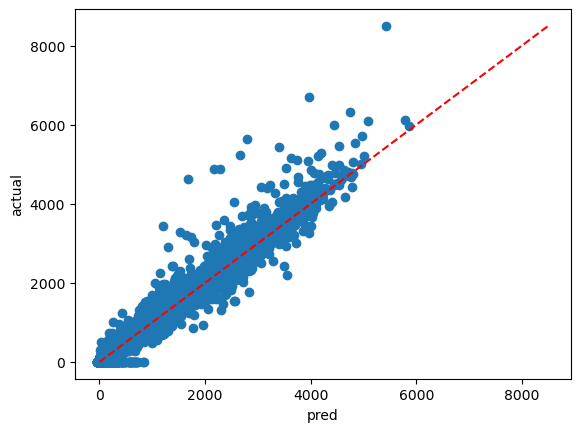

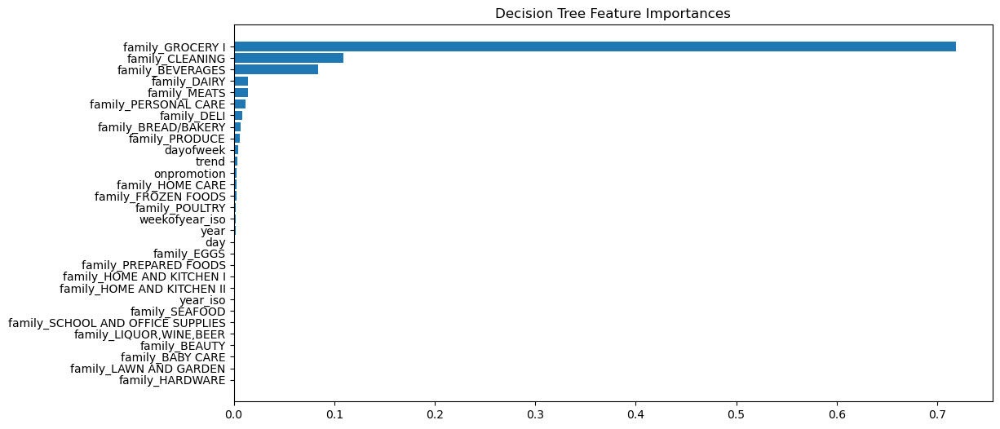


training performance

R² Score: 0.97
RMSE: 89.64
MAE: 29.56

test performance

R² Score: 0.98
RMSE: 76.35
MAE: 33.06


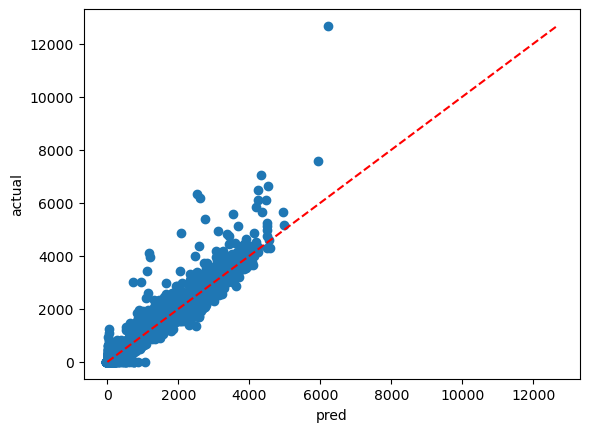

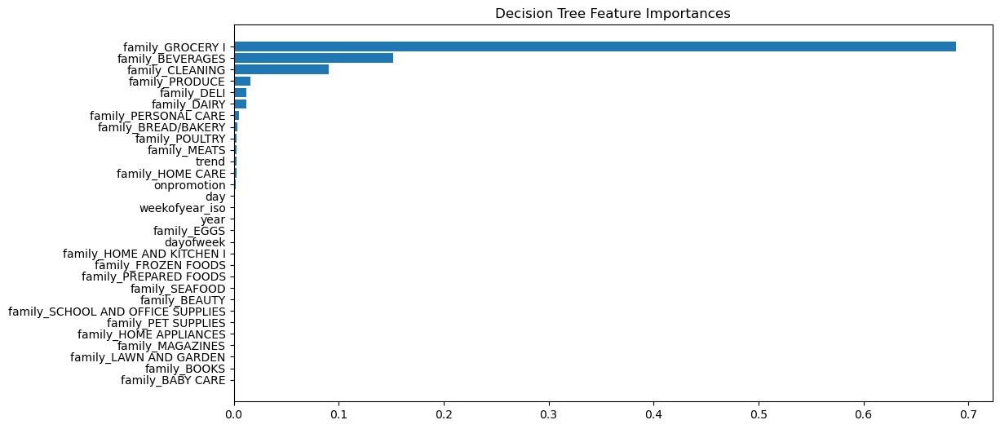


training performance

R² Score: 0.97
RMSE: 87.91
MAE: 30.90

test performance

R² Score: 0.93
RMSE: 131.37
MAE: 43.34


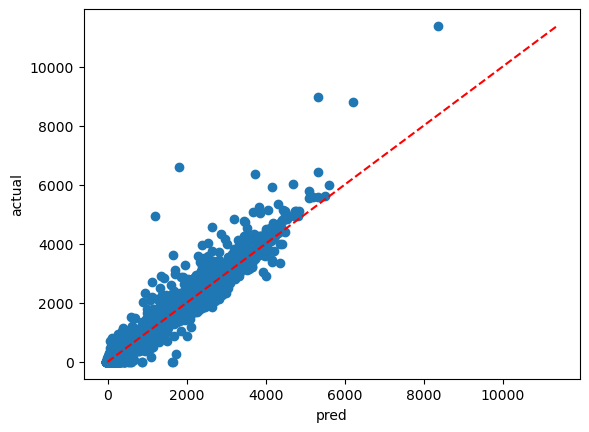

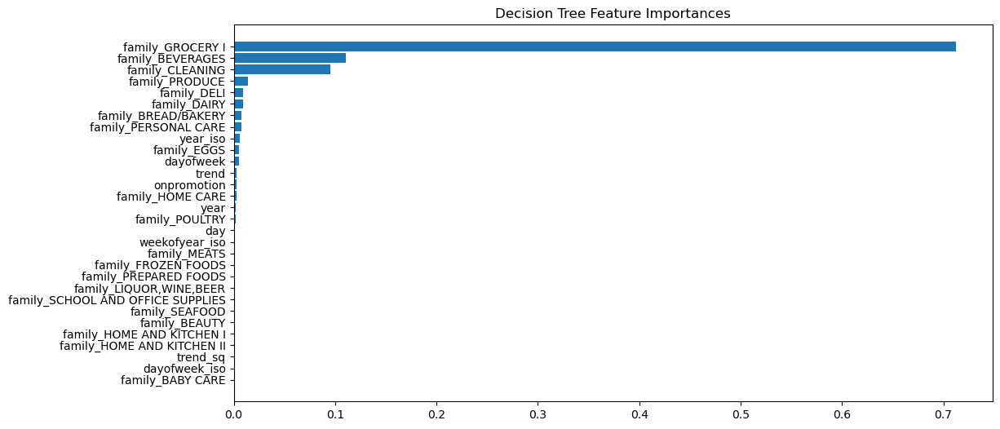


training performance

R² Score: 0.98
RMSE: 117.78
MAE: 43.02

test performance

R² Score: 0.98
RMSE: 149.38
MAE: 63.23


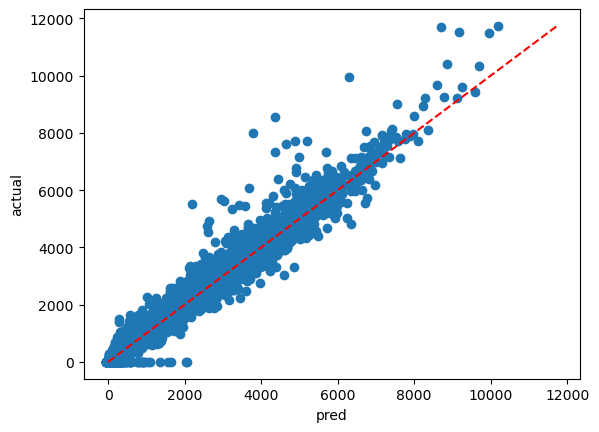

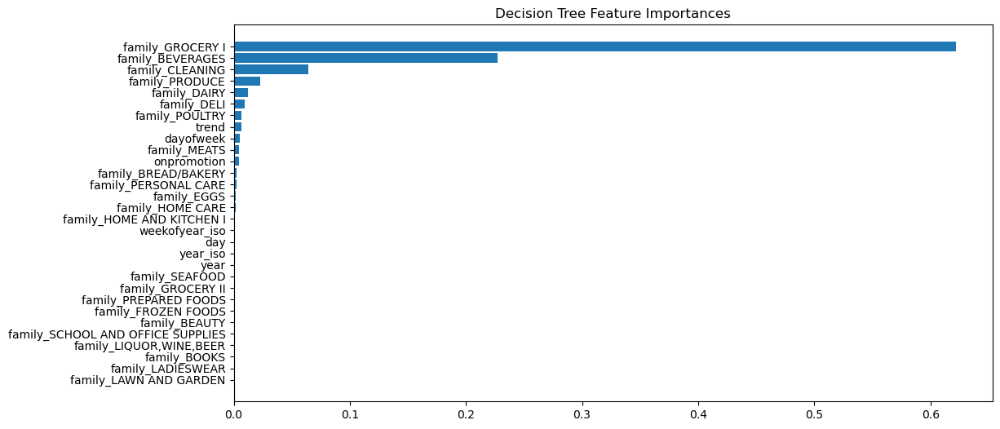


training performance

R² Score: 0.96
RMSE: 126.35
MAE: 41.65

test performance

R² Score: 0.98
RMSE: 109.82
MAE: 49.51


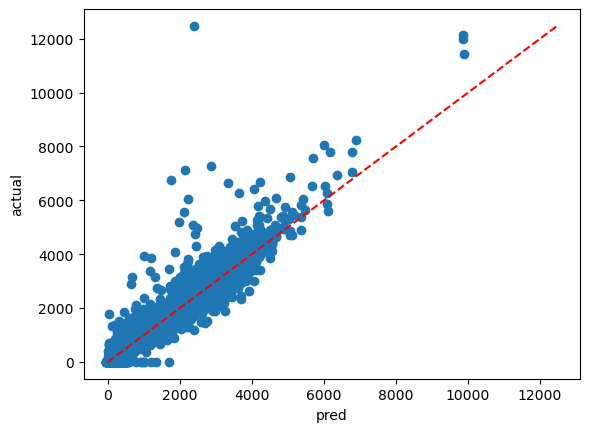

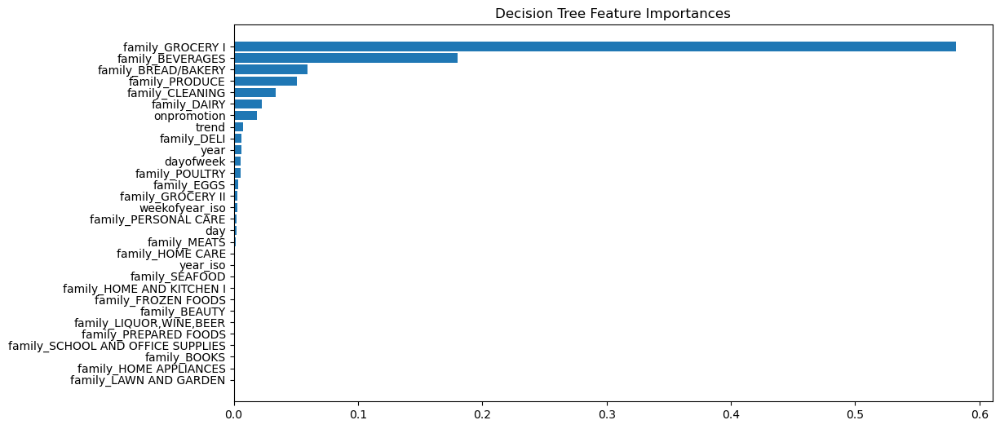


training performance

R² Score: 0.98
RMSE: 87.50
MAE: 31.98

test performance

R² Score: 0.98
RMSE: 112.12
MAE: 43.80


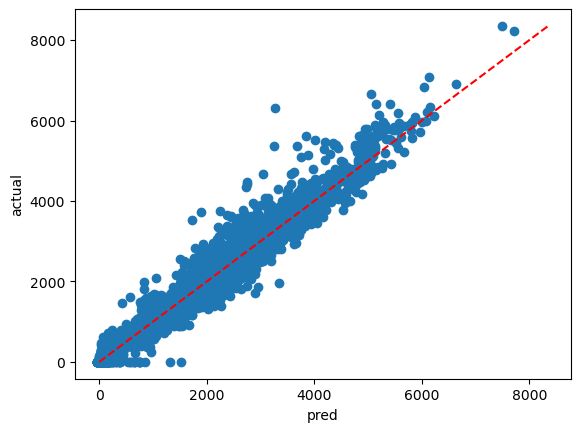

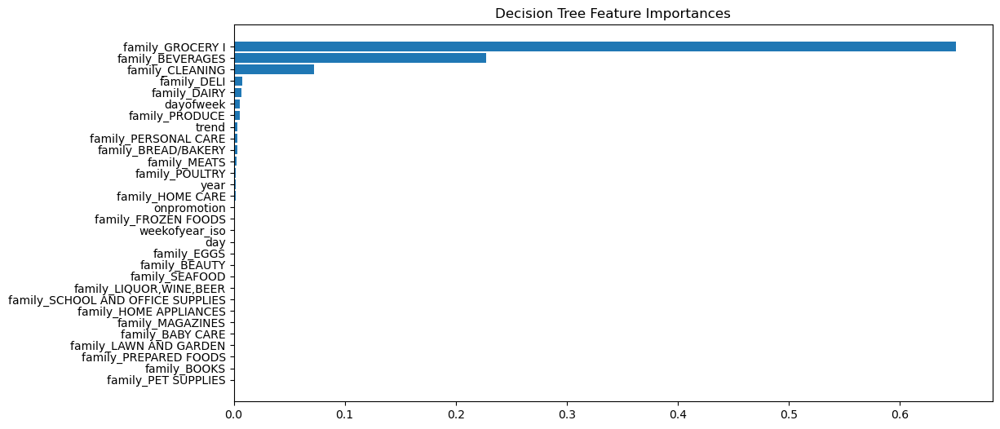


training performance

R² Score: 0.97
RMSE: 194.06
MAE: 52.82

test performance

R² Score: 0.95
RMSE: 181.73
MAE: 74.02


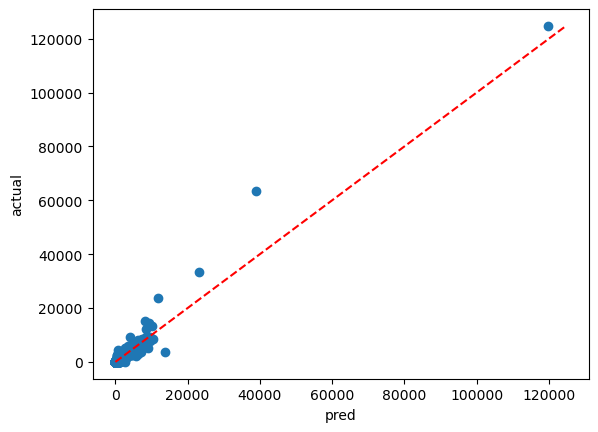

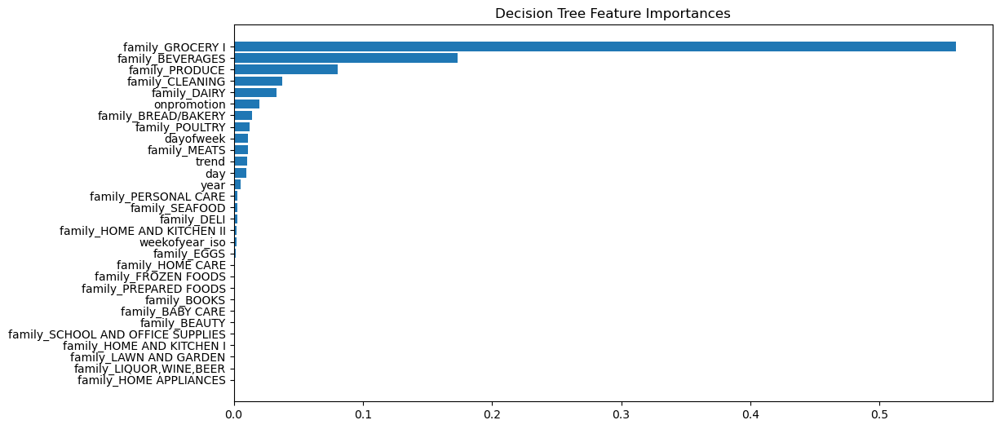


training performance

R² Score: 0.94
RMSE: 233.05
MAE: 44.54

test performance

R² Score: 0.92
RMSE: 380.53
MAE: 128.33


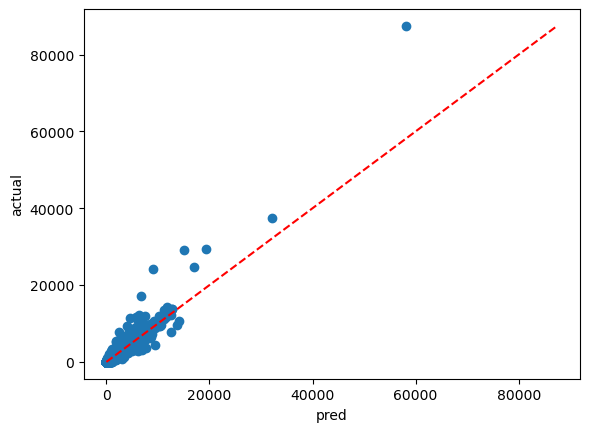

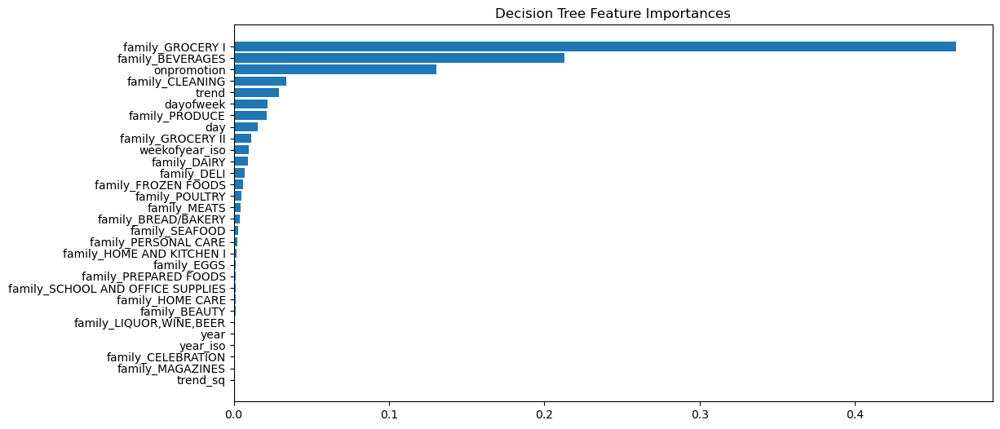


training performance

R² Score: 0.98
RMSE: 98.57
MAE: 28.26

test performance

R² Score: 0.91
RMSE: 318.20
MAE: 114.61


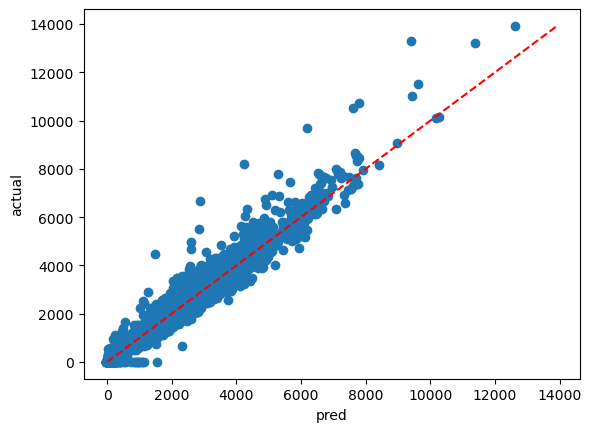

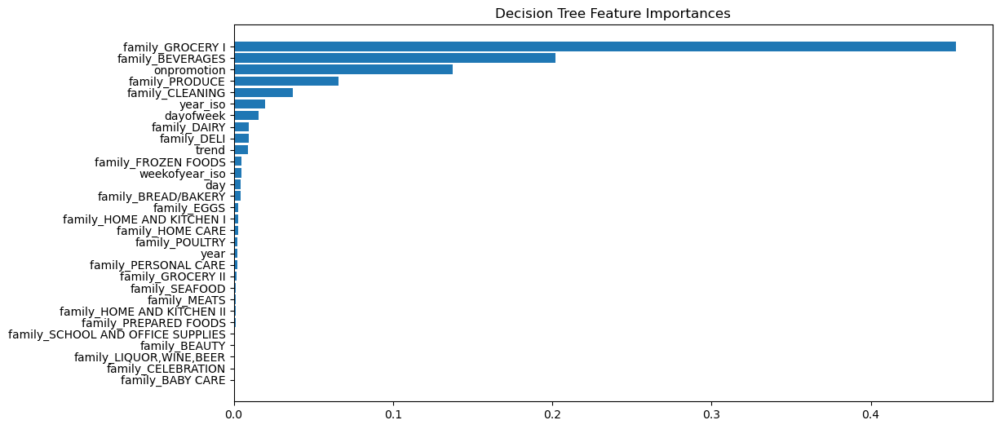


training performance

R² Score: 0.98
RMSE: 45.88
MAE: 12.52

test performance

R² Score: 0.95
RMSE: 131.18
MAE: 52.31


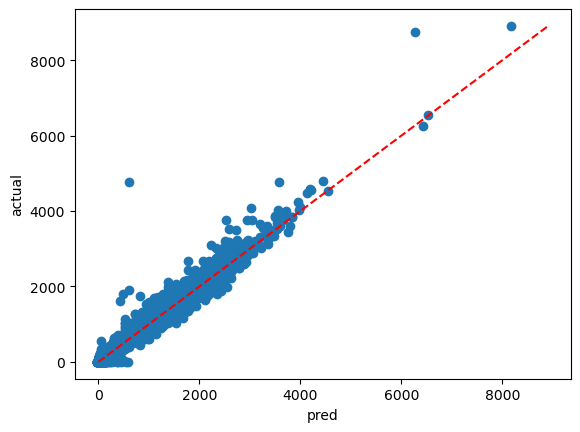

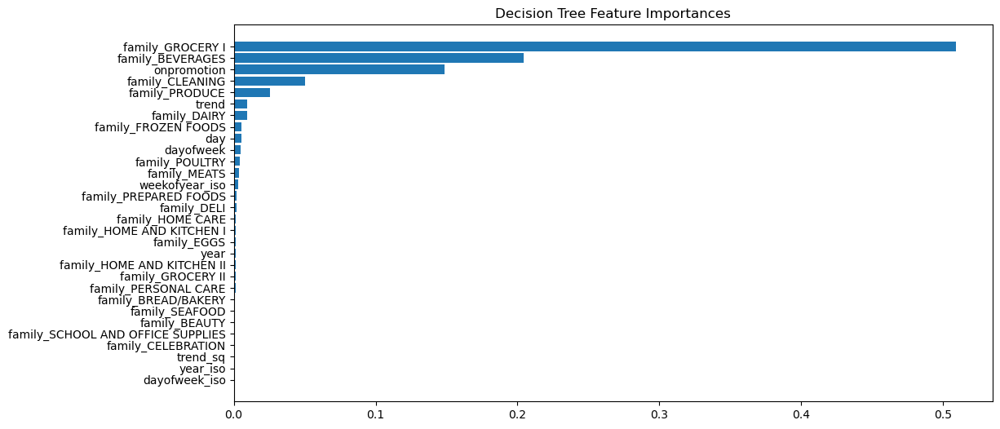


training performance

R² Score: 0.96
RMSE: 92.89
MAE: 33.55

test performance

R² Score: 0.97
RMSE: 82.81
MAE: 36.94


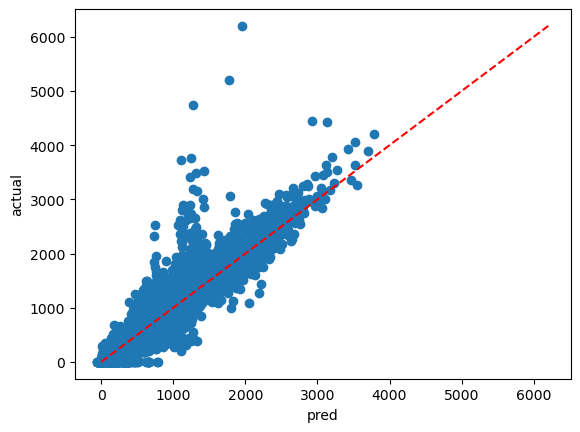

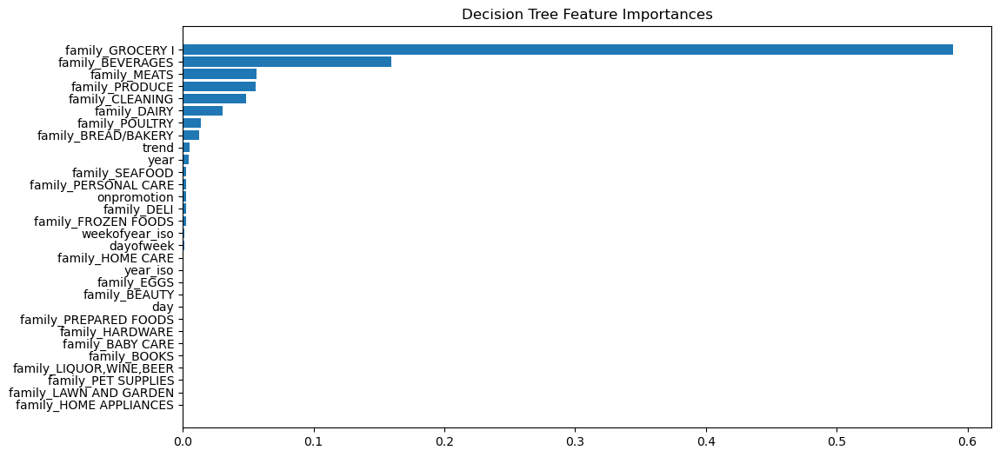


training performance

R² Score: 0.98
RMSE: 154.22
MAE: 58.16

test performance

R² Score: 0.98
RMSE: 139.12
MAE: 61.80


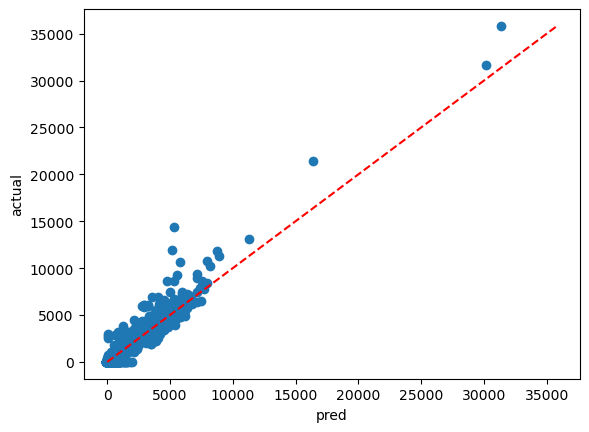

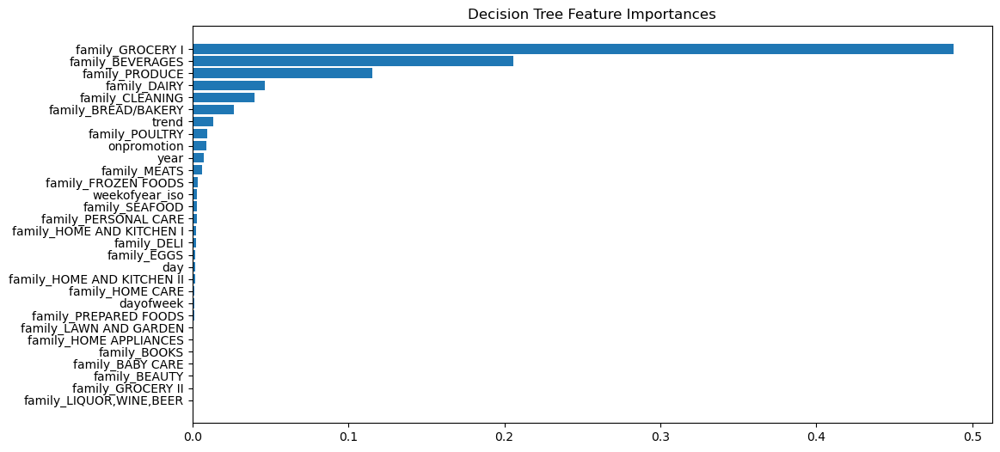


training performance

R² Score: 0.93
RMSE: 150.01
MAE: 50.65

test performance

R² Score: 0.81
RMSE: 292.70
MAE: 83.60


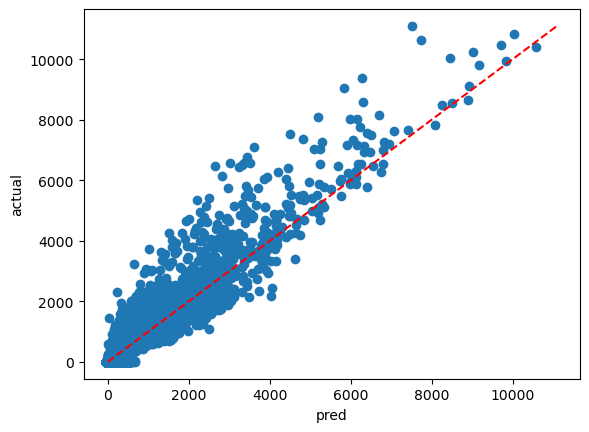

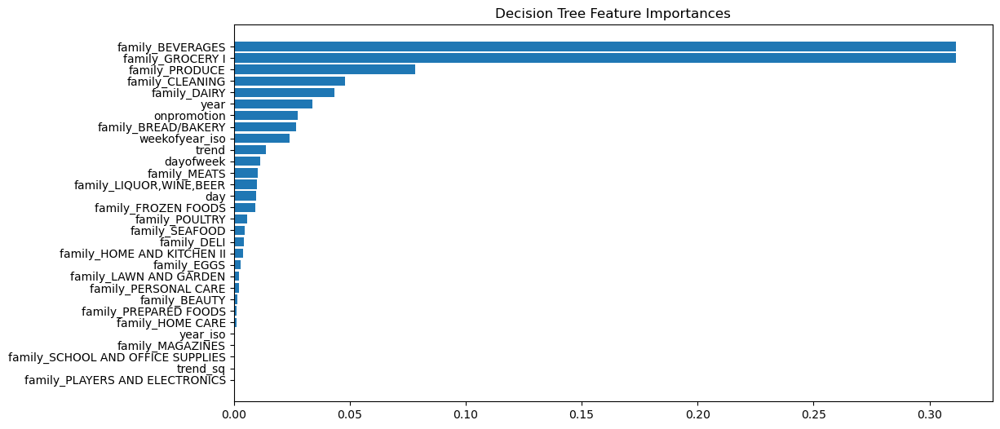


training performance

R² Score: 0.95
RMSE: 92.01
MAE: 28.80

test performance

R² Score: 0.94
RMSE: 81.50
MAE: 32.66


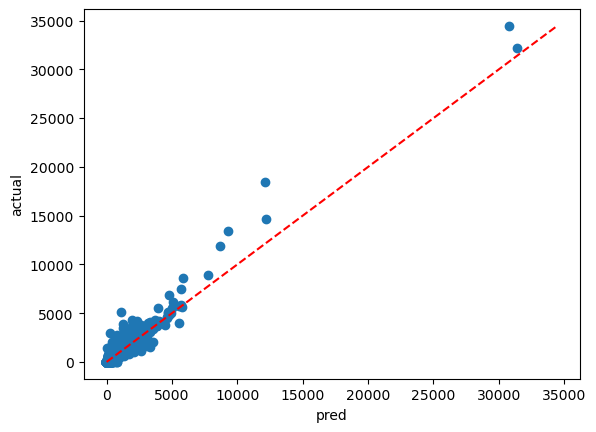

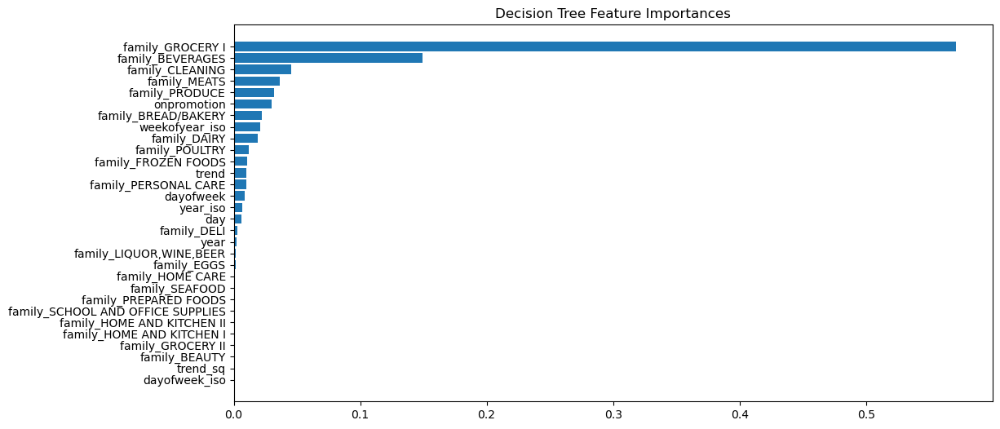


training performance

R² Score: 0.98
RMSE: 126.69
MAE: 47.61

test performance

R² Score: 0.98
RMSE: 135.47
MAE: 62.58


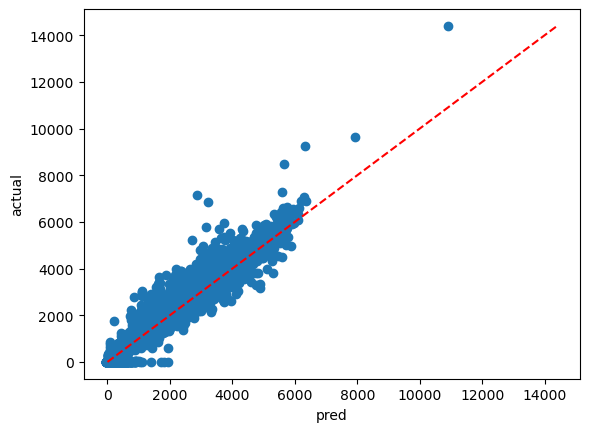

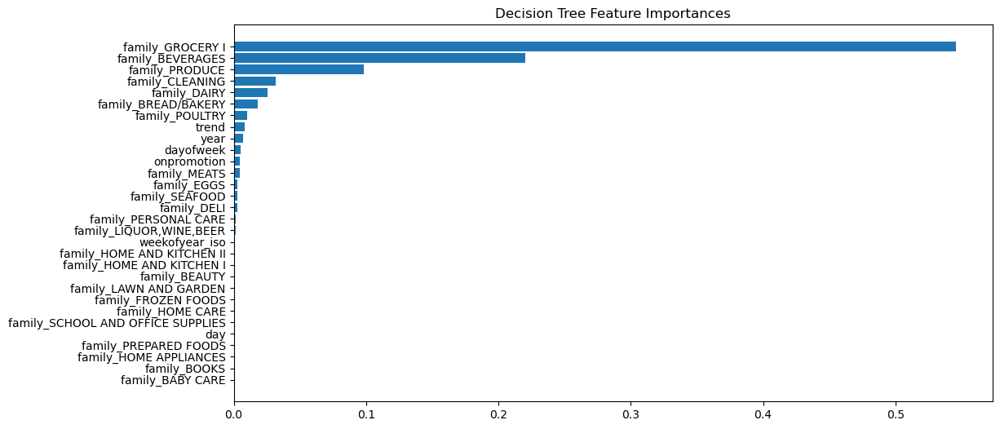


training performance

R² Score: 0.97
RMSE: 149.66
MAE: 54.63

test performance

R² Score: 0.94
RMSE: 326.15
MAE: 92.20


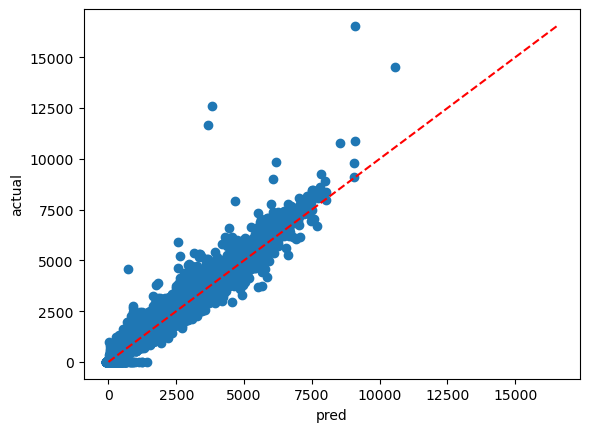

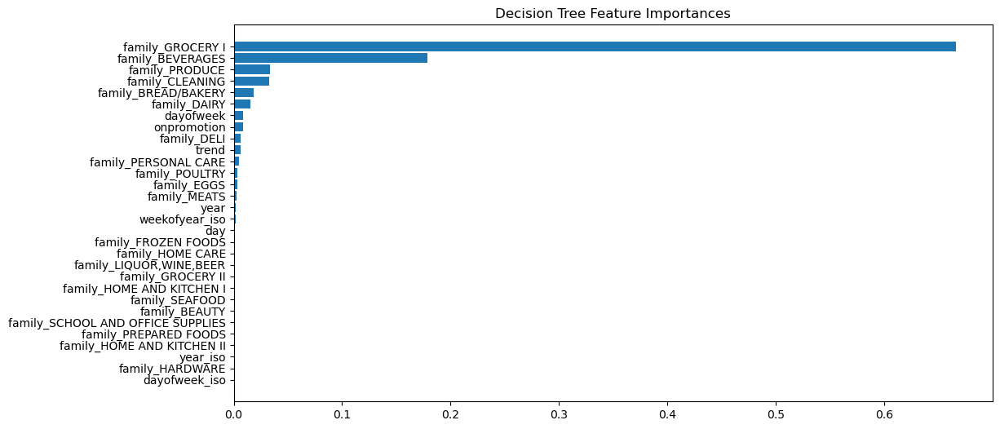


training performance

R² Score: 0.98
RMSE: 87.85
MAE: 27.81

test performance

R² Score: 0.97
RMSE: 169.10
MAE: 62.12


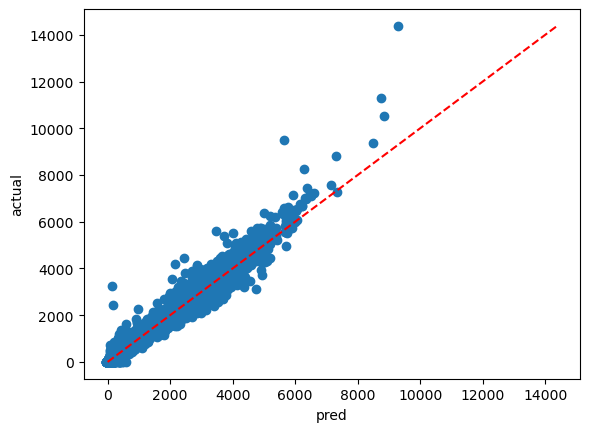

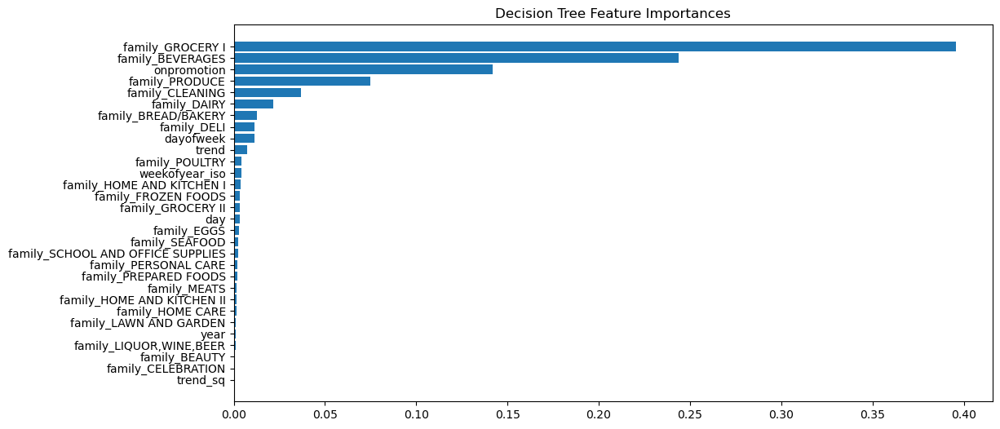


training performance

R² Score: 0.98
RMSE: 293.40
MAE: 111.42

test performance

R² Score: 0.96
RMSE: 427.98
MAE: 160.74


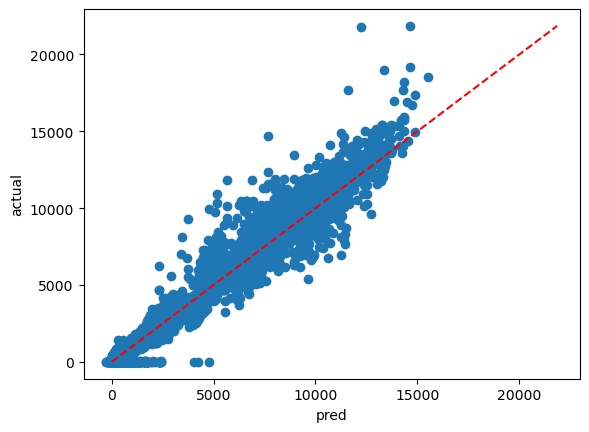

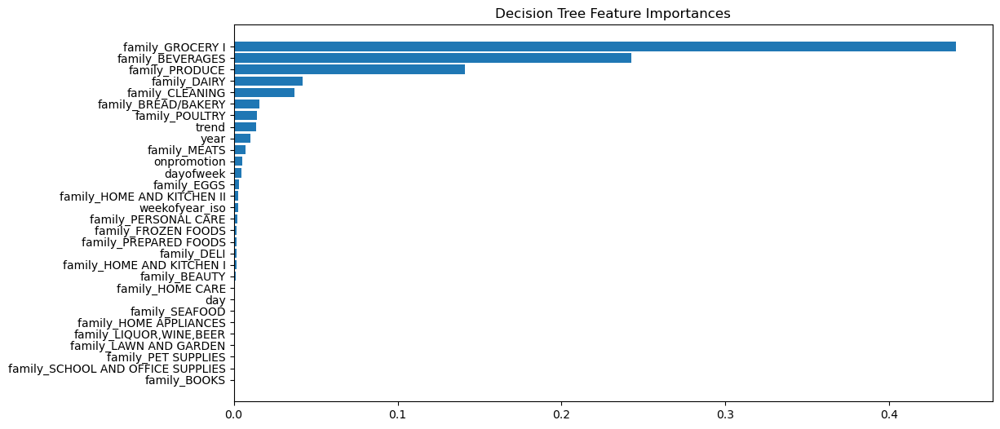


training performance

R² Score: 0.96
RMSE: 69.49
MAE: 23.46

test performance

R² Score: 0.72
RMSE: 276.00
MAE: 74.17


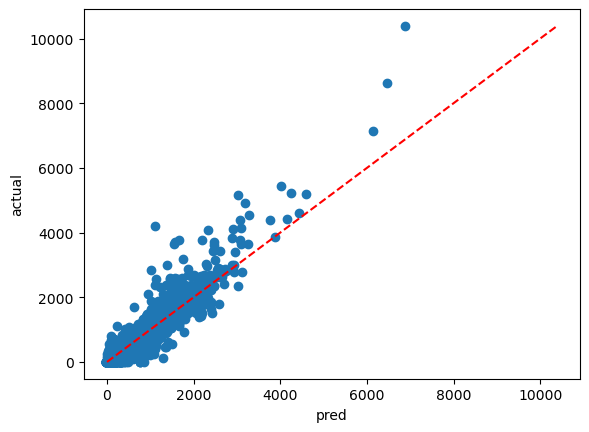

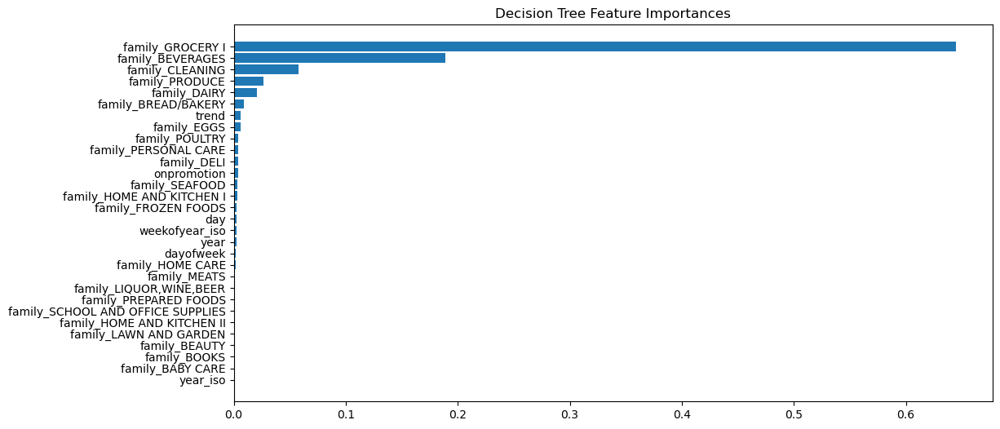


training performance

R² Score: 0.98
RMSE: 119.74
MAE: 45.76

test performance

R² Score: 0.96
RMSE: 229.22
MAE: 80.05


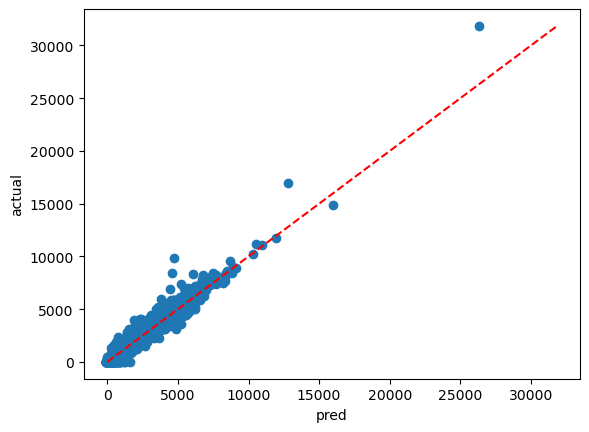

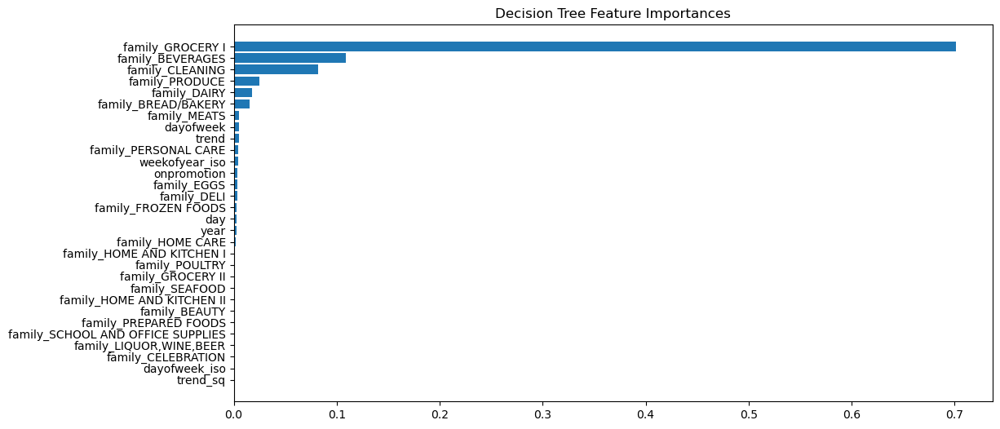


training performance

R² Score: 0.94
RMSE: 83.57
MAE: 21.97

test performance

R² Score: 0.79
RMSE: 195.85
MAE: 53.20


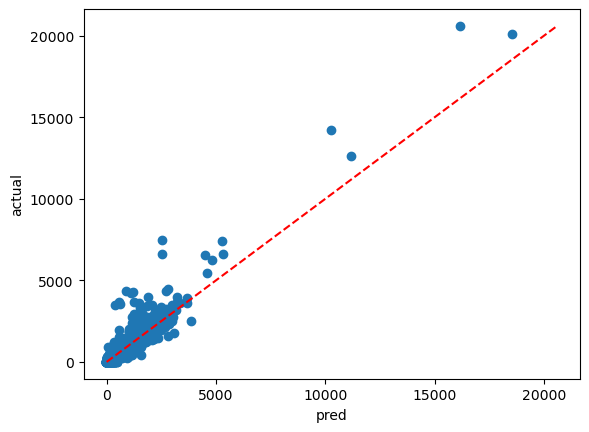

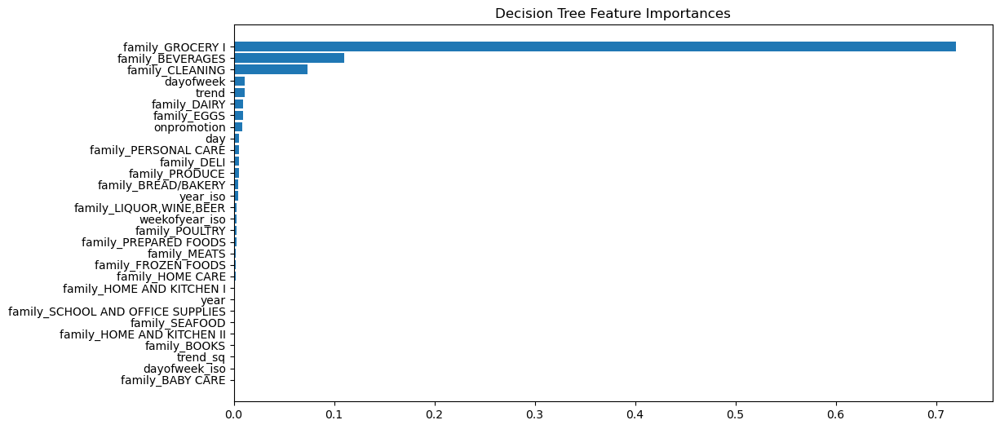


training performance

R² Score: 0.97
RMSE: 112.28
MAE: 41.88

test performance

R² Score: 0.95
RMSE: 167.62
MAE: 50.84


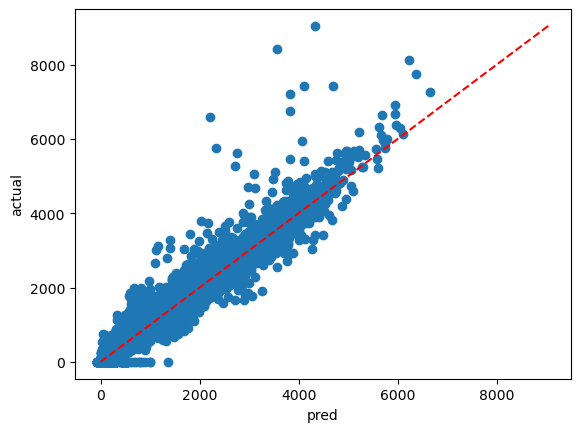

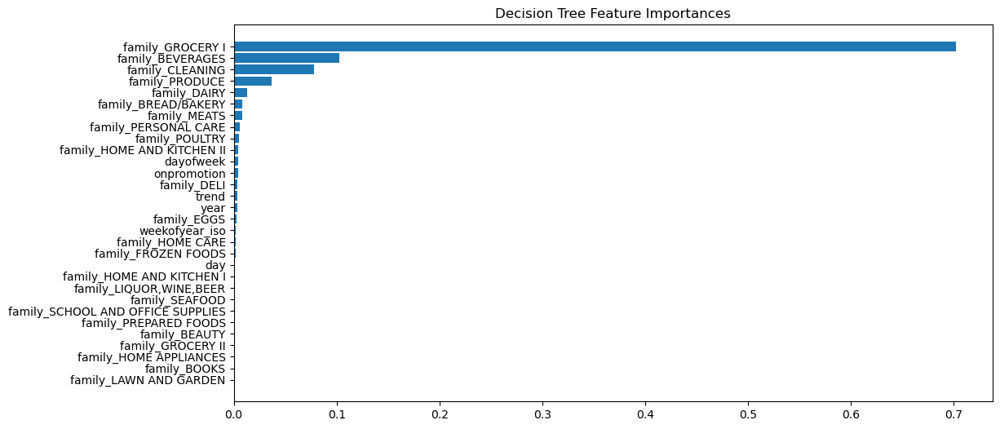


training performance

R² Score: 0.98
RMSE: 107.01
MAE: 41.40

test performance

R² Score: 0.98
RMSE: 124.46
MAE: 47.86


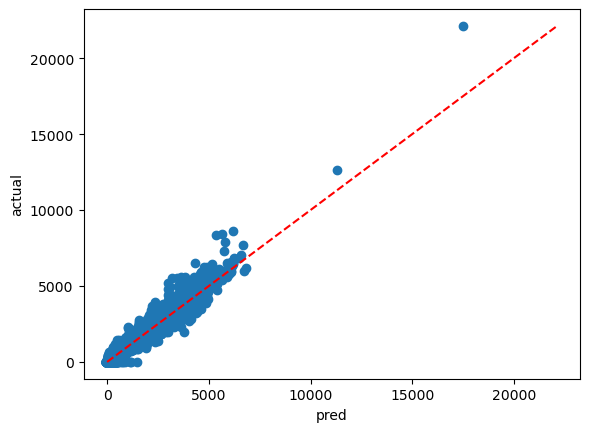

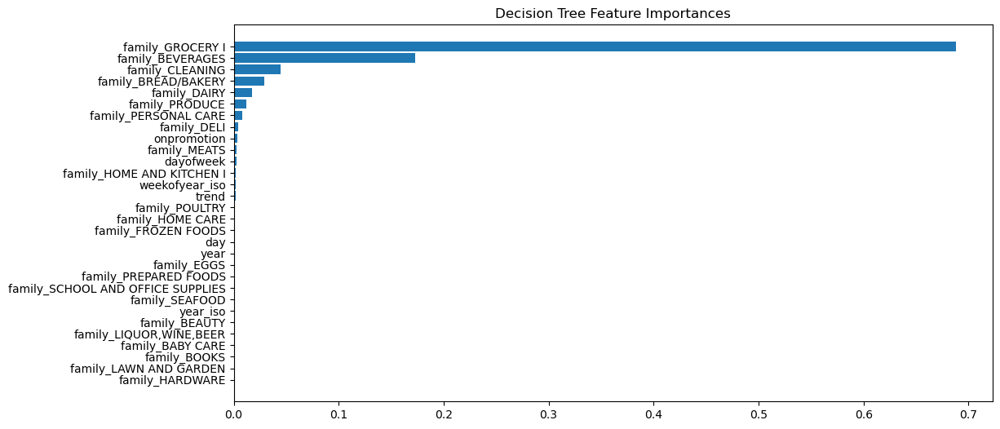


training performance

R² Score: 0.98
RMSE: 68.12
MAE: 24.82

test performance

R² Score: 0.96
RMSE: 93.33
MAE: 31.83


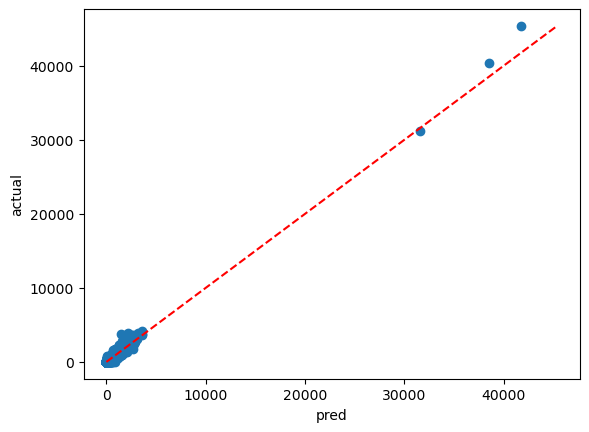

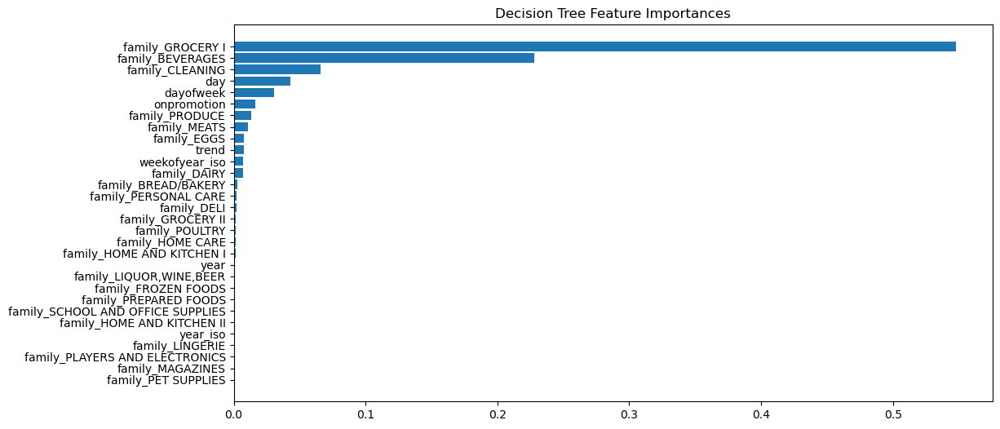


training performance

R² Score: 0.97
RMSE: 118.78
MAE: 45.02

test performance

R² Score: 0.94
RMSE: 251.13
MAE: 78.40


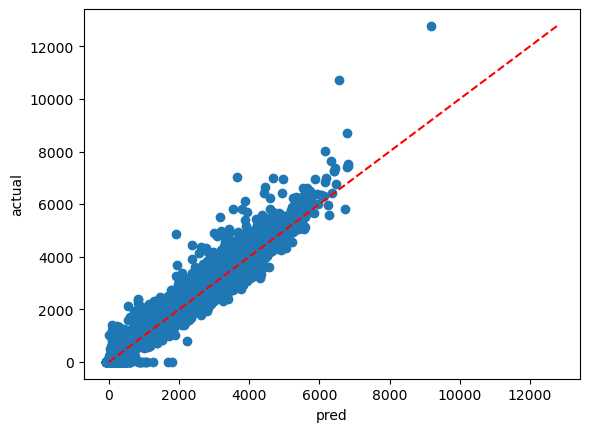

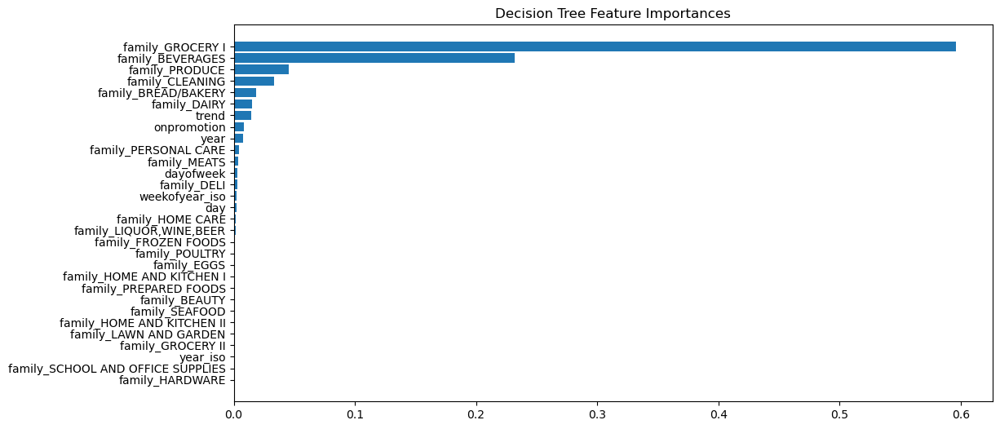


training performance

R² Score: 0.98
RMSE: 121.53
MAE: 45.91

test performance

R² Score: 0.95
RMSE: 182.65
MAE: 70.66


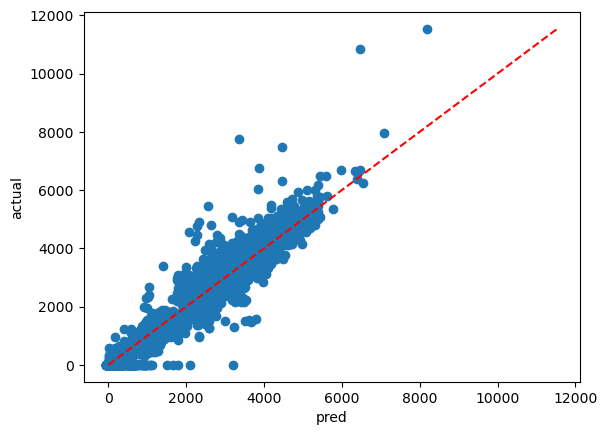

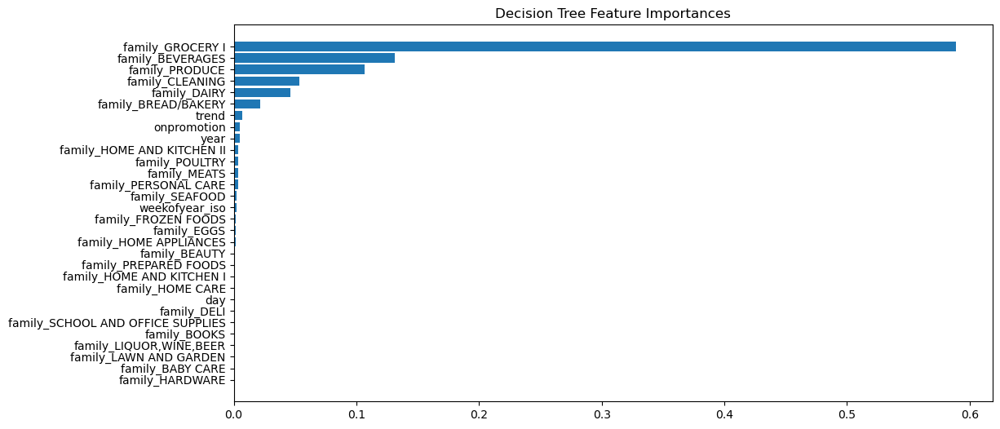


training performance

R² Score: 0.97
RMSE: 153.32
MAE: 50.13

test performance

R² Score: 0.84
RMSE: 342.61
MAE: 96.09


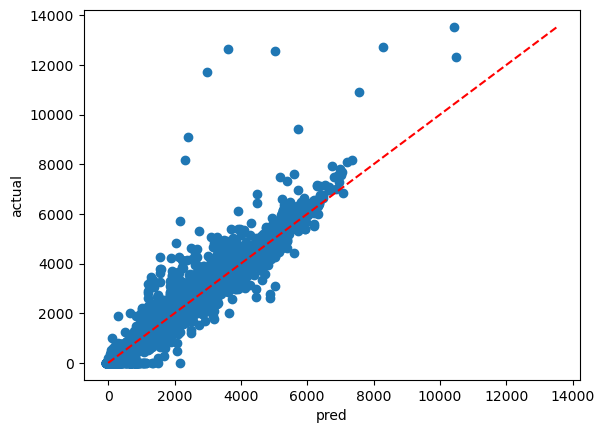

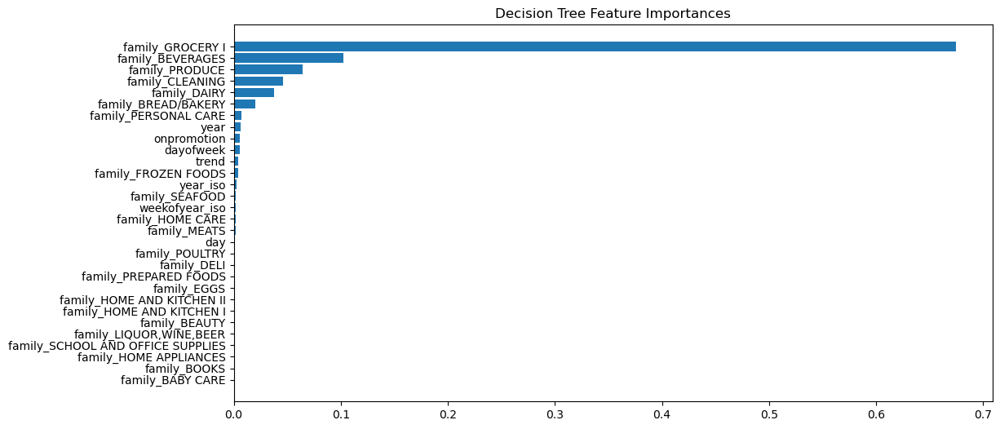


training performance

R² Score: 0.95
RMSE: 235.91
MAE: 58.13

test performance

R² Score: 0.91
RMSE: 356.71
MAE: 127.72


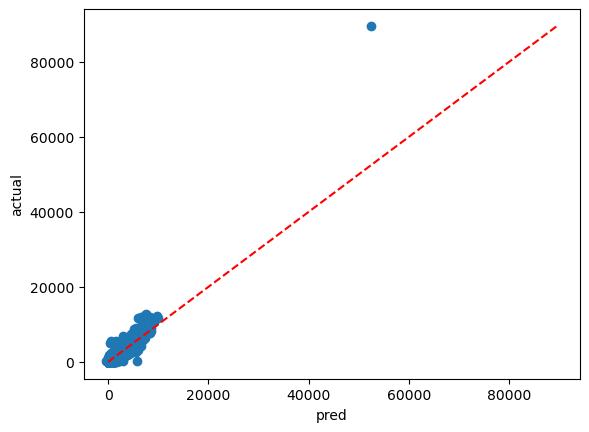

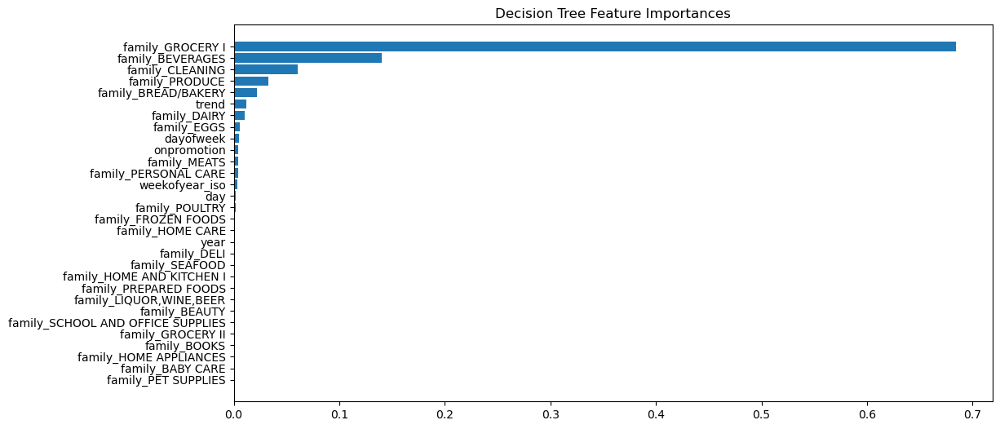


training performance

R² Score: 0.98
RMSE: 120.04
MAE: 46.47

test performance

R² Score: 0.96
RMSE: 165.08
MAE: 66.37


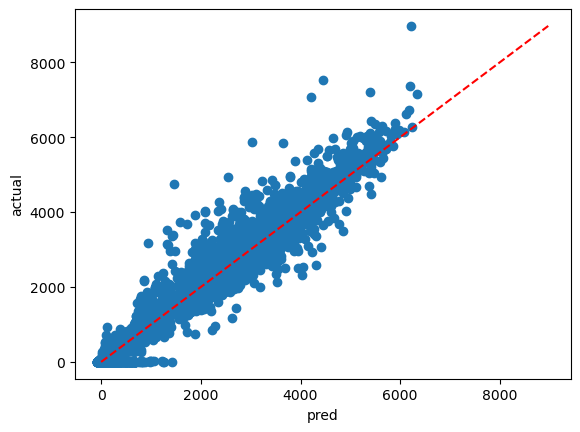

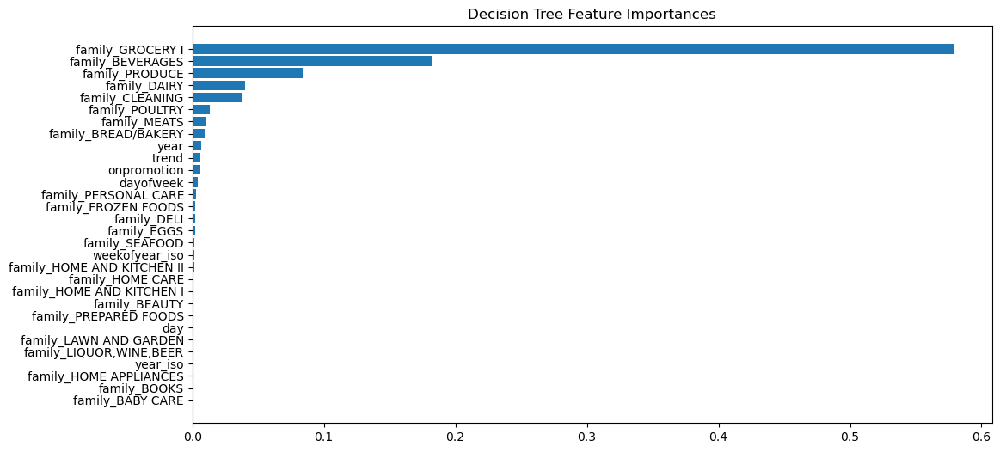


training performance

R² Score: 0.98
RMSE: 136.03
MAE: 46.23

test performance

R² Score: 0.90
RMSE: 459.92
MAE: 131.61


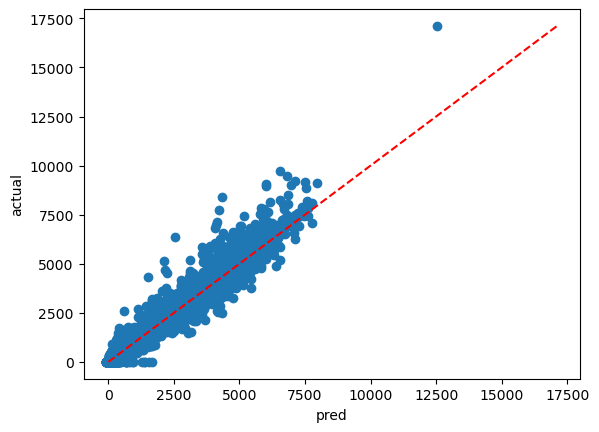

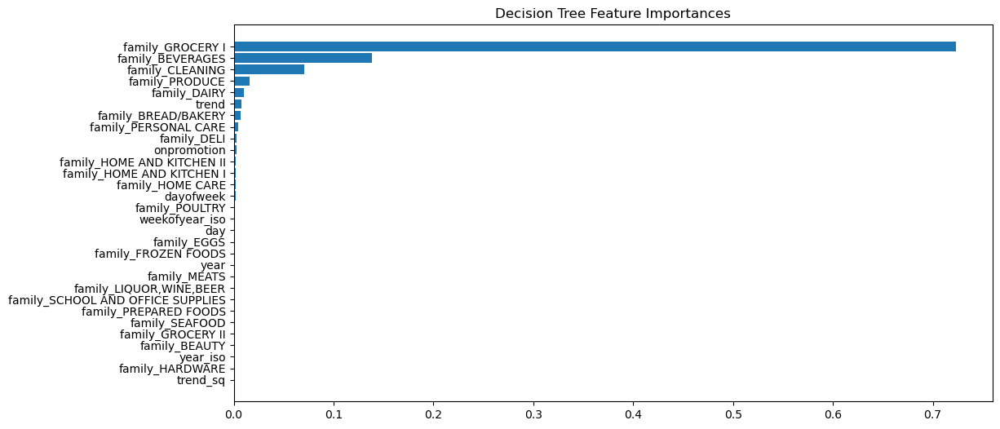


training performance

R² Score: 0.97
RMSE: 118.24
MAE: 42.00

test performance

R² Score: 0.83
RMSE: 356.53
MAE: 122.59


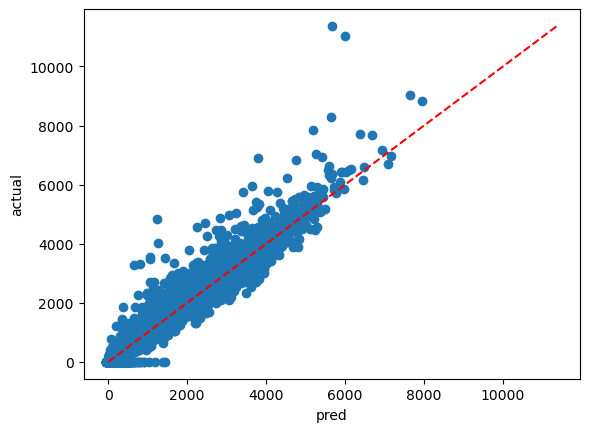

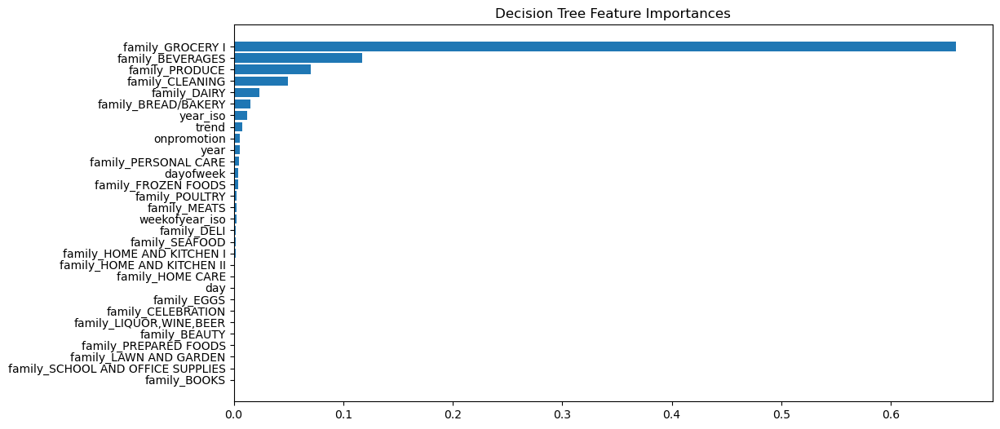


training performance

R² Score: 0.98
RMSE: 71.54
MAE: 21.31

test performance

R² Score: 0.91
RMSE: 228.31
MAE: 80.47


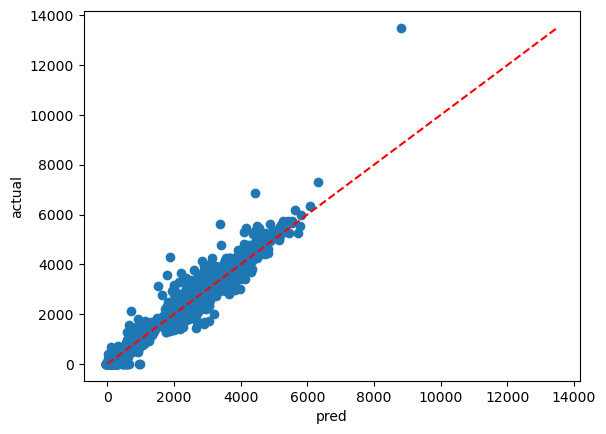

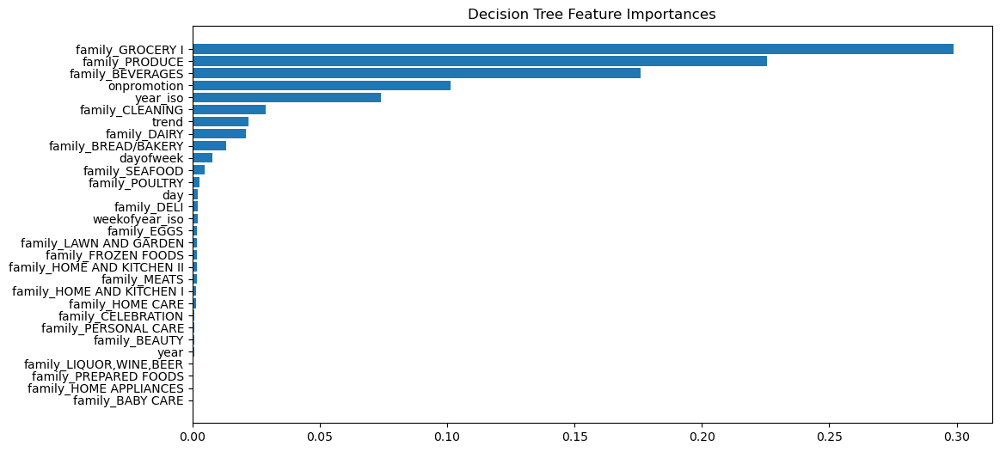


training performance

R² Score: 0.98
RMSE: 123.01
MAE: 44.08

test performance

R² Score: 0.98
RMSE: 197.18
MAE: 67.95


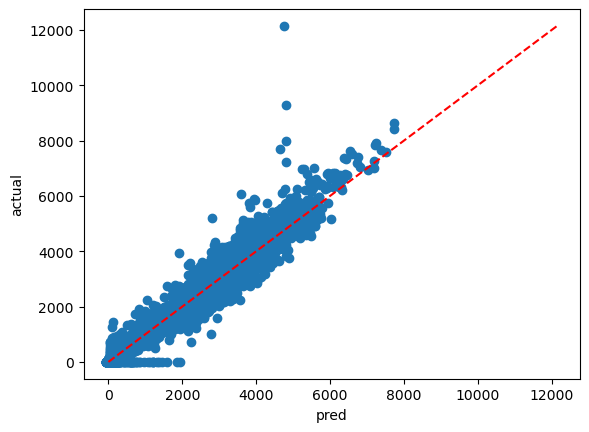

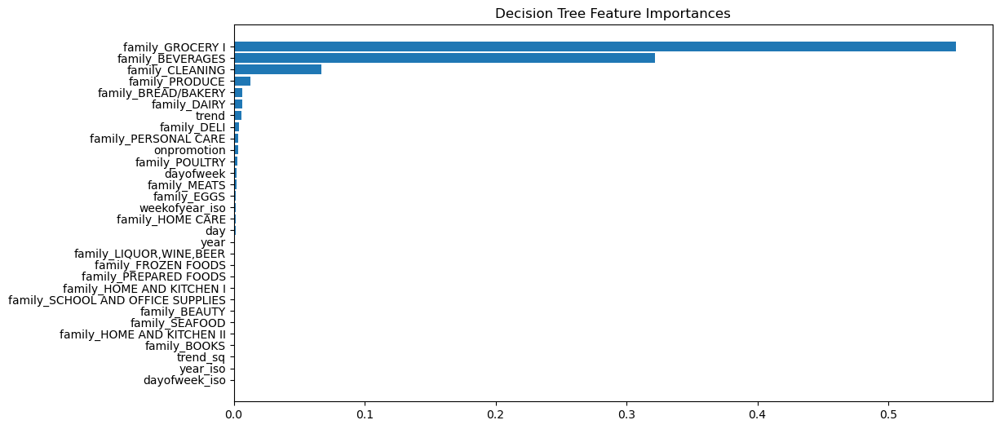


training performance

R² Score: 0.97
RMSE: 481.79
MAE: 156.30

test performance

R² Score: 0.96
RMSE: 556.86
MAE: 200.80


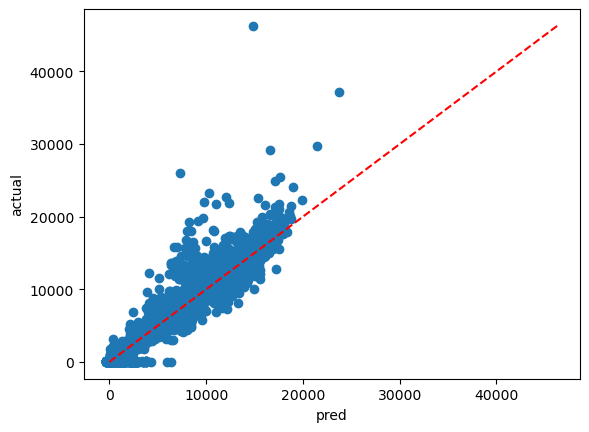

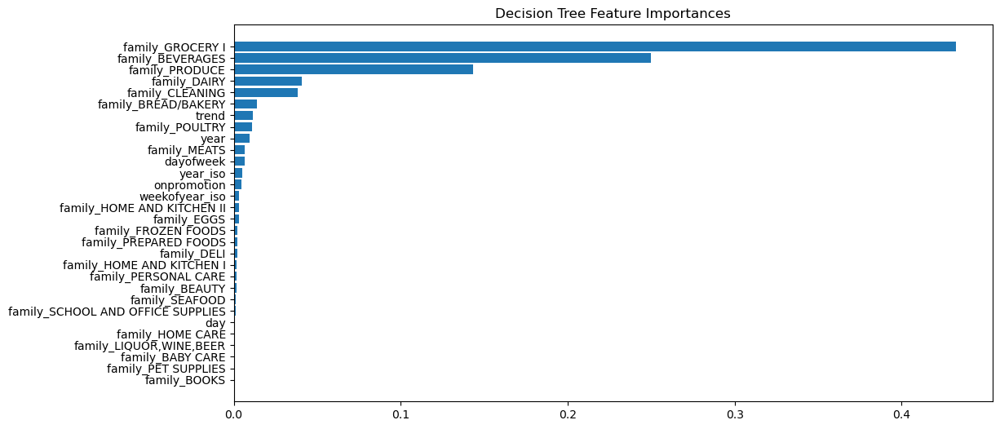


training performance

R² Score: 0.97
RMSE: 379.70
MAE: 134.69

test performance

R² Score: 0.97
RMSE: 447.68
MAE: 176.78


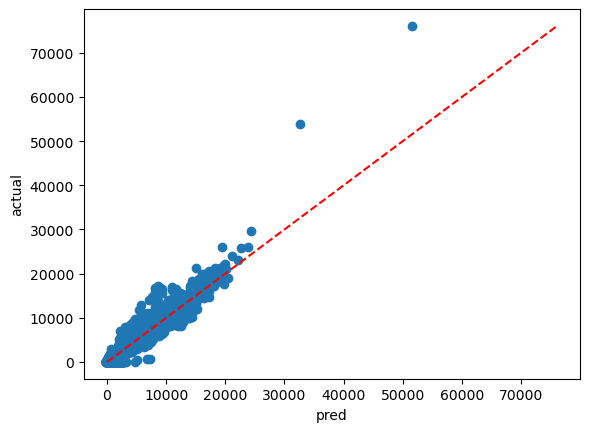

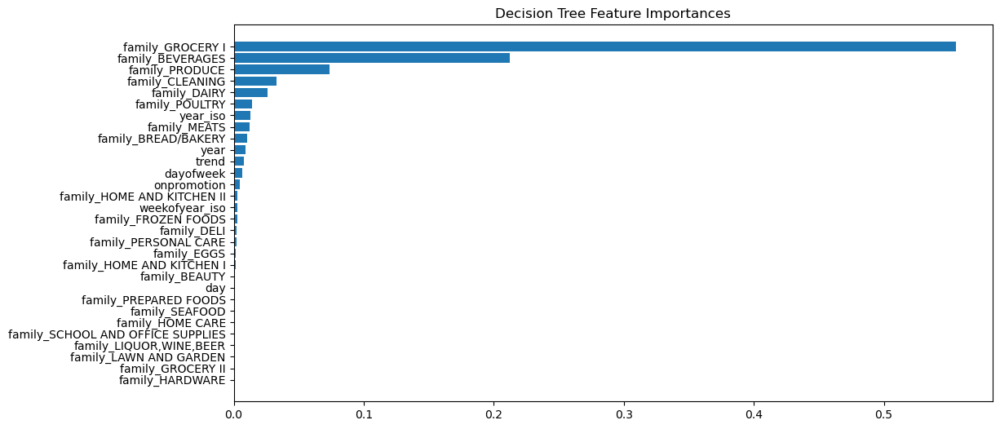


training performance

R² Score: 0.98
RMSE: 282.12
MAE: 107.81

test performance

R² Score: 0.94
RMSE: 491.90
MAE: 188.60


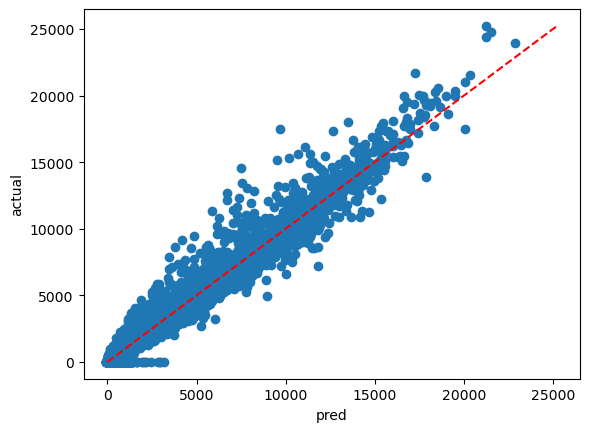

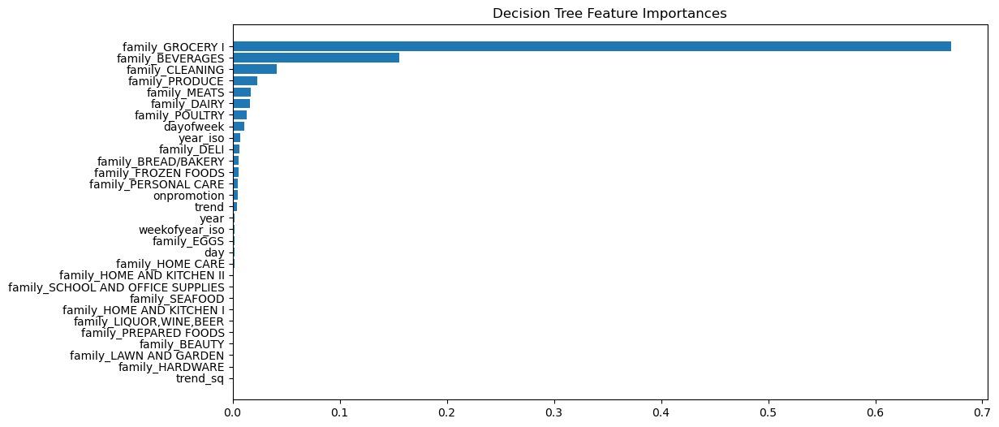


training performance

R² Score: 0.98
RMSE: 312.94
MAE: 119.51

test performance

R² Score: 0.96
RMSE: 483.87
MAE: 182.32


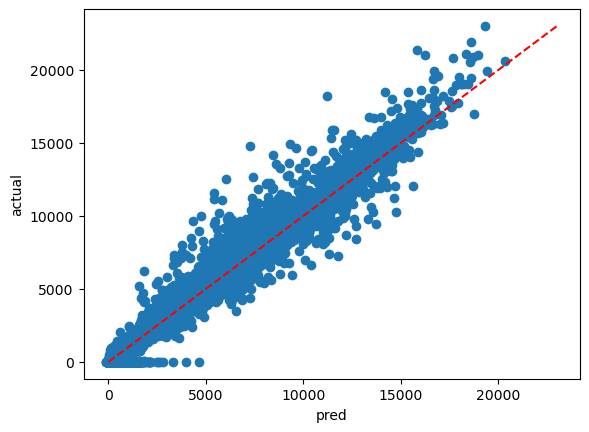

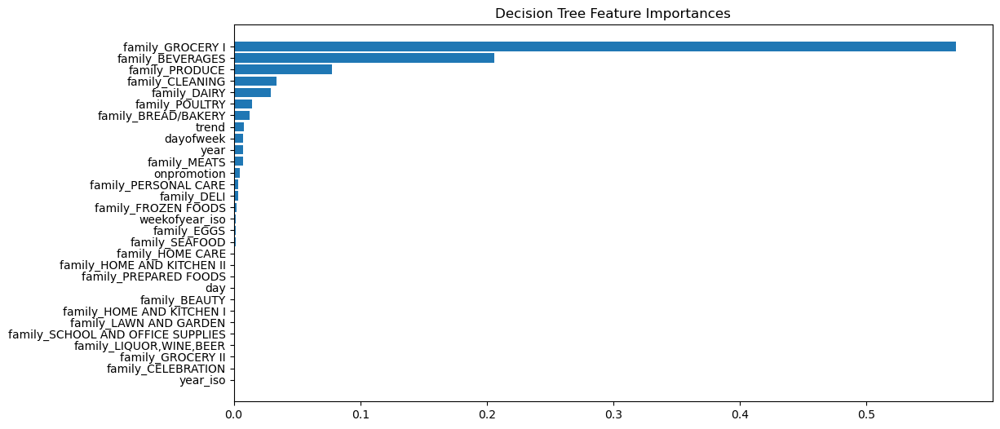


training performance

R² Score: 0.98
RMSE: 241.83
MAE: 93.54

test performance

R² Score: 0.96
RMSE: 366.36
MAE: 144.41


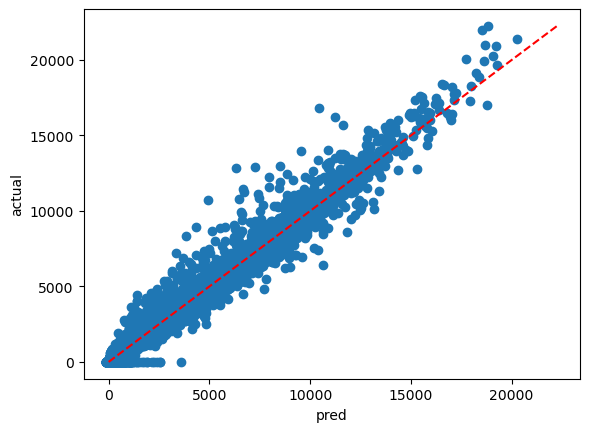

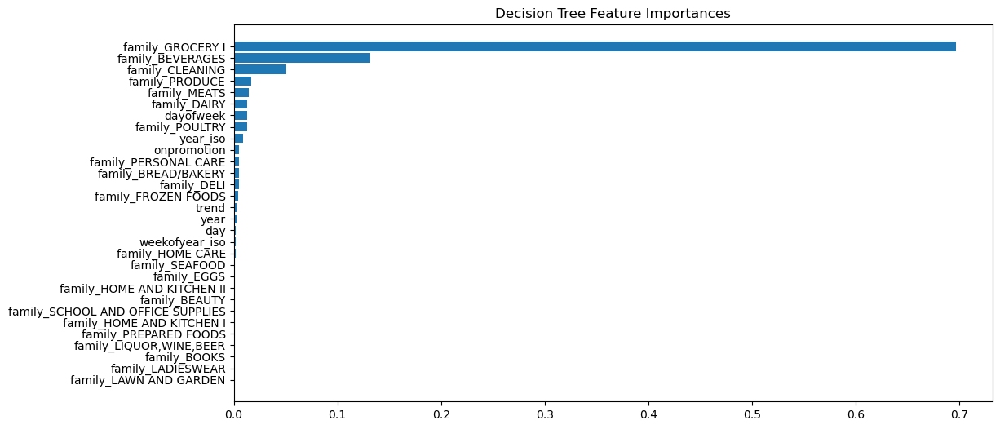


training performance

R² Score: 0.98
RMSE: 269.51
MAE: 103.37

test performance

R² Score: 0.97
RMSE: 367.39
MAE: 158.42


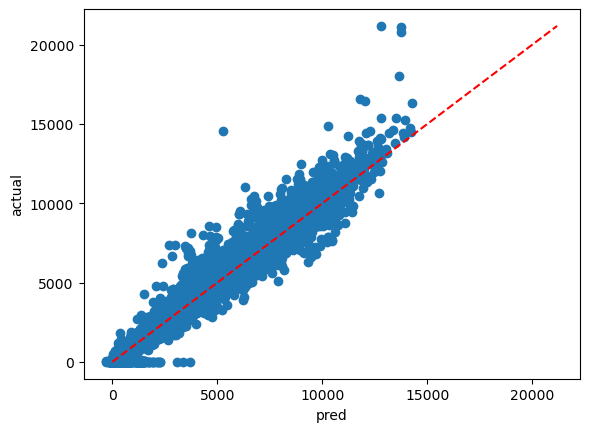

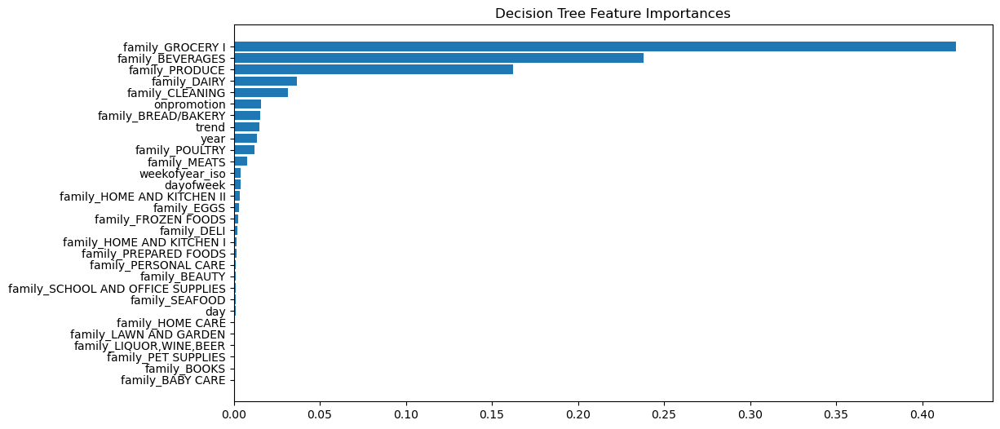


training performance

R² Score: 0.98
RMSE: 97.23
MAE: 39.08

test performance

R² Score: 0.98
RMSE: 97.74
MAE: 39.34


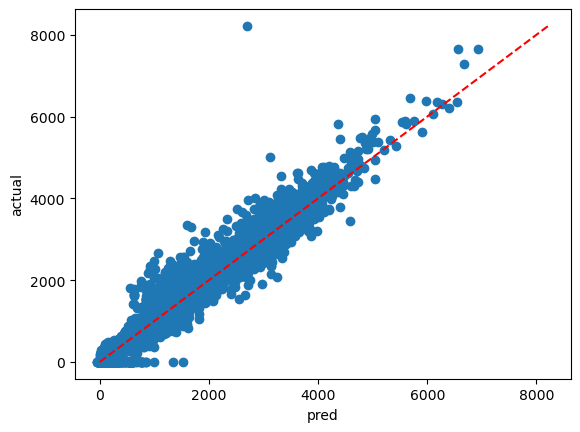

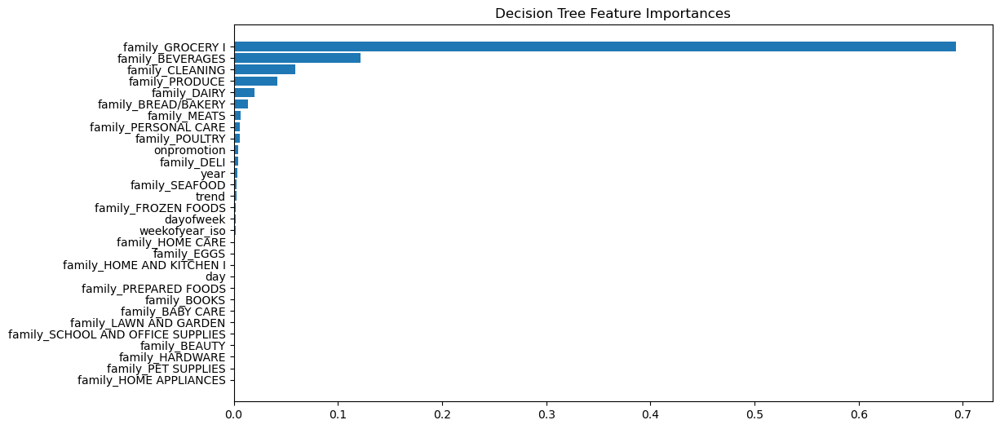


training performance

R² Score: 0.98
RMSE: 171.13
MAE: 69.96

test performance

R² Score: 0.96
RMSE: 264.39
MAE: 104.90


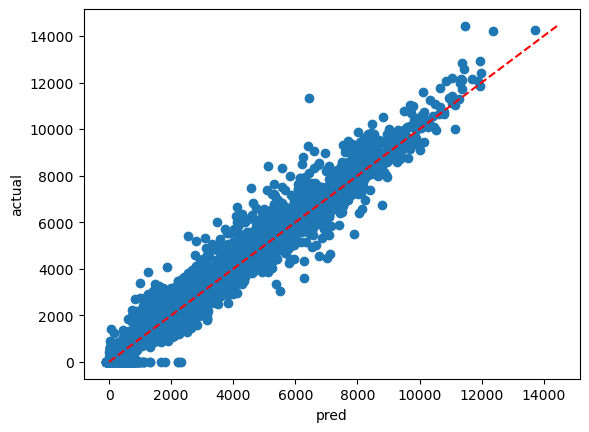

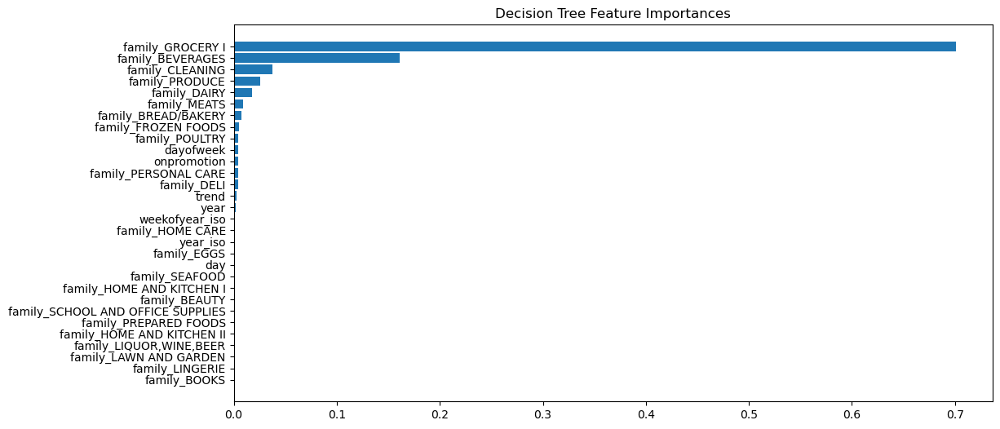


training performance

R² Score: 0.97
RMSE: 215.51
MAE: 79.96

test performance

R² Score: 0.98
RMSE: 226.78
MAE: 88.37


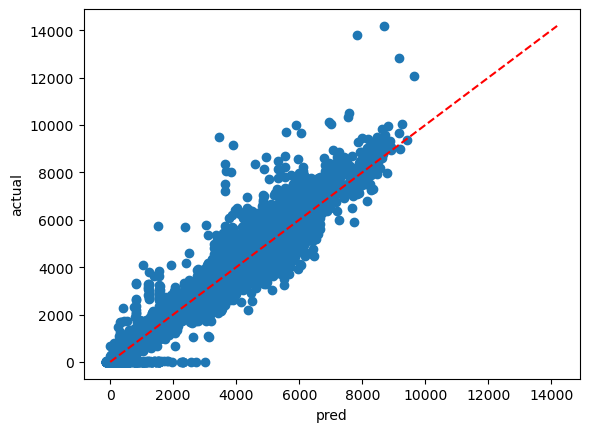

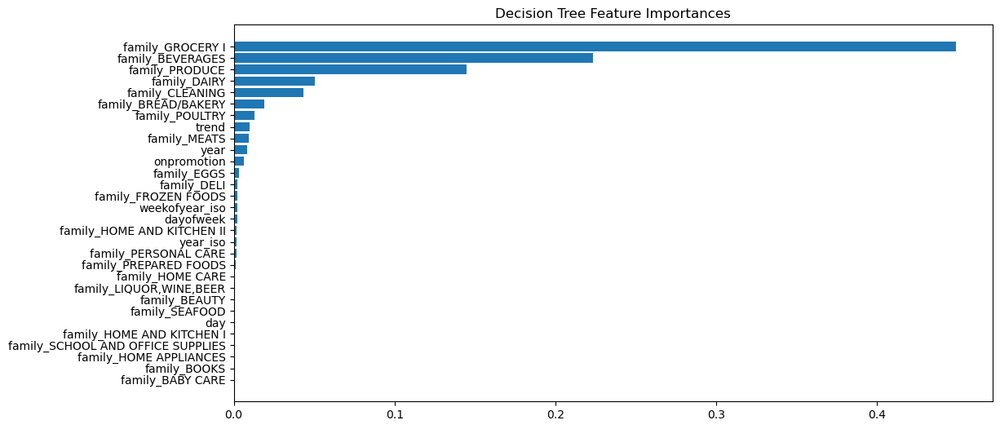


training performance

R² Score: 0.99
RMSE: 35.74
MAE: 4.00

test performance

R² Score: 0.96
RMSE: 318.82
MAE: 121.00


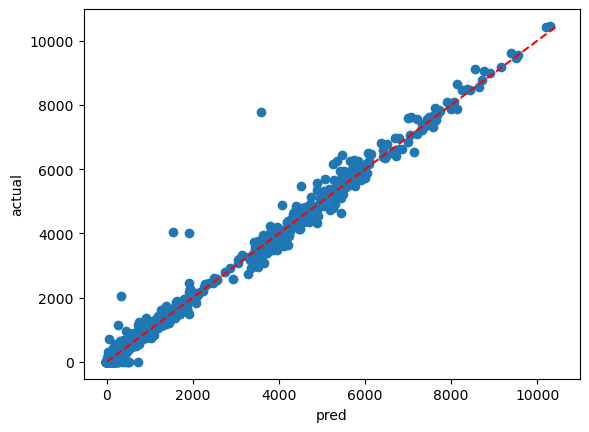

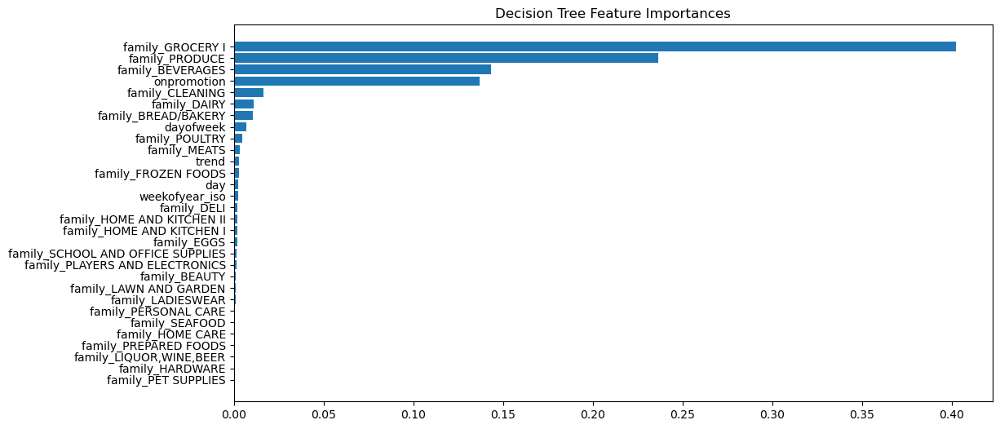


training performance

R² Score: 0.97
RMSE: 103.83
MAE: 36.40

test performance

R² Score: 0.97
RMSE: 120.51
MAE: 56.47


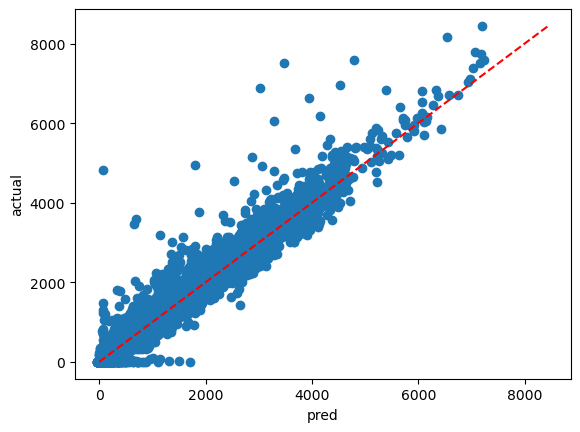

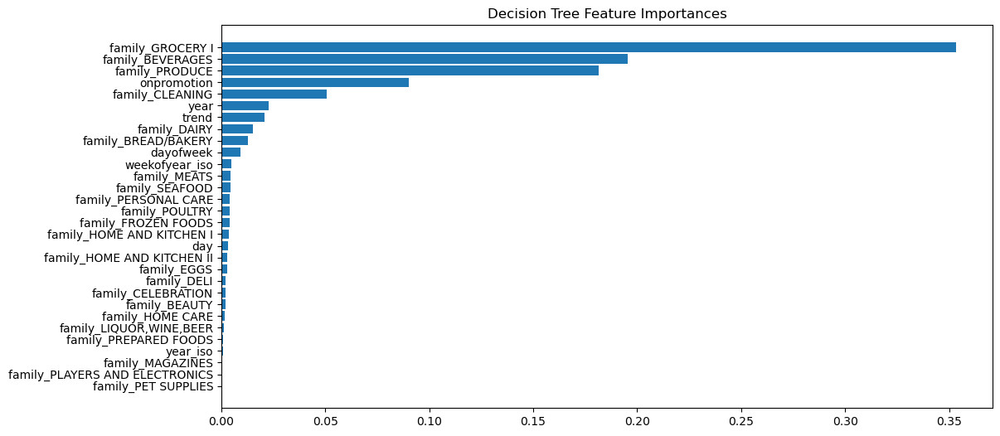


training performance

R² Score: 0.98
RMSE: 91.15
MAE: 30.07

test performance

R² Score: 0.86
RMSE: 365.62
MAE: 85.02


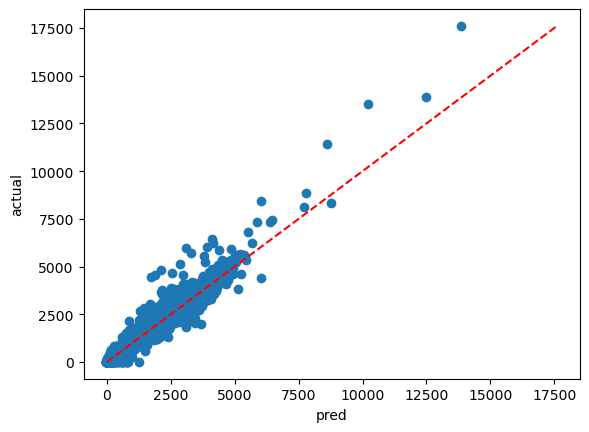

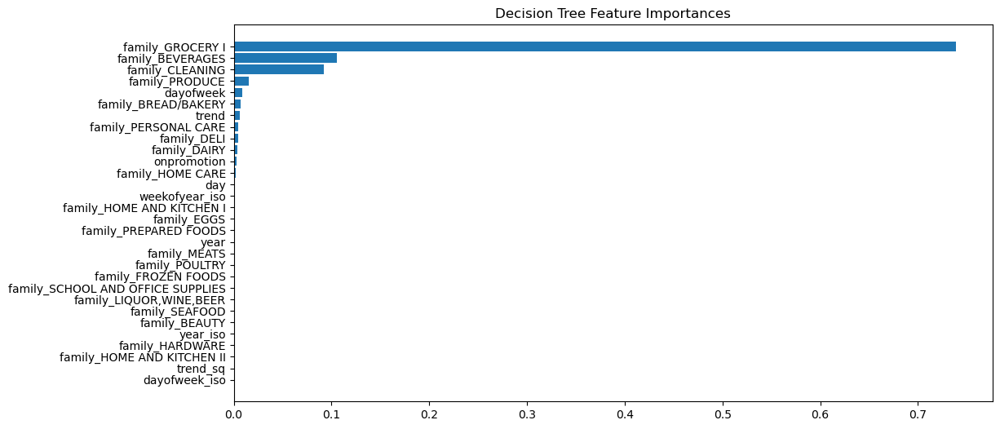


training performance

R² Score: 0.98
RMSE: 145.85
MAE: 58.19

test performance

R² Score: 0.97
RMSE: 189.34
MAE: 78.89


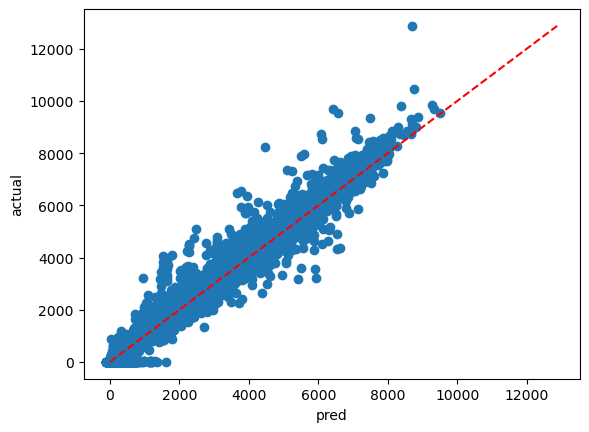

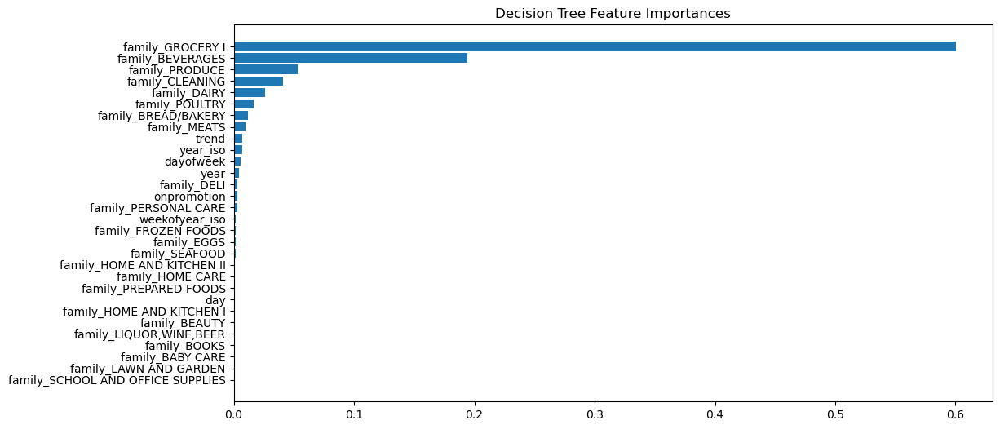


training performance

R² Score: 0.98
RMSE: 155.28
MAE: 59.55

test performance

R² Score: 0.98
RMSE: 166.57
MAE: 75.89


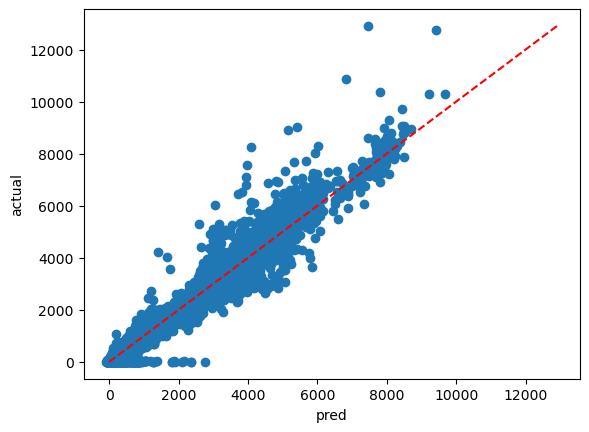

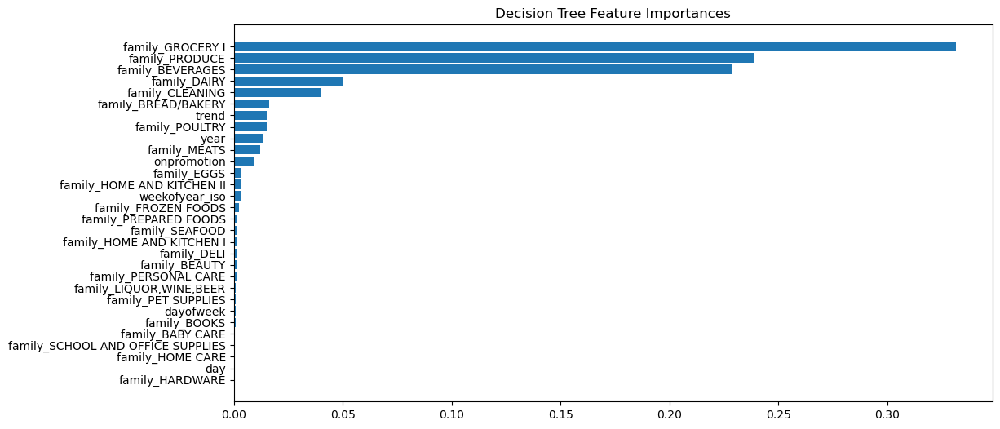


training performance

R² Score: 0.98
RMSE: 179.56
MAE: 68.11

test performance

R² Score: 0.97
RMSE: 222.01
MAE: 86.05


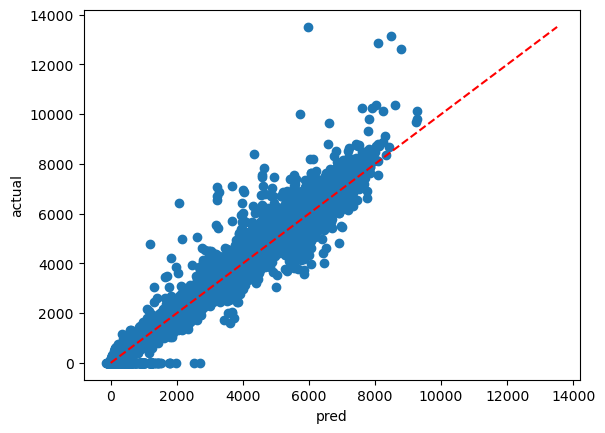

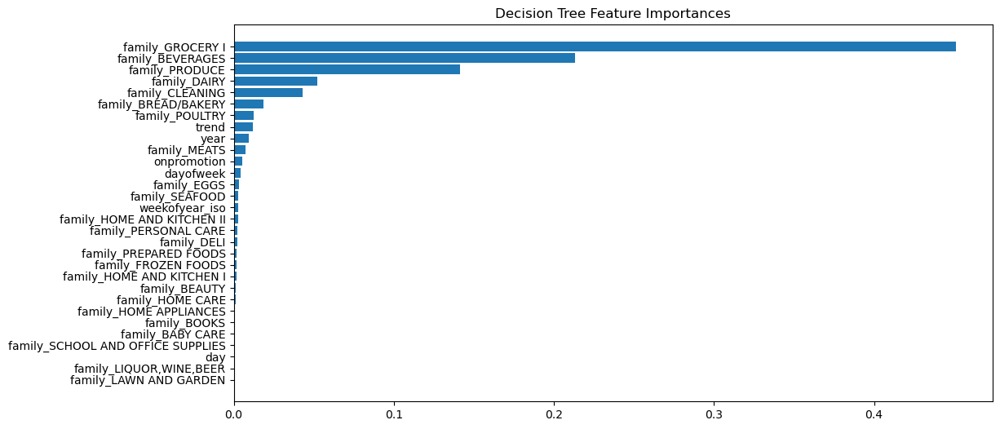


training performance

R² Score: 0.98
RMSE: 177.48
MAE: 62.27

test performance

R² Score: 0.98
RMSE: 216.19
MAE: 85.52


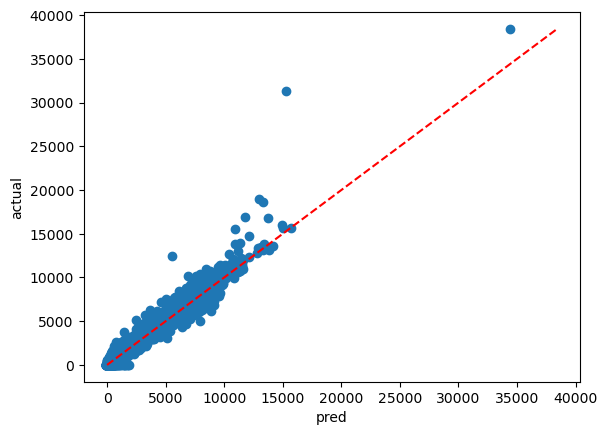

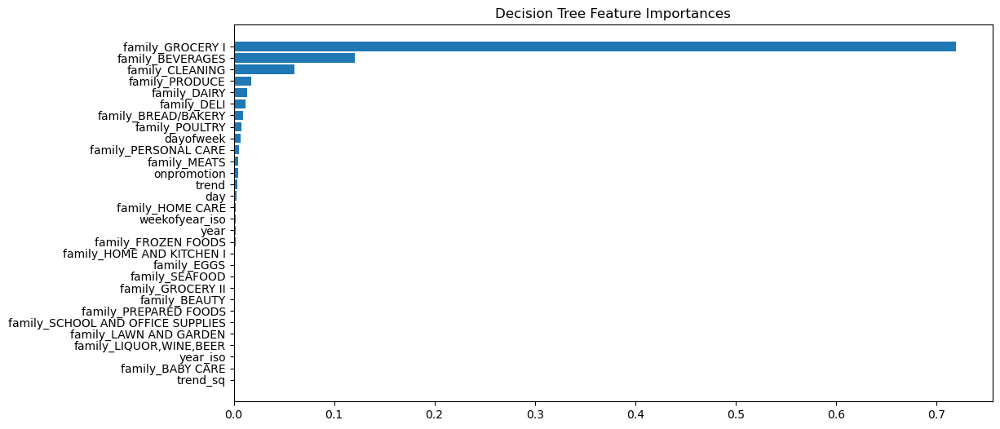


training performance

R² Score: 0.98
RMSE: 169.36
MAE: 51.18

test performance

R² Score: 0.95
RMSE: 265.25
MAE: 84.63


In [ ]:
y_fit_all,y_pred_all, y_test_reals_all=  apply_func_each_store(X_train, X_test,y_train,y_test, X_test_real,func=xgb_predictor)

In [ ]:
(r2_train,rmse_train,mae_train),(r2_test,rmse_test,mae_test) = performance_both(y_train, y_fit_all, y_test, y_pred_all)


training performance

R² Score: 0.98
RMSE: 169.36
MAE: 51.18

test performance

R² Score: 0.95
RMSE: 265.25
MAE: 84.63


In [ ]:
y_test_reals_all.rename(columns={0:'sales'}).to_csv("xgboost_per_family.csv")
# !kaggle competitions submit -c store-sales-time-series-forecasting -f xgboost_per_family.csv -m "xgboost per family"

100%|████████████████████████████████████████| 495k/495k [00:00<00:00, 1.22MB/s]
Successfully submitted to Store Sales - Time Series Forecasting

# end
